# PREDICTING THE SUITABLE CROP BY USING MACHINE LEARNING ALGORITHMS

## IMPORTING NECESSARY LIBRARIES

In [1]:
import numpy as np 
import pandas as pd
# Set Pandas display options
#pd.set_option('display.max_rows', None) //Makes the entire dataset visible in case of large dataset
#pd.set_option('display.max_columns', None)
# For Visualization
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_score
from sklearn.compose import ColumnTransformer
import scipy.stats as stats

import warnings
def warns(*args,**kwargs): pass
warnings.warn=warns

## READING THE DATASET FROM A COMMA SEPARATED VALUES FILE

In [2]:
df = pd.read_csv('Crop_recommendation.csv')
print('Data Shape: ', df.shape)
df.sample(10)

Data Shape:  (2200, 8)


,N,P,K,temperature,humidity,ph,rainfall,label
176,74,39,23,22.626511,65.774729,6.780736,88.172510,maize
2060,79,45,43,25.719013,79.155324,7.171054,187.173542,jute
1585,35,142,203,21.170892,90.237302,5.895319,123.649515,apple
1736,31,62,52,33.796016,93.007543,6.991041,182.026807,papaya
1404,95,26,45,29.916906,94.556956,6.117530,28.160572,muskmelon
717,50,58,23,27.813269,62.504605,7.596802,69.755555,blackgram
1798,56,59,55,37.035519,91.794302,6.551893,188.518142,papaya
1359,81,6,55,24.889105,85.870591,6.110143,51.706991,watermelon
2023,80,45,42,23.142650,74.997398,7.380396,151.903548,jute
1504,20,129,201,23.410447,91.699133,5.587906,116.077793,apple


## DATA TYPES OF ALL THE COLUMNS

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   N            2200 non-null   int64  
 1   P            2200 non-null   int64  
 2   K            2200 non-null   int64  
 3   temperature  2200 non-null   float64
 4   humidity     2200 non-null   float64
 5   ph           2200 non-null   float64
 6   rainfall     2200 non-null   float64
 7   label        2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB


## CHECKING FOR MISSING (NaN) VALUES IN THE DATASET

In [4]:
df.isnull().sum()

N              0
P              0
K              0
temperature    0
humidity       0
ph             0
rainfall       0
label          0
dtype: int64

## SUMMARY OF STATISTICS

In [5]:
df.describe()

,N,P,K,temperature,humidity,ph,rainfall
count,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000
mean,50.551818,53.362727,48.149091,25.616244,71.481779,6.469480,103.463655
std,36.917334,32.985883,50.647931,5.063749,22.263812,0.773938,54.958389
min,0.000000,5.000000,5.000000,8.825675,14.258040,3.504752,20.211267
25%,21.000000,28.000000,20.000000,22.769375,60.261953,5.971693,64.551686
50%,37.000000,51.000000,32.000000,25.598693,80.473146,6.425045,94.867624
75%,84.250000,68.000000,49.000000,28.561654,89.948771,6.923643,124.267508
max,140.000000,145.000000,205.000000,43.675493,99.981876,9.935091,298.560117


## CHECKING FOR DUPLICATE VALUES

In [6]:
df.duplicated().sum()

0

## UNIQUE CROP LABELS

In [7]:
crops = df['label'].unique()
crops.sort()
num_indices = range(1, len(crops) + 1)  # Create a range of numbers from 1 to the number of unique crops

print("Total Number of Crops:", len(crops))
print("\n", "-"*20, " List of Crops ", "-"*20)

# Iterate through the crops and their numerical indices
for i, crop in zip(num_indices, crops):
    print(f"{i}. {crop}")


Total Number of Crops: 22

 --------------------  List of Crops  --------------------
1. apple
2. banana
3. blackgram
4. chickpea
5. coconut
6. coffee
7. cotton
8. grapes
9. jute
10. kidneybeans
11. lentil
12. maize
13. mango
14. mothbeans
15. mungbean
16. muskmelon
17. orange
18. papaya
19. pigeonpeas
20. pomegranate
21. rice
22. watermelon


## NUMBER OF ROWS AGAINST EACH CROP

In [8]:
print("Number of Records Against Eash Crop")
print("-"*35)
print(df['label'].value_counts() )

Number of Records Against Eash Crop
-----------------------------------
label
rice           100
maize          100
jute           100
cotton         100
coconut        100
papaya         100
orange         100
apple          100
muskmelon      100
watermelon     100
grapes         100
mango          100
banana         100
pomegranate    100
lentil         100
blackgram      100
mungbean       100
mothbeans      100
pigeonpeas     100
kidneybeans    100
chickpea       100
coffee         100
Name: count, dtype: int64


## COLUMN NAMES

In [9]:
print(df.columns)

Index(['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label'], dtype='object')


## FEATURES SELECTION

In [10]:
selected_features = ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']
selected_features

['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']

## CORRELATION MATRICES

In [11]:
numeric_columns = df.select_dtypes(include=[np.number])
# Rank the data
ranked_data = numeric_columns.rank()
# Calculate Spearman's correlation
corr_spearman = ranked_data.corr(method='spearman')
# Calculate Pearson correlation
corr_pearson = numeric_columns.corr(method='pearson')
# Calculate Kendall's Tau correlation
corr_kendall = ranked_data.corr(method='kendall')

### NUMERIC COLUMNS

In [12]:
numeric_columns

,N,P,K,temperature,humidity,ph,rainfall
0,90,42,43,20.879744,82.002744,6.502985,202.935536
1,85,58,41,21.770462,80.319644,7.038096,226.655537
2,60,55,44,23.004459,82.320763,7.840207,263.964248
3,74,35,40,26.491096,80.158363,6.980401,242.864034
4,78,42,42,20.130175,81.604873,7.628473,262.717340
...,...,...,...,...,...,...,...
2195,107,34,32,26.774637,66.413269,6.780064,177.774507
2196,99,15,27,27.417112,56.636362,6.086922,127.924610
2197,118,33,30,24.131797,67.225123,6.362608,173.322839
2198,117,32,34,26.272418,52.127394,6.758793,127.175293


### RANKED DATA

In [13]:
ranked_data

,N,P,K,temperature,humidity,ph,rainfall
0,1739.0,879.5,1434.0,362.0,1235.0,1212.0,2075.0
1,1658.0,1337.5,1377.0,438.0,1086.0,1754.0,2129.0
2,1383.0,1203.5,1463.0,584.0,1263.0,2118.0,2175.0
3,1511.5,667.0,1349.5,1280.0,1068.0,1711.0,2154.0
4,1552.5,879.5,1404.5,308.0,1202.0,2056.0,2172.0
...,...,...,...,...,...,...,...
2195,1985.0,646.0,1104.0,1329.0,764.0,1524.0,1921.0
2196,1875.0,205.0,967.5,1443.0,484.0,667.0,1667.0
2197,2126.0,638.0,1041.5,790.0,794.0,1013.0,1896.0
2198,2109.0,631.0,1157.5,1238.0,388.0,1494.0,1664.0


### PEARSON CORRELATION MATRIX

In [14]:
corr_pearson

,N,P,K,temperature,humidity,ph,rainfall
N,1.000000,-0.231460,-0.140512,0.026504,0.190688,0.096683,0.059020
P,-0.231460,1.000000,0.736232,-0.127541,-0.118734,-0.138019,-0.063839
K,-0.140512,0.736232,1.000000,-0.160387,0.190859,-0.169503,-0.053461
temperature,0.026504,-0.127541,-0.160387,1.000000,0.205320,-0.017795,-0.030084
humidity,0.190688,-0.118734,0.190859,0.205320,1.000000,-0.008483,0.094423
ph,0.096683,-0.138019,-0.169503,-0.017795,-0.008483,1.000000,-0.109069
rainfall,0.059020,-0.063839,-0.053461,-0.030084,0.094423,-0.109069,1.000000


### SPEARMAN'S CORRELATION MATRIX

In [15]:
corr_spearman

,N,P,K,temperature,humidity,ph,rainfall
N,1.000000,-0.162625,0.208248,0.022390,0.061113,0.141879,0.011411
P,-0.162625,1.000000,0.195161,-0.137618,-0.309246,-0.119063,-0.032457
K,0.208248,0.195161,1.000000,-0.081082,0.279493,-0.155351,0.069903
temperature,0.022390,-0.137618,-0.081082,1.000000,0.124172,0.027754,-0.152028
humidity,0.061113,-0.309246,0.279493,0.124172,1.000000,-0.007281,0.100731
ph,0.141879,-0.119063,-0.155351,0.027754,-0.007281,1.000000,-0.151280
rainfall,0.011411,-0.032457,0.069903,-0.152028,0.100731,-0.151280,1.000000


### KENDALL'S TAU CORRELATION MATRIX

In [16]:
corr_kendall

,N,P,K,temperature,humidity,ph,rainfall
N,1.000000,-0.126438,0.134273,0.018003,0.043503,0.089981,0.010675
P,-0.126438,1.000000,0.112858,-0.093892,-0.209444,-0.069890,-0.018331
K,0.134273,0.112858,1.000000,-0.055338,0.190514,-0.106470,0.054646
temperature,0.018003,-0.093892,-0.055338,1.000000,0.078116,0.020666,-0.089448
humidity,0.043503,-0.209444,0.190514,0.078116,1.000000,-0.013975,0.062094
ph,0.089981,-0.069890,-0.106470,0.020666,-0.013975,1.000000,-0.096859
rainfall,0.010675,-0.018331,0.054646,-0.089448,0.062094,-0.096859,1.000000


## HEATMAPS

### FOR PEARSON CORRELATION MATRIX

<Axes: title={'center': 'Features Correlation using Pearson Correlation Matrix'}>

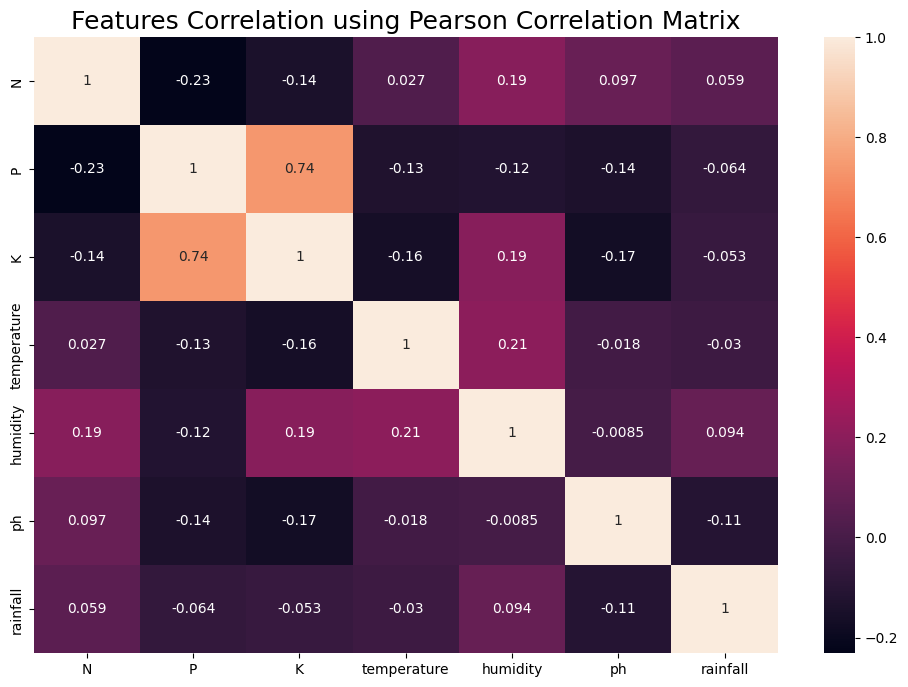

In [17]:
plt.figure(figsize=(12,8))
plt.title("Features Correlation using Pearson Correlation Matrix", fontsize=18)
sns.heatmap(corr_pearson, annot=True)

### FOR SPEARMAN'S CORRELATION MATRIX

<Axes: title={'center': "Features Correlation using Spearman's Correlation Matrix"}>

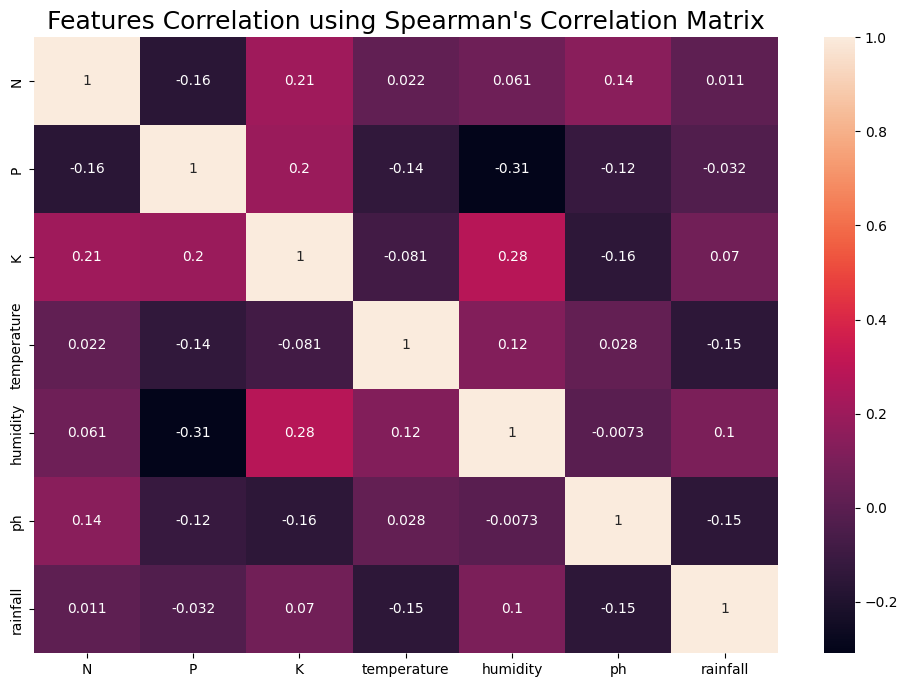

In [18]:
plt.figure(figsize=(12,8))
plt.title("Features Correlation using Spearman's Correlation Matrix", fontsize=18)
sns.heatmap(corr_spearman, annot=True)

### FOR KENDALL'S TAU CORRELATION MATRIX

<Axes: title={'center': "Features Correlation using Kendall's Tau Correlation Matrix"}>

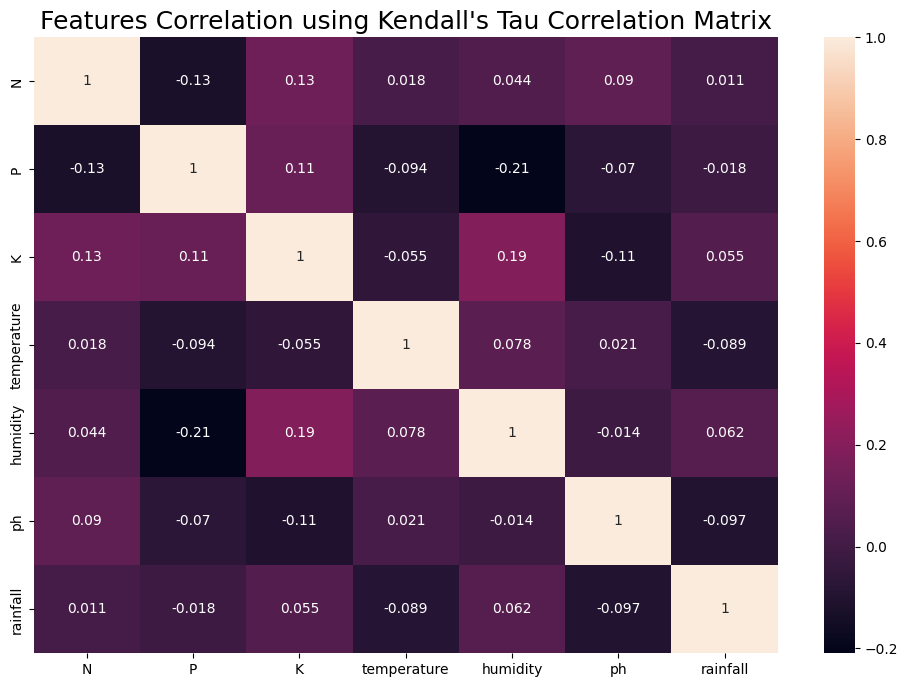

In [19]:
plt.figure(figsize=(12,8))
plt.title("Features Correlation using Kendall's Tau Correlation Matrix", fontsize=18)
sns.heatmap(corr_kendall, annot=True)

## HISTOGRAM FOR UNIVARIATE ANALYSIS

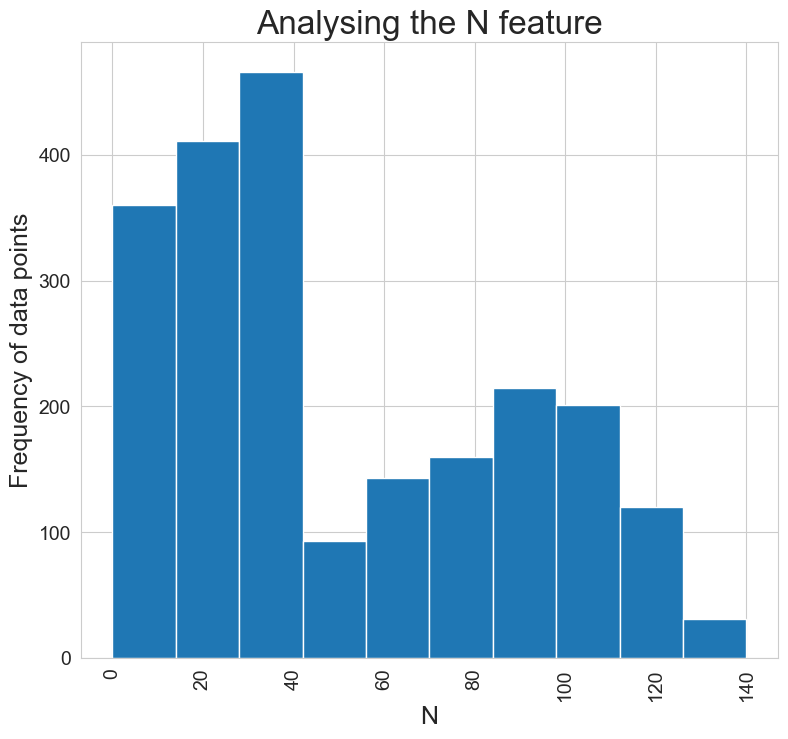

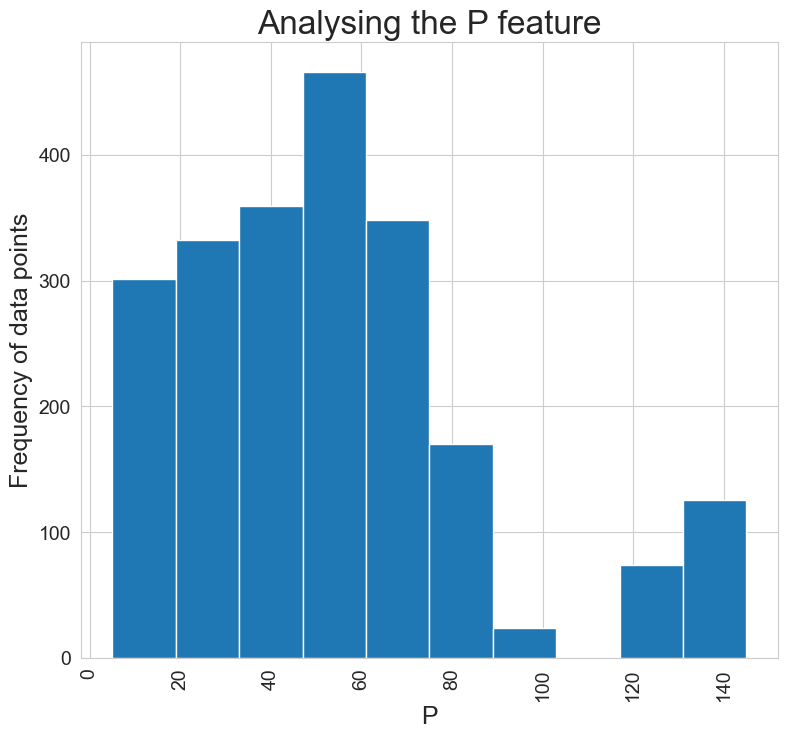

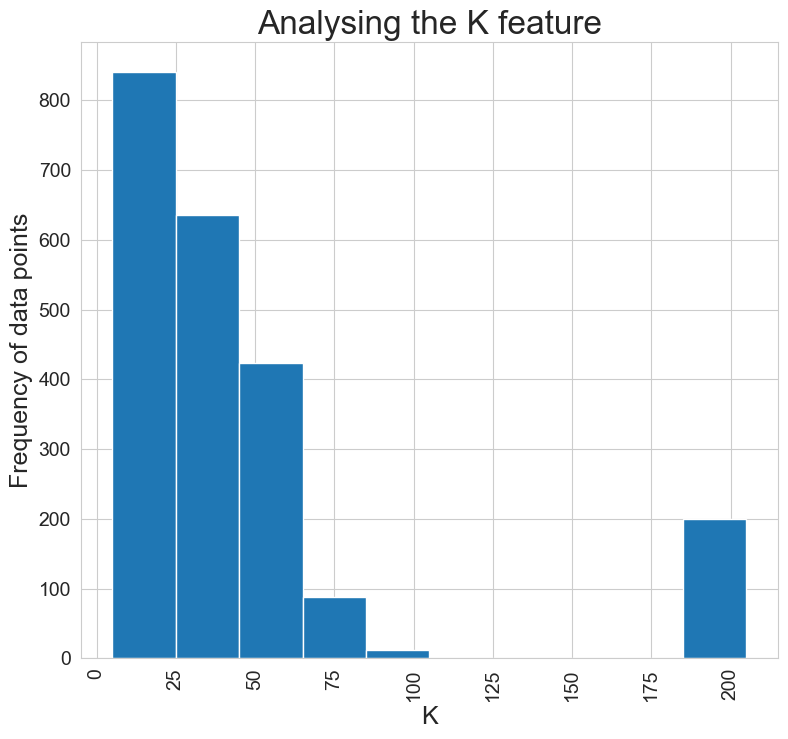

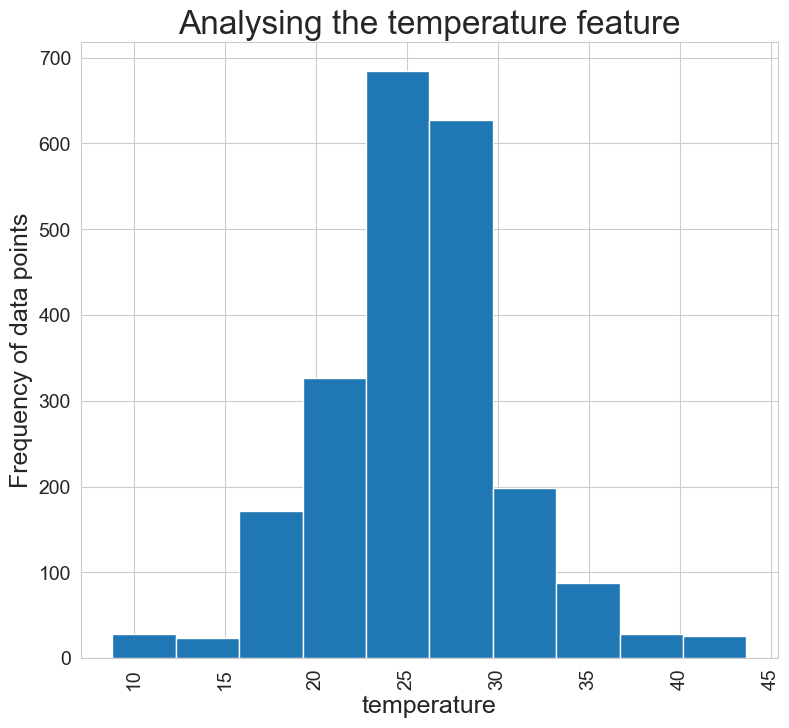

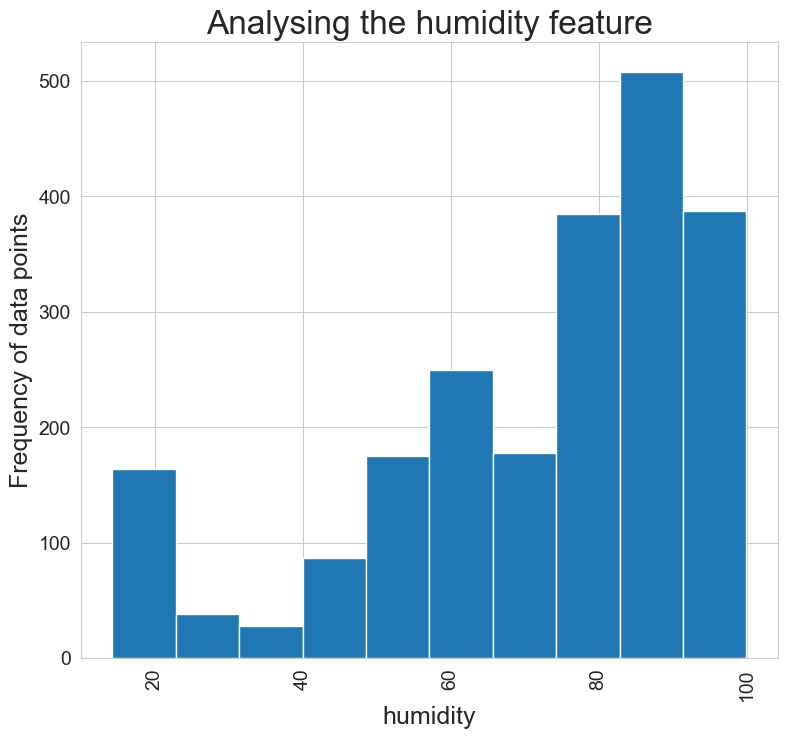

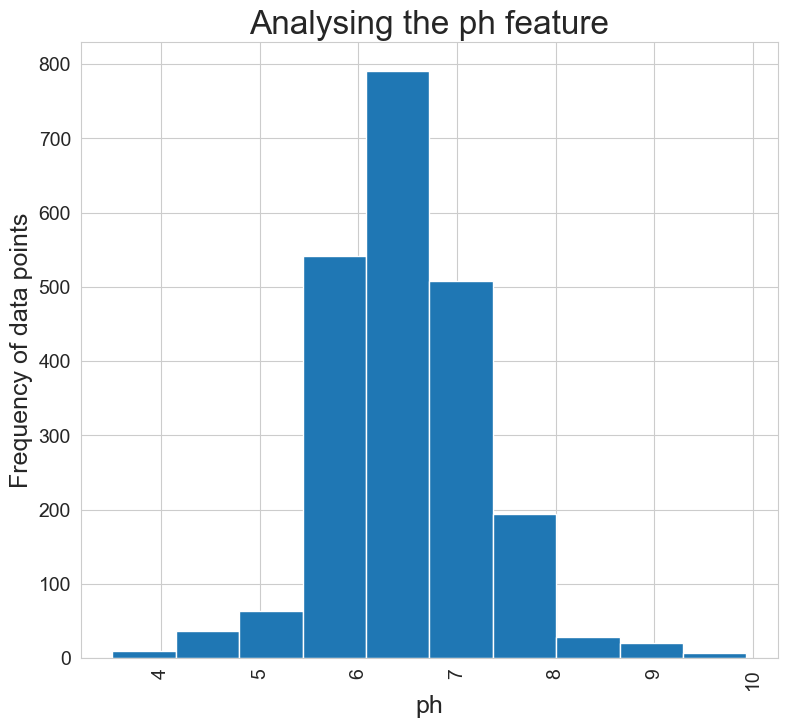

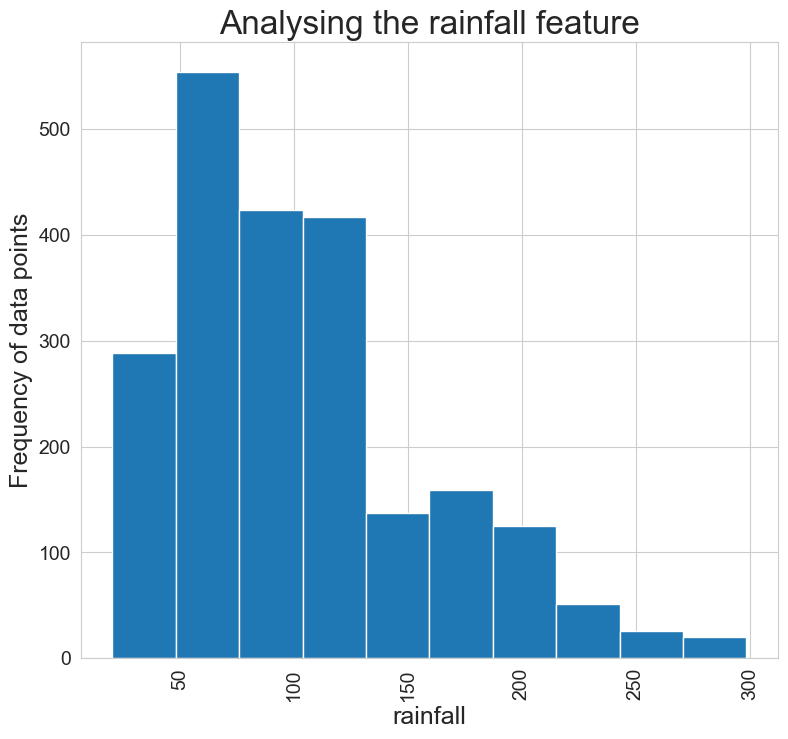

In [20]:
for x in selected_features:
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(9,8))
    plt.hist(df[x])
    plt.xticks(rotation=90, fontsize=14)
    plt.yticks(rotation=0, fontsize=14)
    plt.title("Analysing the " + str(x) + " feature" ,fontsize = 24)
    plt.xlabel(str(x), fontsize = 18)
    plt.ylabel("Frequency of data points", fontsize = 18)

## DISTPLOT AND PROBABILITY PLOT FOR UNIVARIATE ANALYSIS

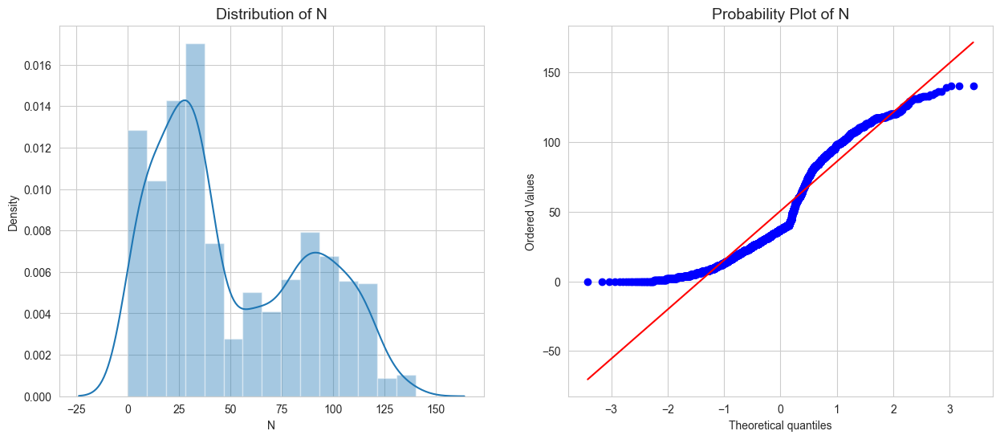

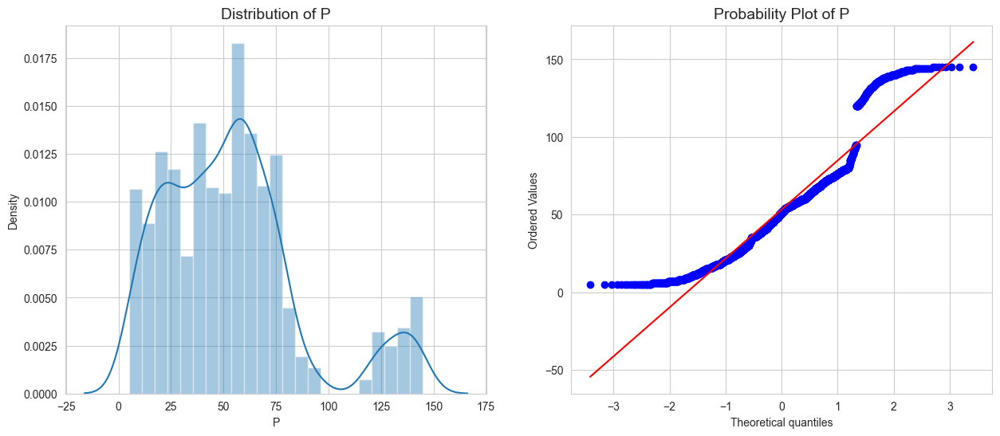

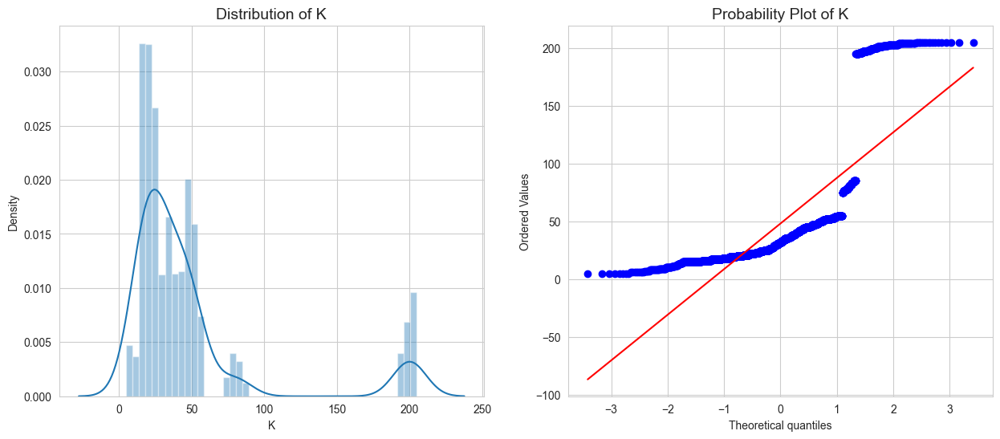

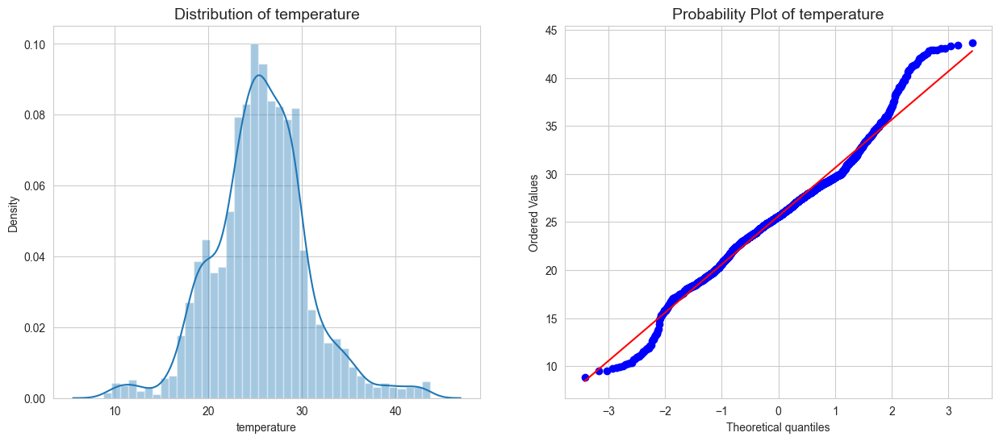

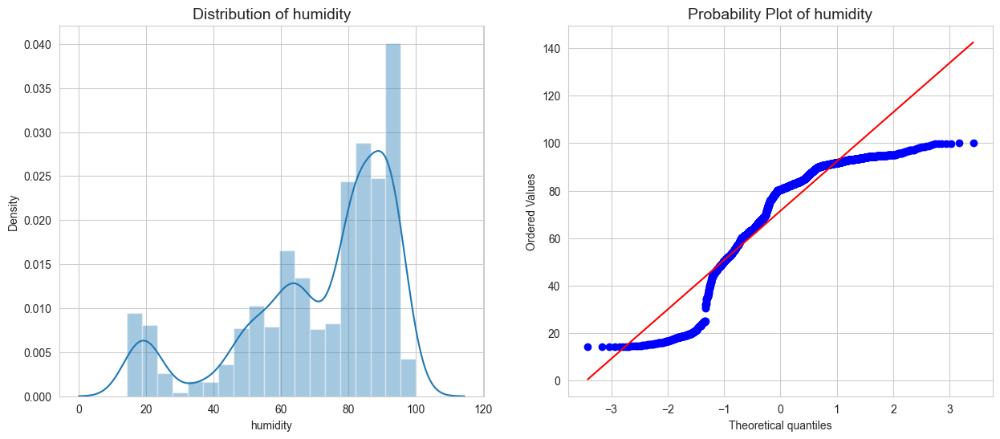

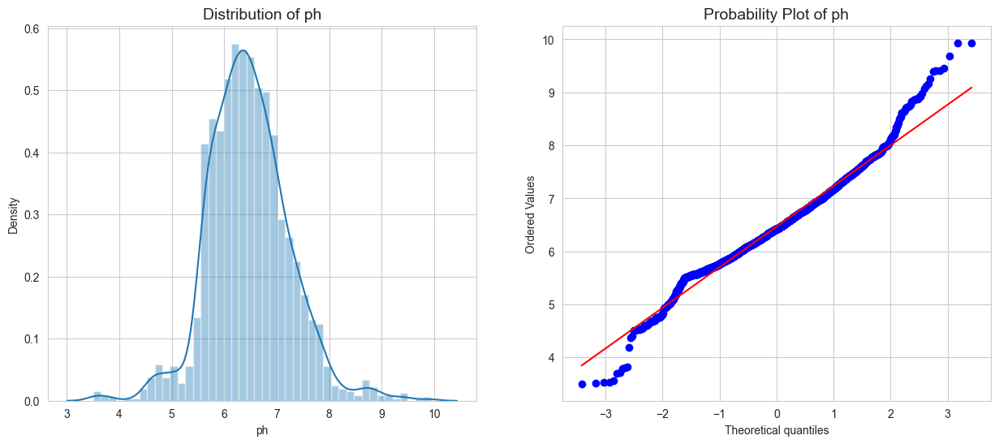

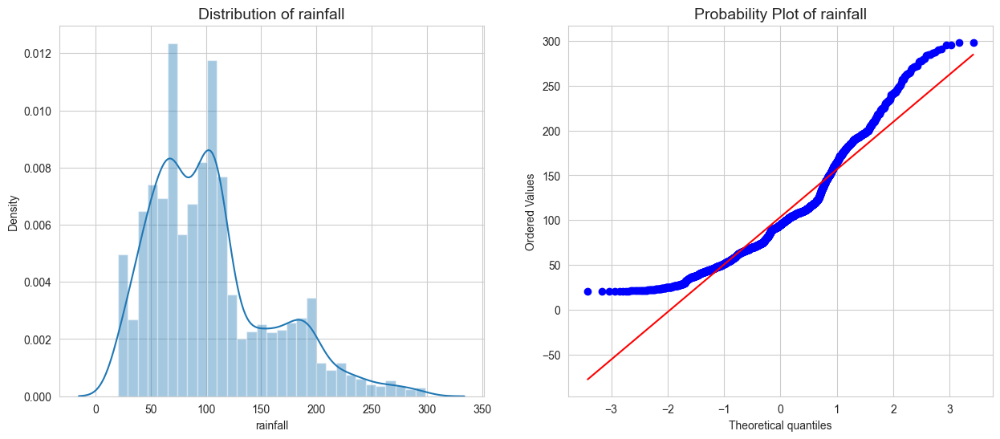

In [21]:
for x in selected_features:
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Plot the distribution (distplot) on the first subplot
    sns.set_style('whitegrid')
    sns.distplot(df[x], ax=axes[0])
    axes[0].set_title("Distribution of " + x, fontsize=14)
    
    # Plot the Probability plot on the second subplot
    stats.probplot(df[x], dist="norm", plot=axes[1])
    axes[1].set_title("Probability Plot of " + x, fontsize=14)
    
    plt.show()


## BARGRAPH FOR BIVARIATE ANALYSIS

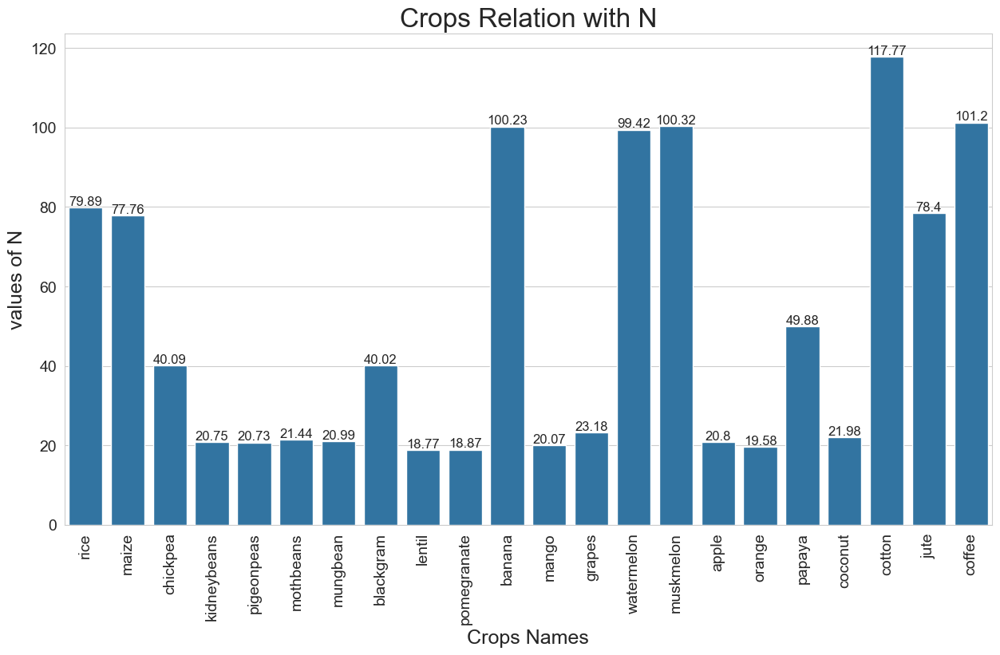

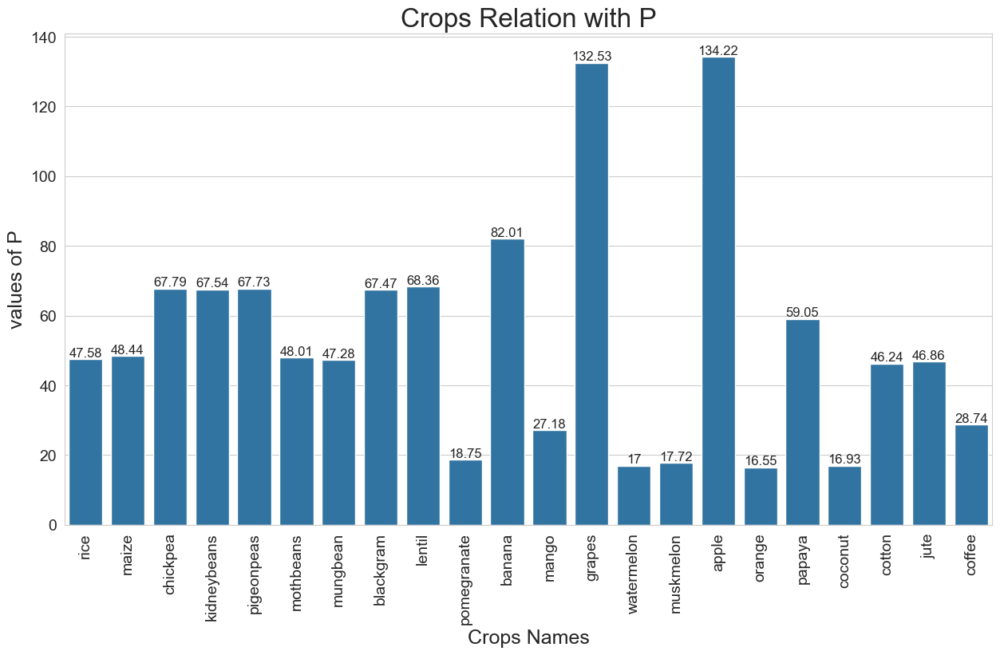

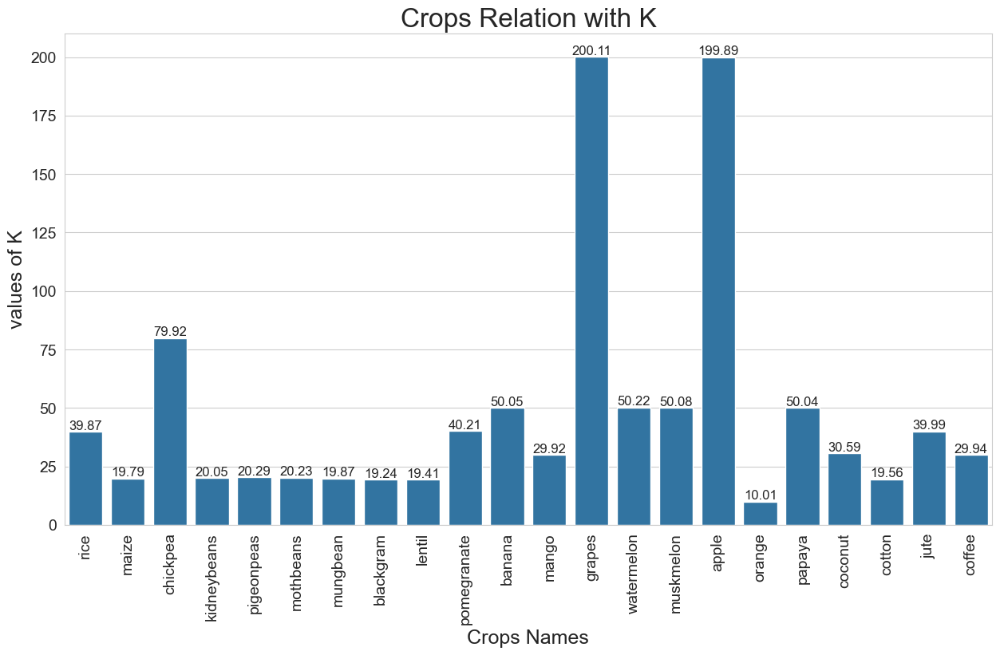

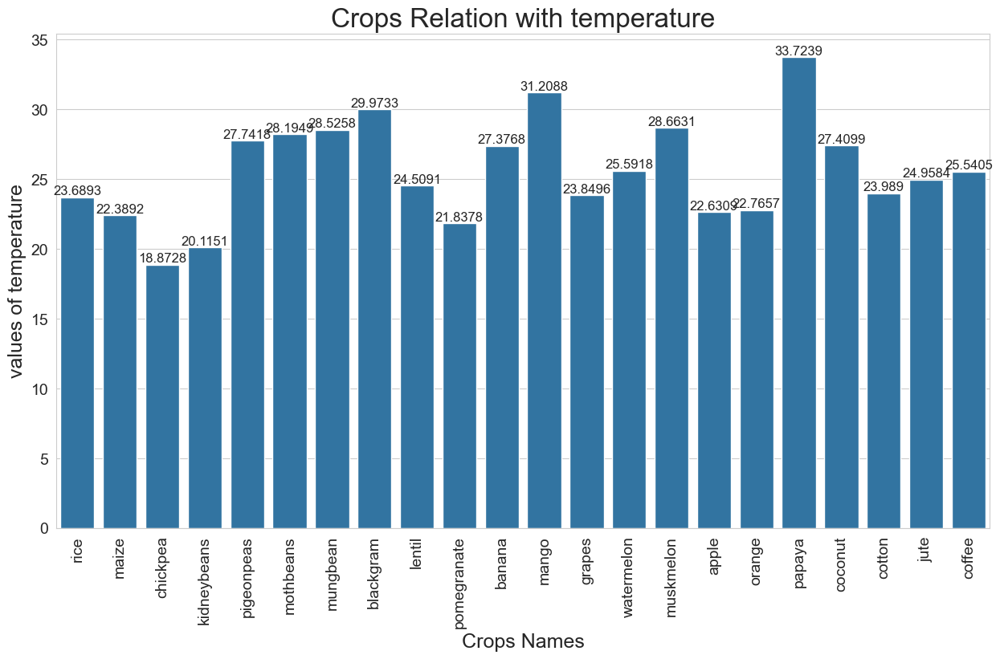

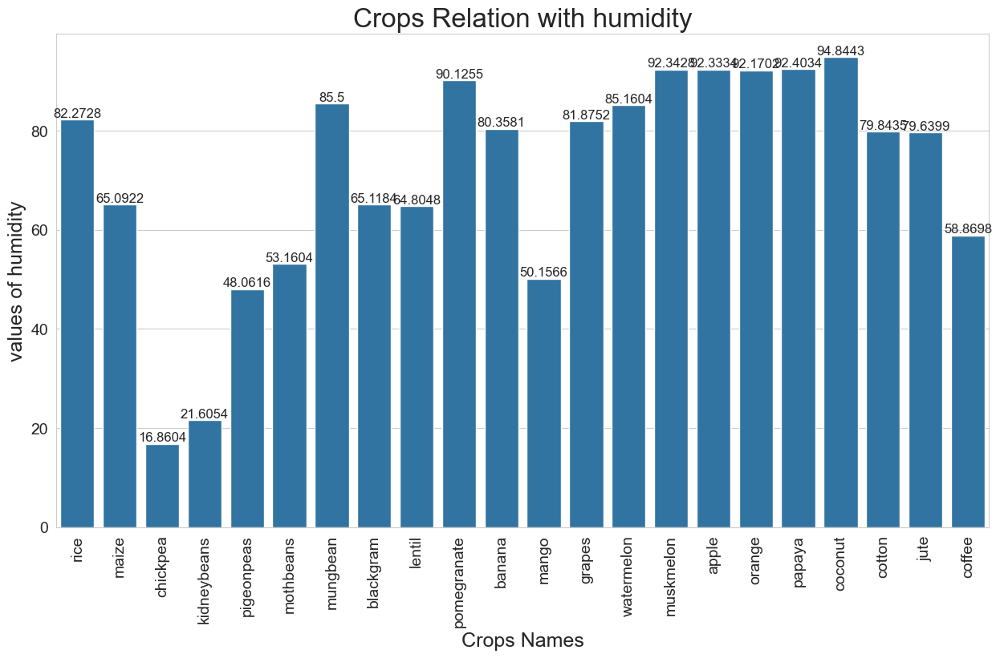

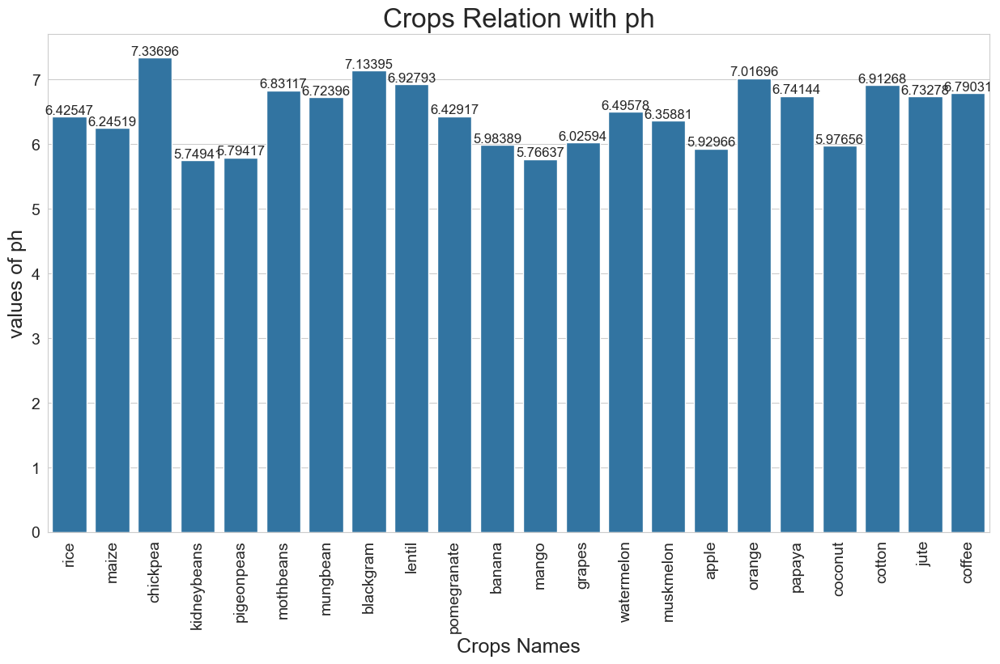

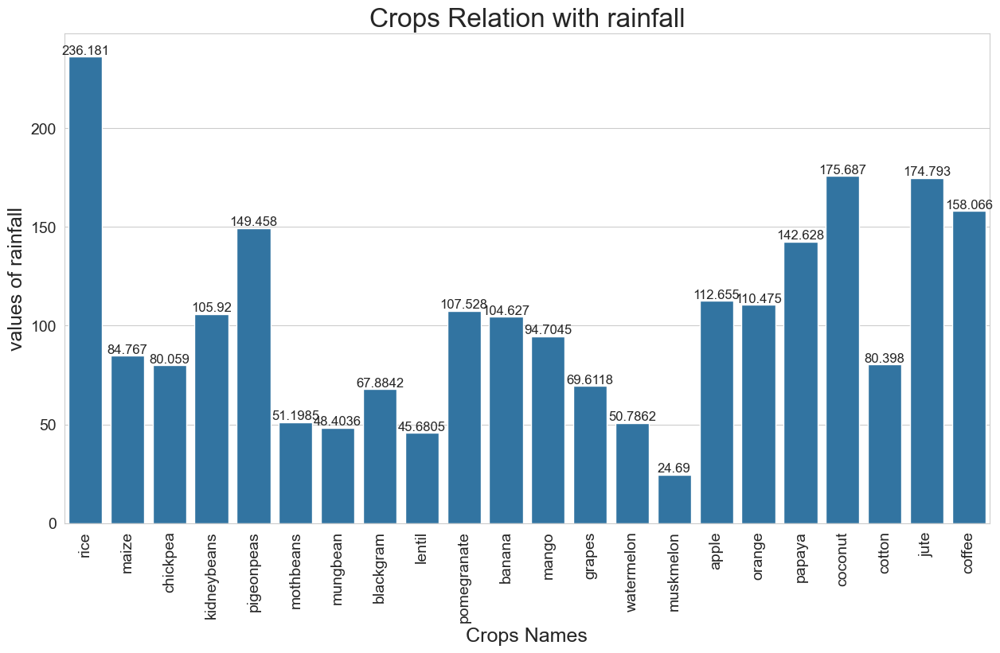

In [23]:
for yfeature in selected_features:
    ax = sns.set_style('whitegrid')
    plt.subplots(figsize=(15,8))

    ax = sns.barplot(x="label", y=yfeature, data=df, ci=None)
    ax.bar_label(ax.containers[0], fontsize=12)

    plt.xticks(rotation=90, fontsize=14)
    plt.yticks(rotation=0, fontsize=14)
    plt.title("Crops Relation with " + str(yfeature), fontsize = 24)
    plt.xlabel("Crops Names", fontsize = 18)
    plt.ylabel("values of " + str(yfeature), fontsize = 18)

## BOXPLOT FOR STATISTIC VISUALISATION OF EACH FEATURE AND OUTLIER DETECTION

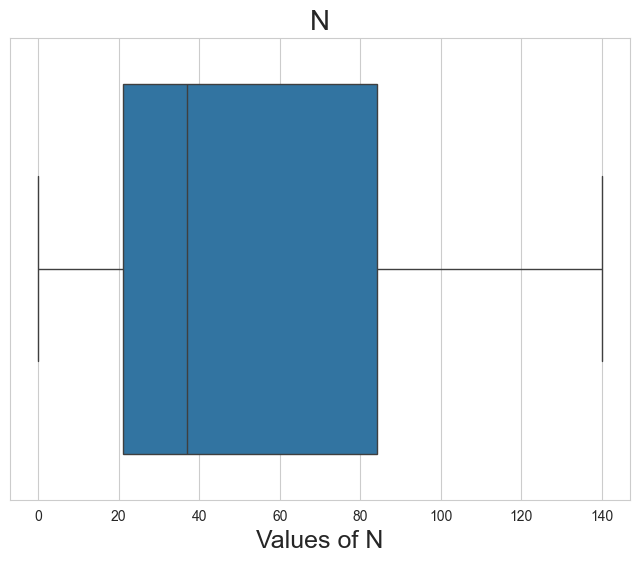

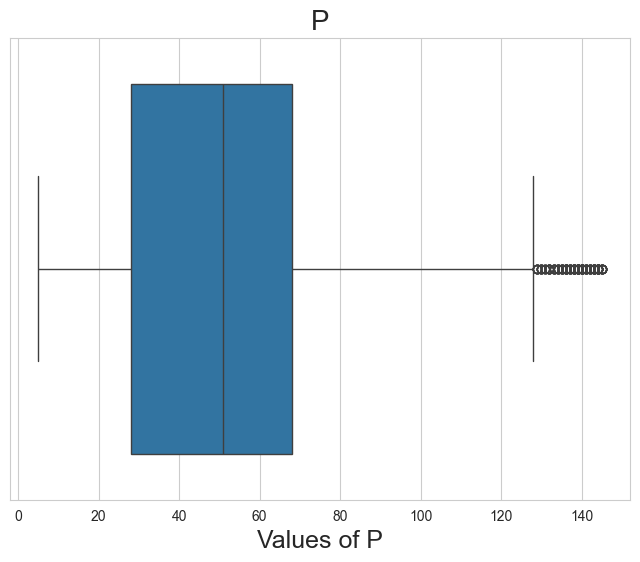

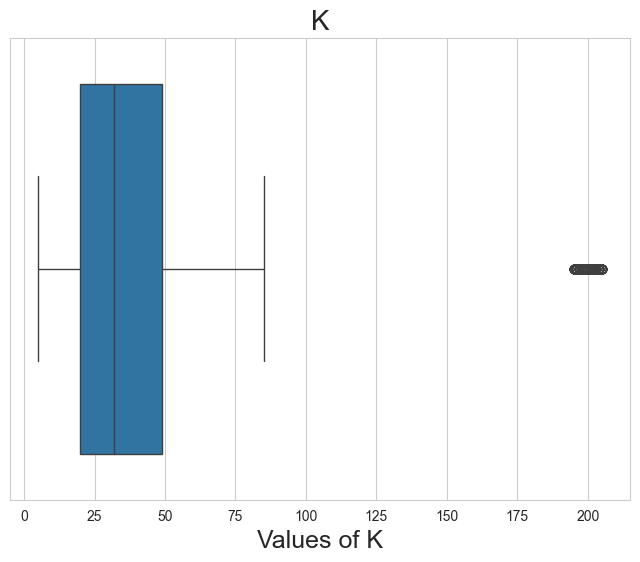

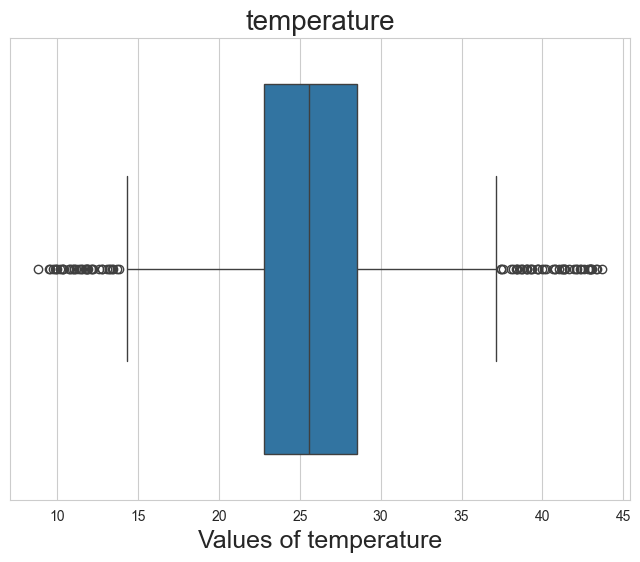

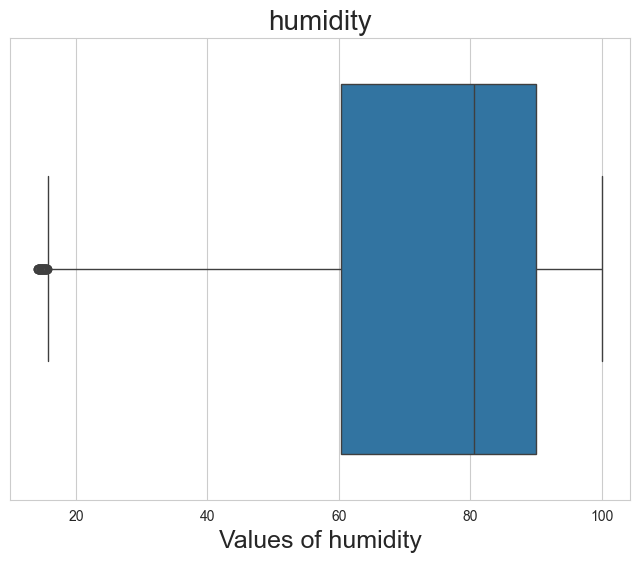

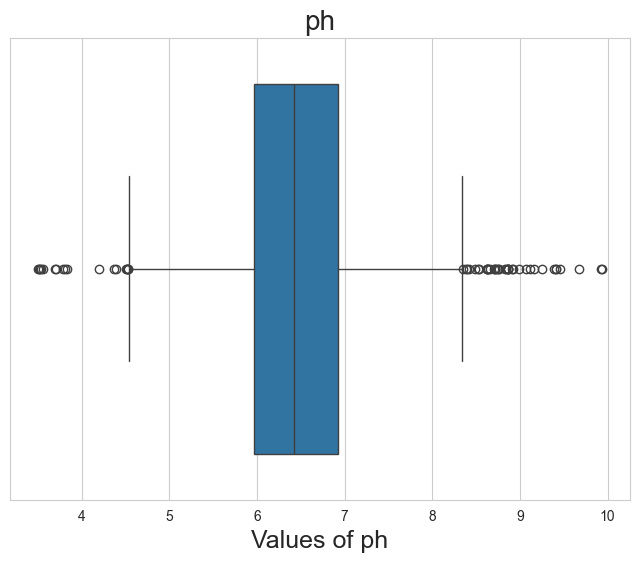

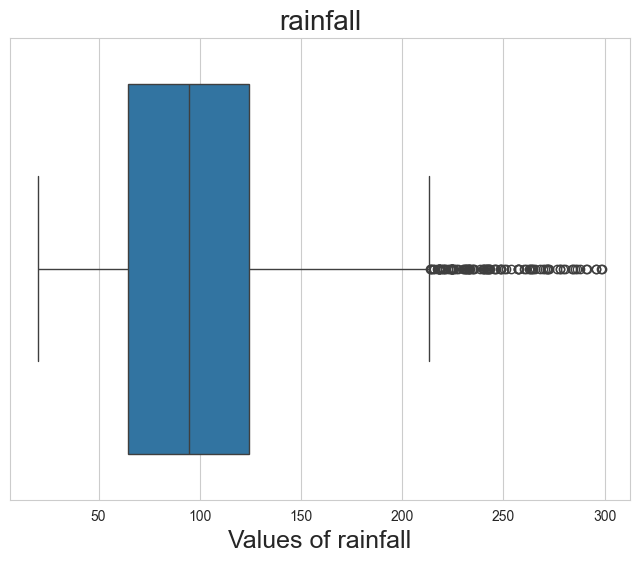

In [24]:
for x in selected_features:
    plt.figure(figsize=(8, 6))
    
    sns.set_style('whitegrid')
    sns.boxplot(x=df[x])
    
    plt.title(x, fontsize=20)
    plt.xlabel("Values of " + x, fontsize=18)
    
    plt.show()

## MULTIVARIATE ANALYSIS USING SCATTERPLOTS

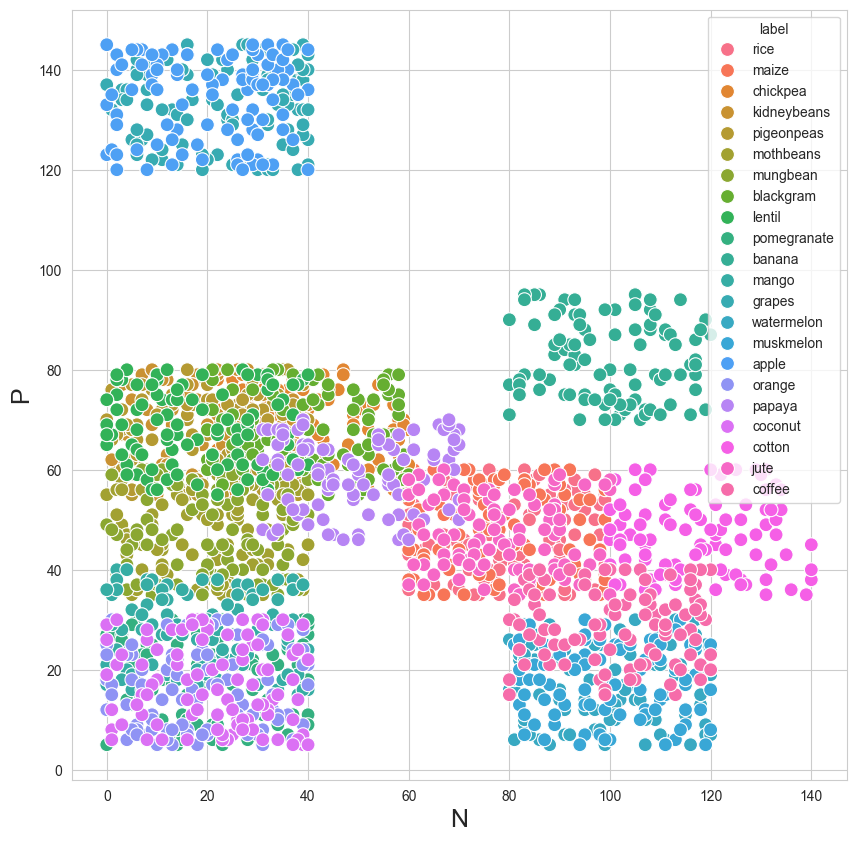

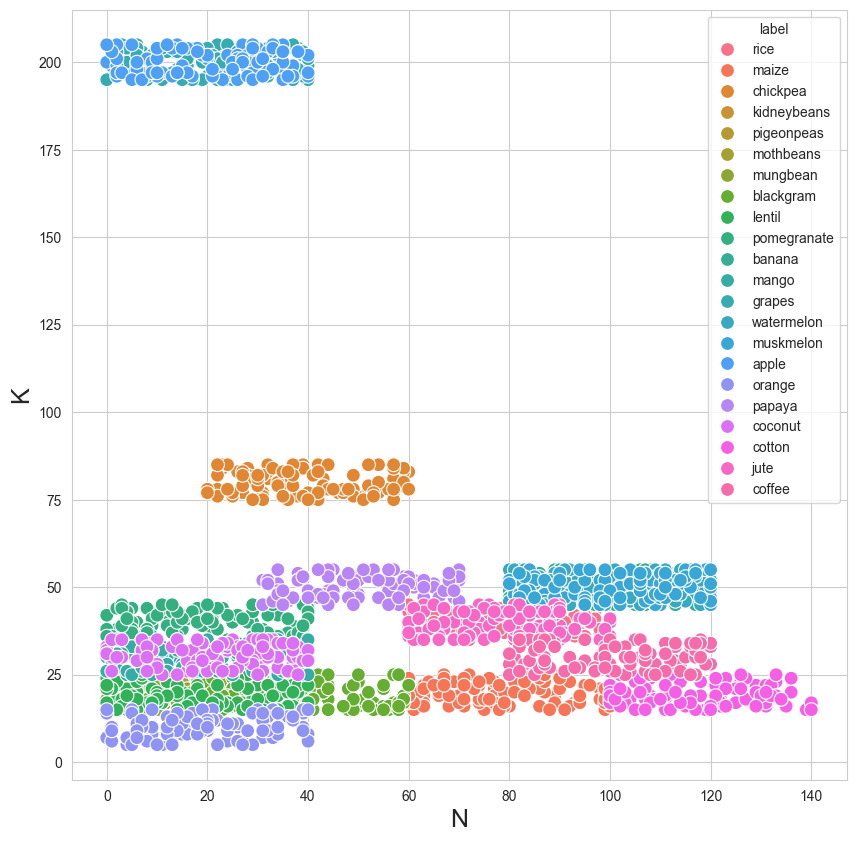

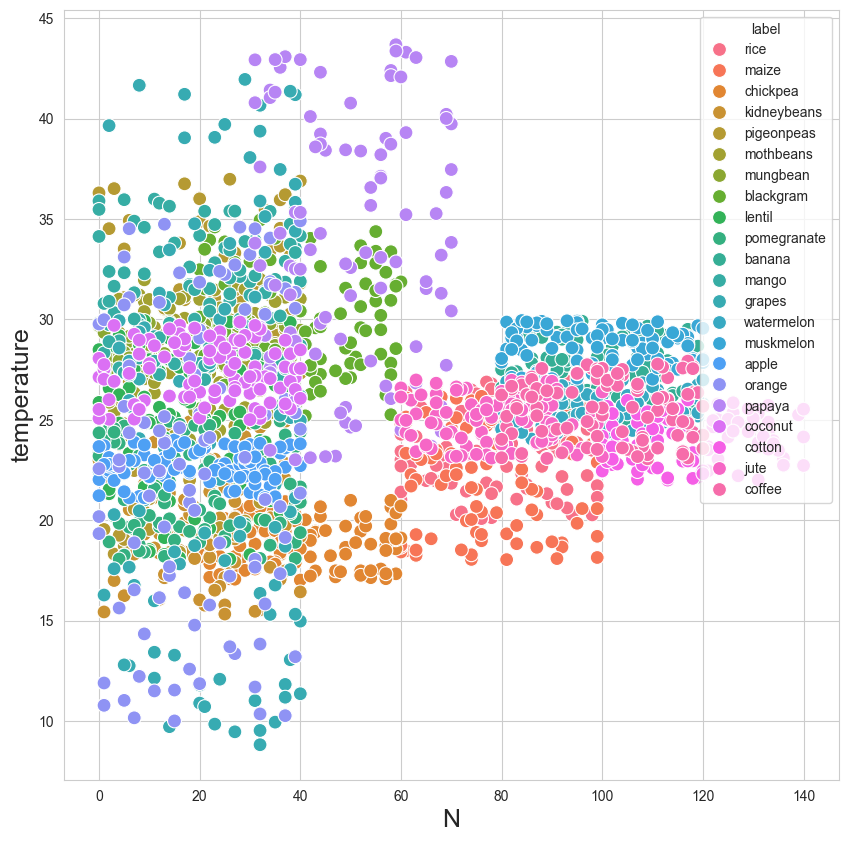

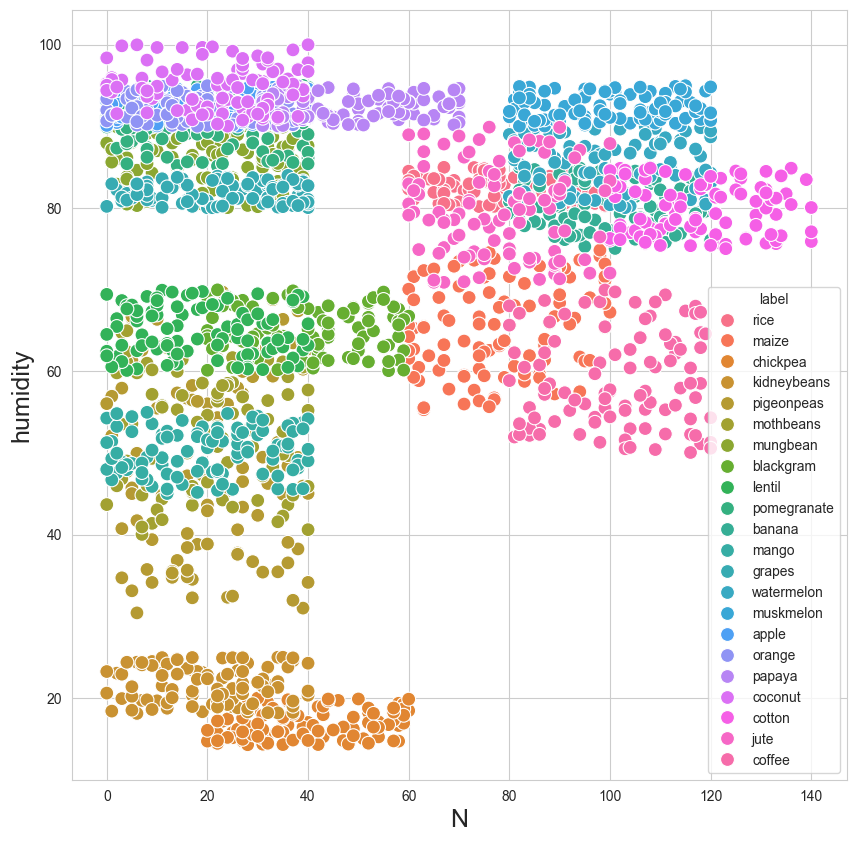

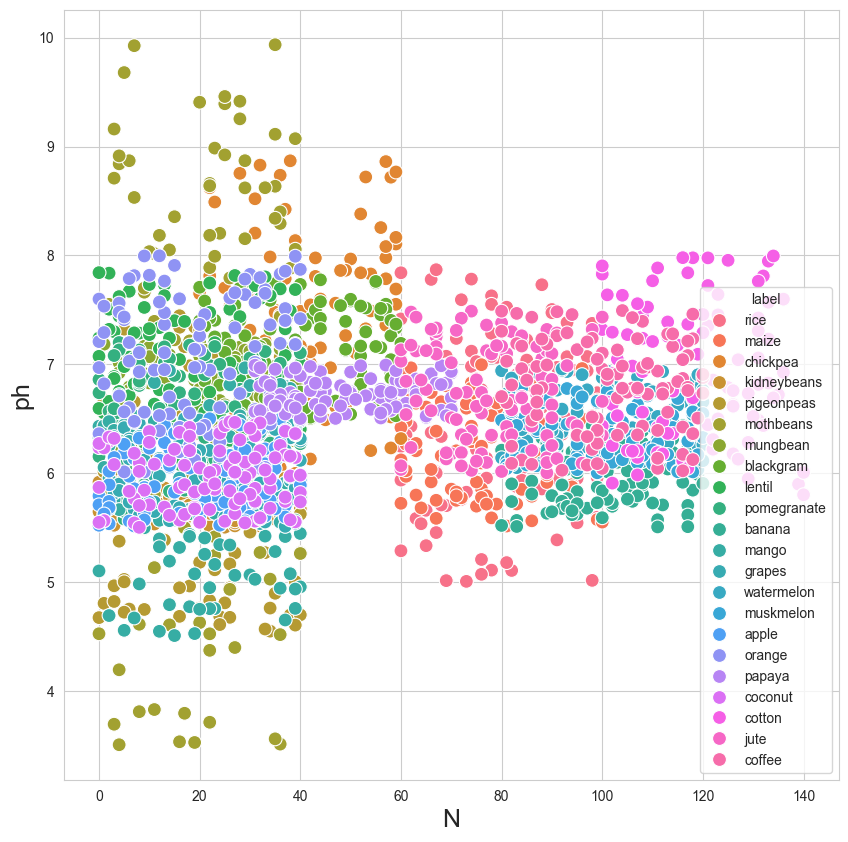

...

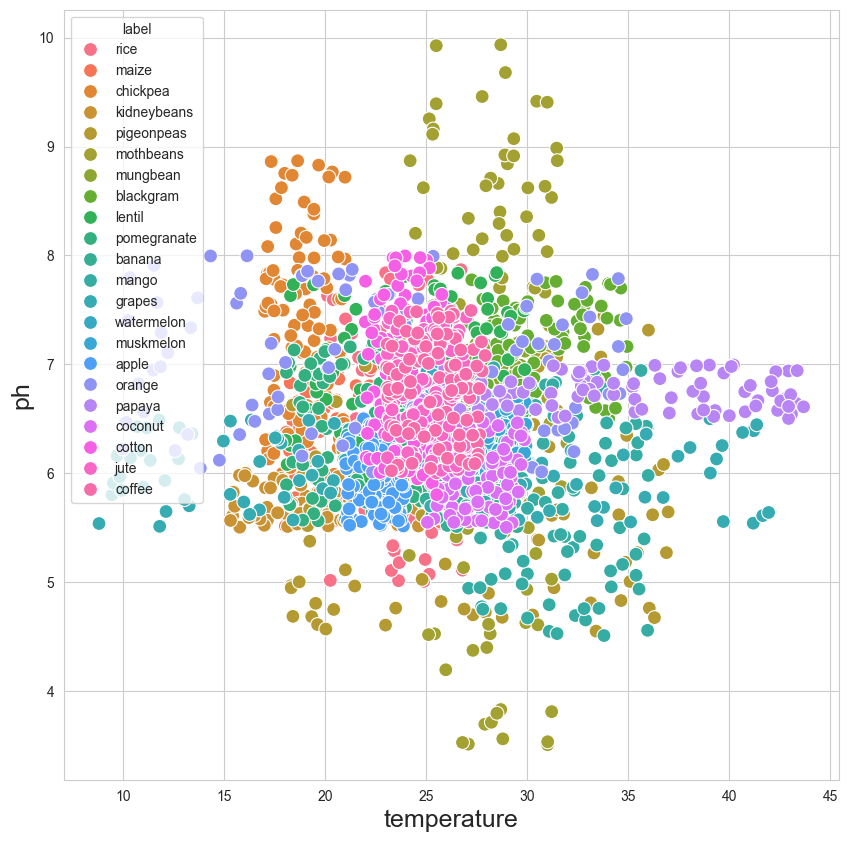

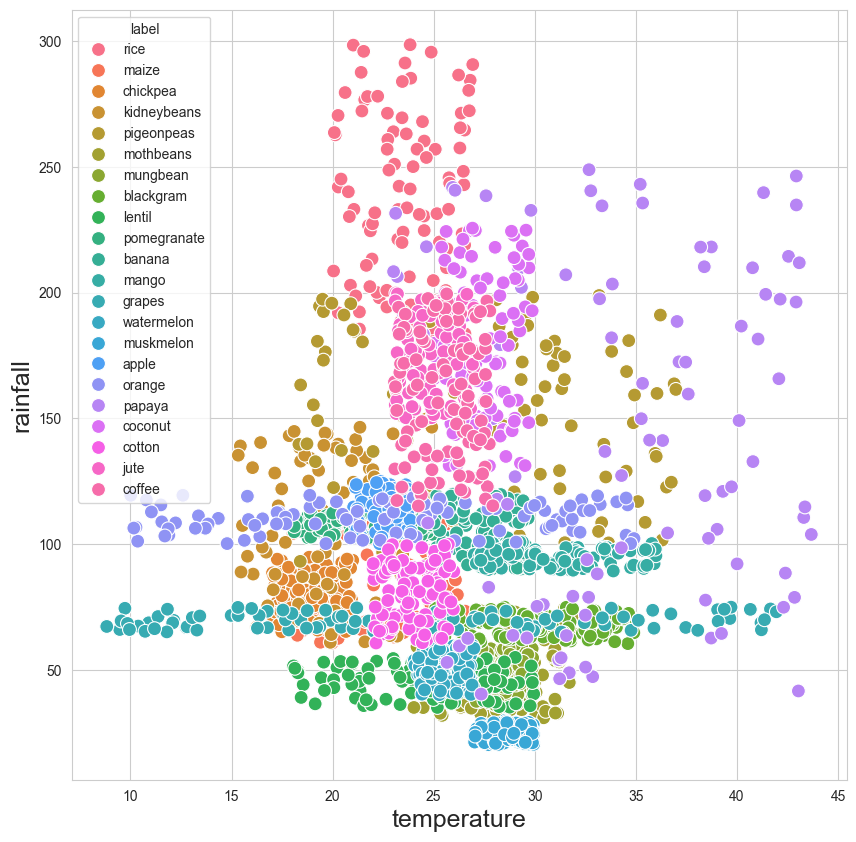

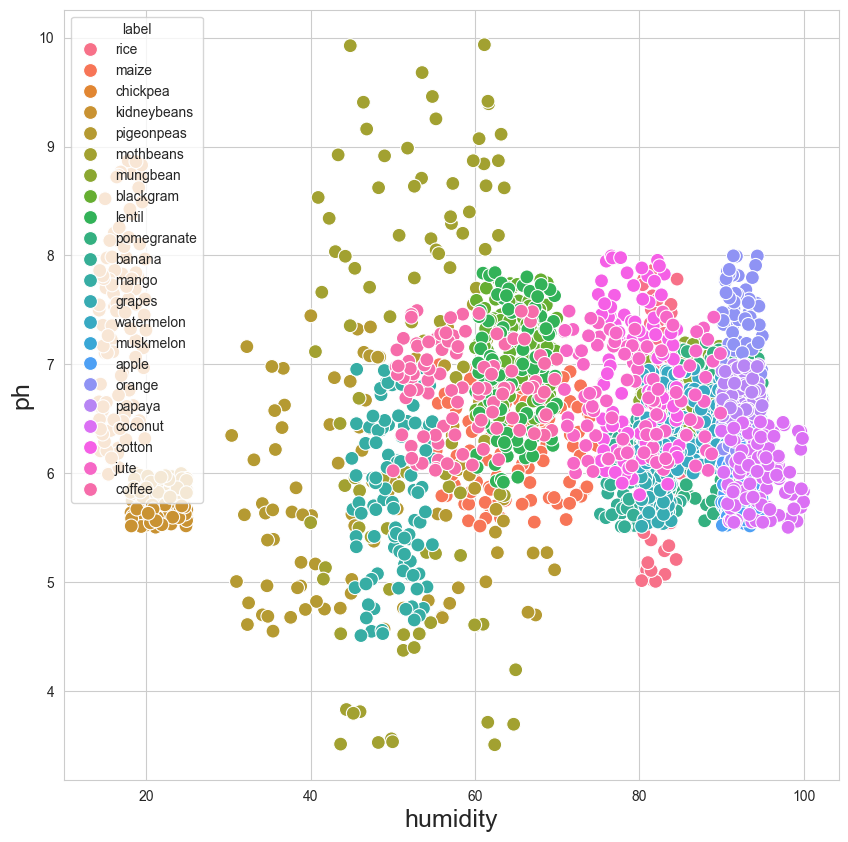

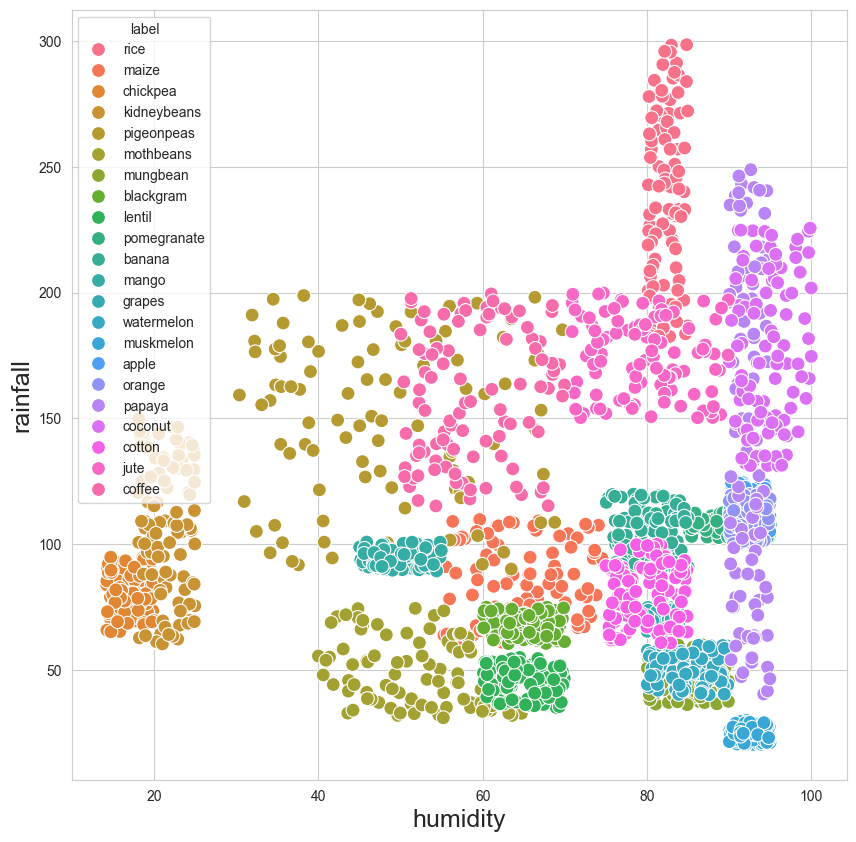

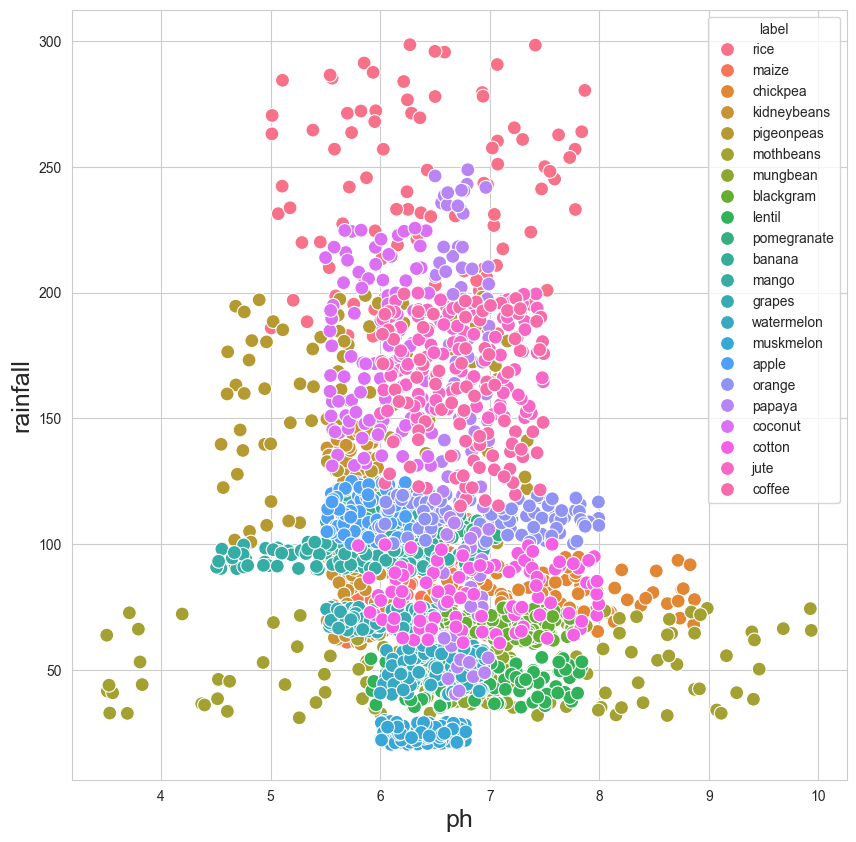

In [25]:
for i in range(0,len(selected_features)):
    for j in range(i+1,len(selected_features)):
        if selected_features[i] != selected_features[j]:
            plt.subplots(figsize=(10, 10))
            sns.scatterplot(x=df[selected_features[i]],y=df[selected_features[j]],hue=df['label'],s=100)
            plt.xlabel(selected_features[i],fontsize = 18)
            plt.ylabel(selected_features[j],fontsize = 18)

## OUTLIER TREATMENT

In [26]:
for x in selected_features:
    # Finding the IQR
    percentile25 = df[x].quantile(0.25)
    percentile75 = df[x].quantile(0.75)
    iqr = percentile75 - percentile25
    
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr
    # Capping the outliers
    
    df[x] = np.where(
        df[x] > upper_limit,
        upper_limit,
        np.where(
            df[x] < lower_limit,
            lower_limit,
            df[x]
        )
    )

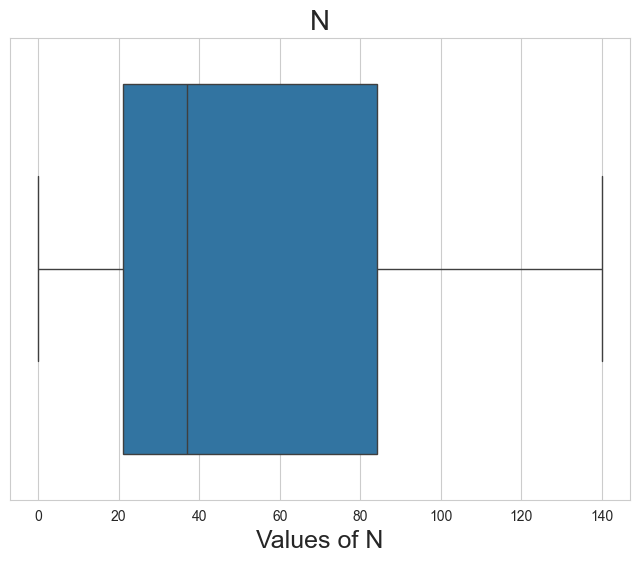

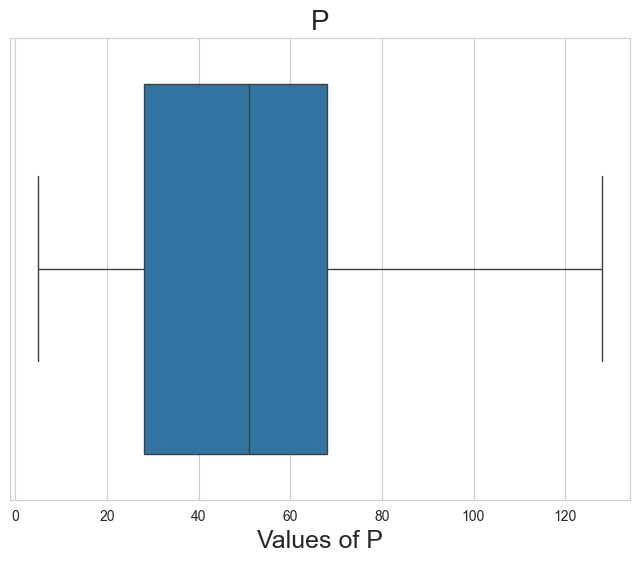

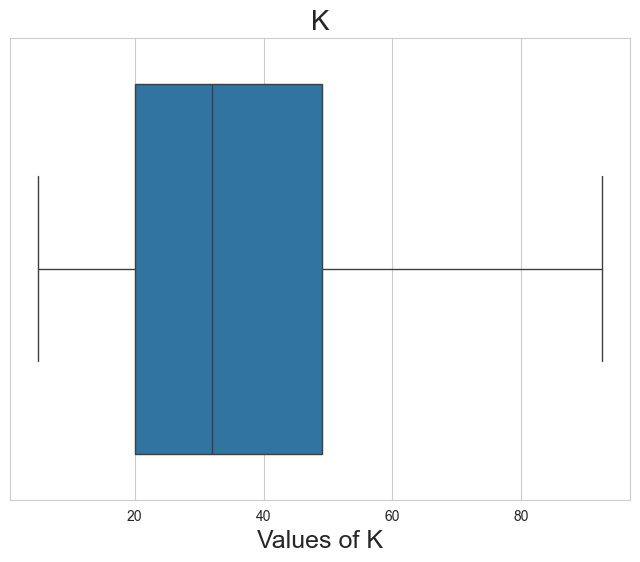

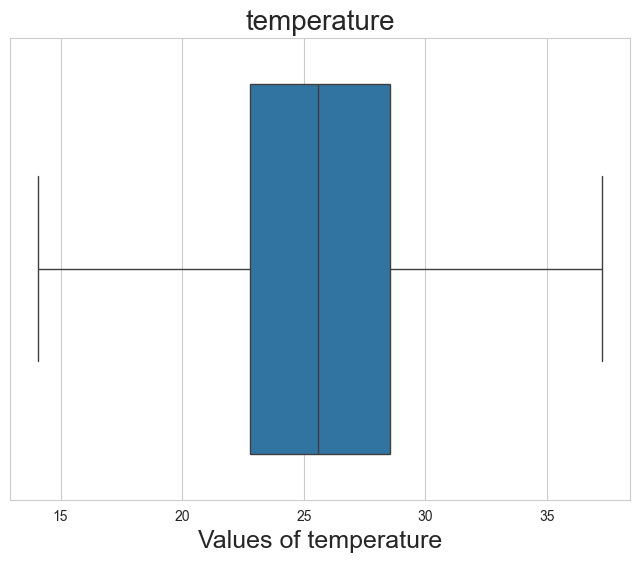

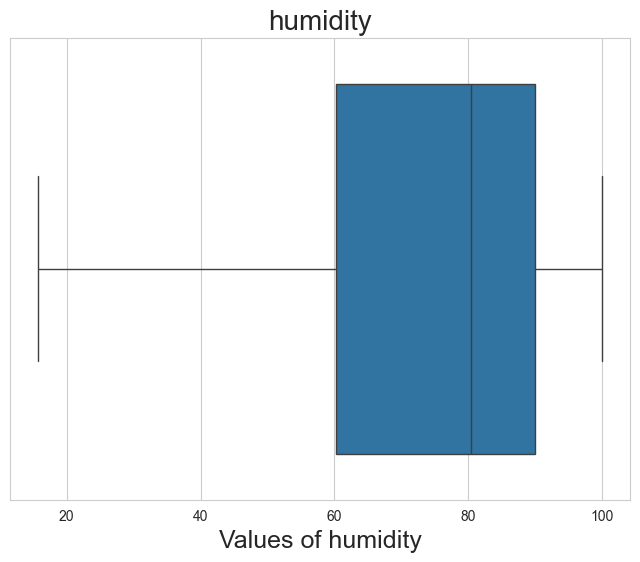

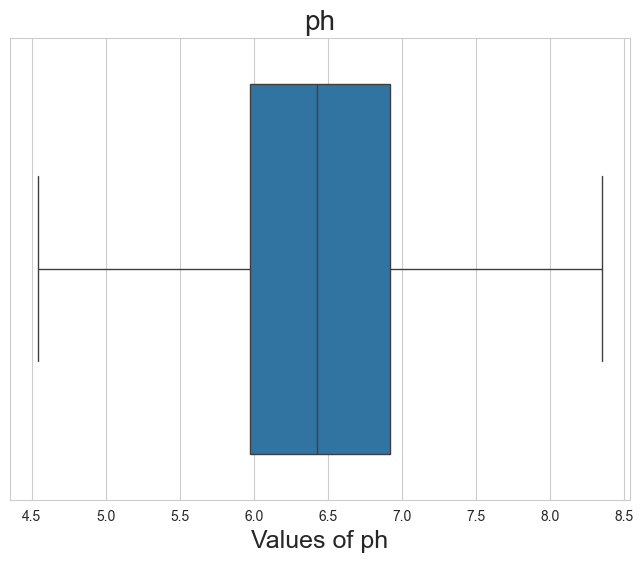

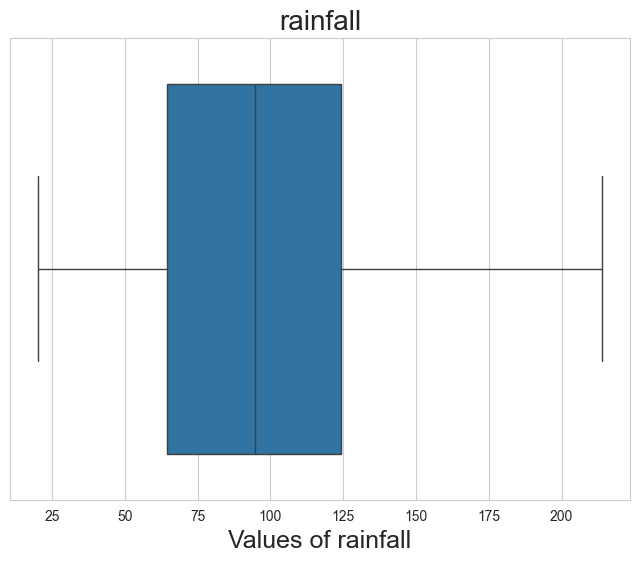

In [27]:
for x in selected_features:
    plt.figure(figsize=(8, 6))
    
    sns.set_style('whitegrid')
    sns.boxplot(x=df[x])
    
    plt.title(x, fontsize=20)
    plt.xlabel("Values of " + x, fontsize=18)
    
    plt.show()

## DATA TRANSFORMATION

### BEFORE TRANSFORMATION

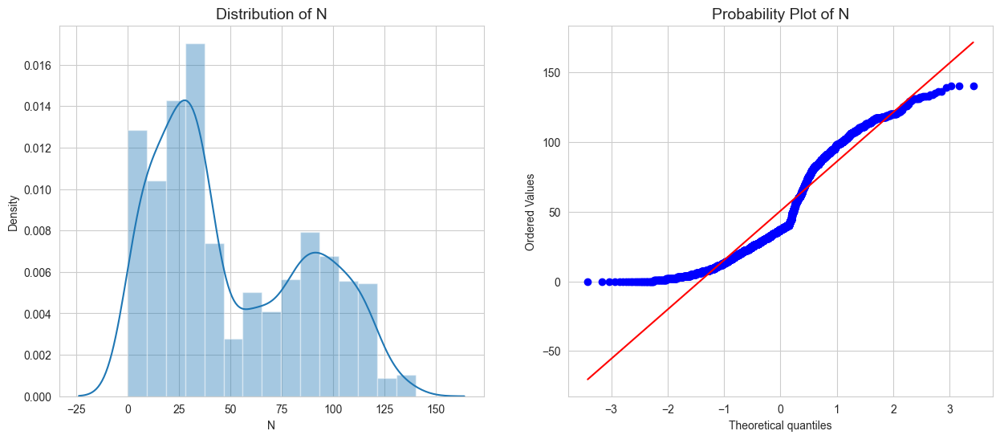

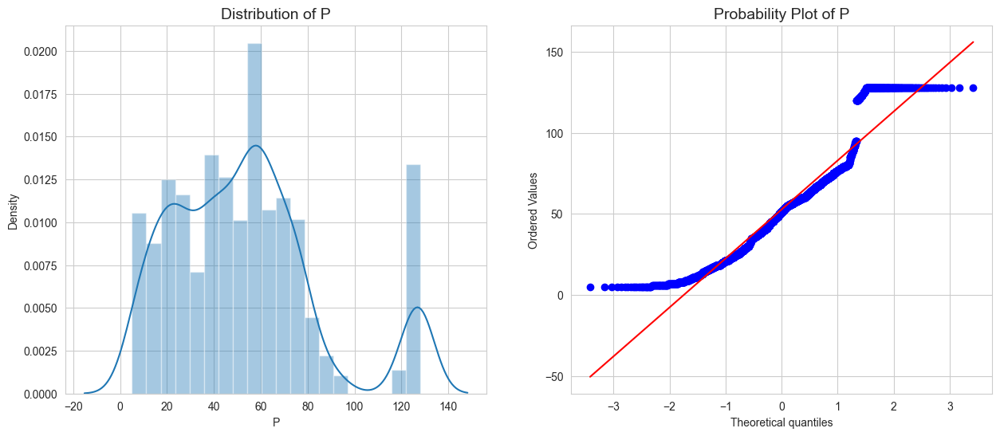

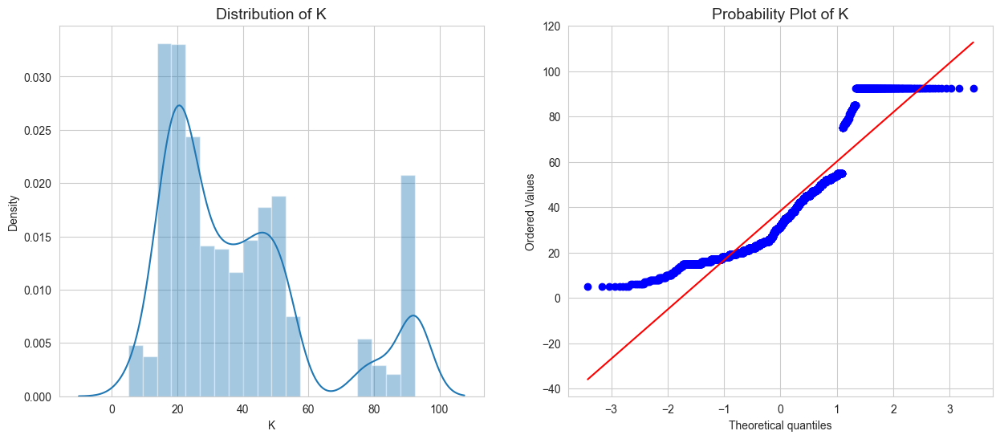

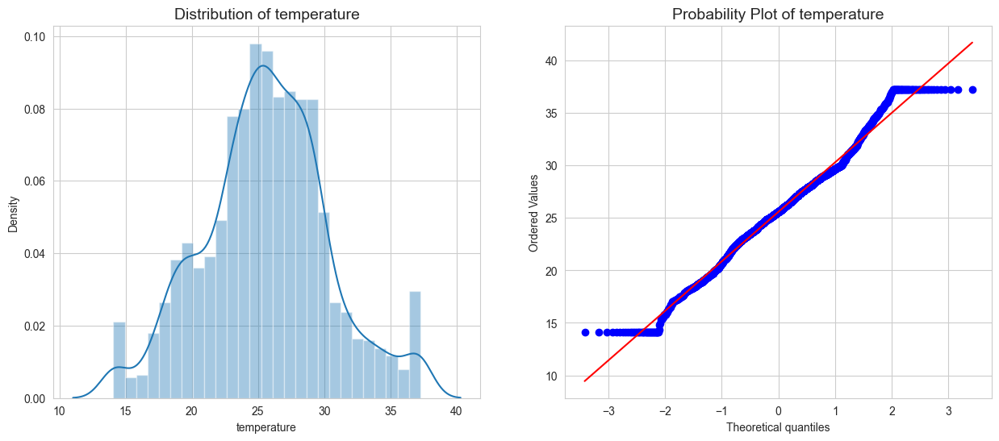

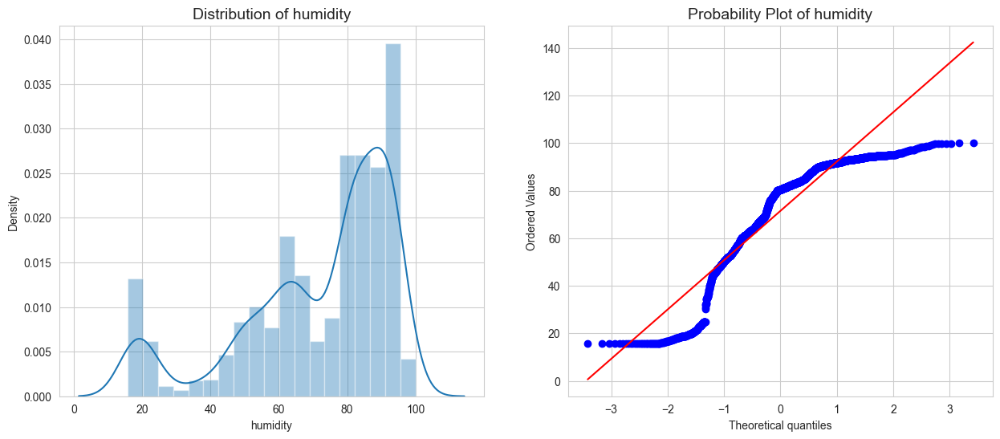

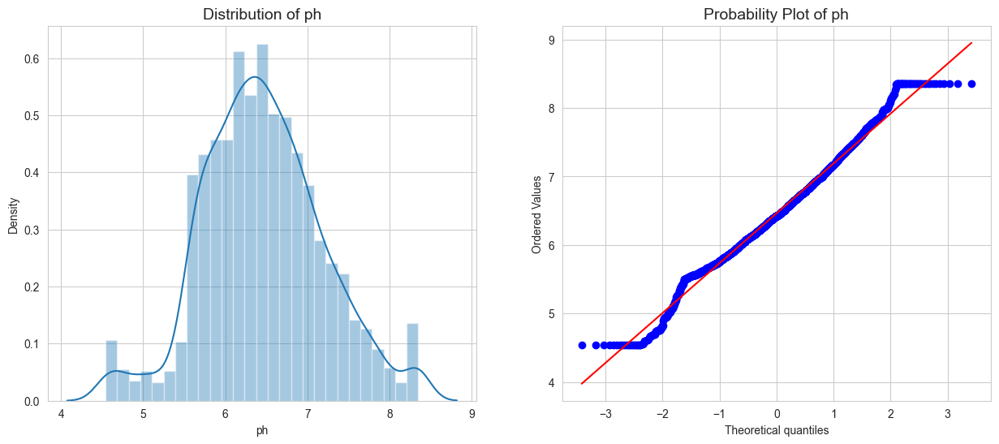

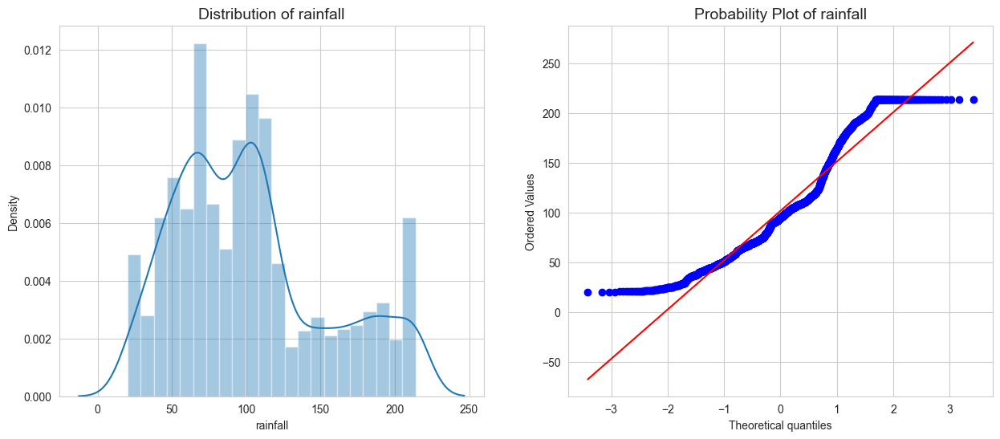

In [28]:
for x in selected_features:
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Plot the distribution (distplot) on the first subplot
    sns.set_style('whitegrid')
    sns.distplot(df[x], ax=axes[0])
    axes[0].set_title("Distribution of " + x, fontsize=14)
    
    # Plot the Probability plot on the second subplot
    stats.probplot(df[x], dist="norm", plot=axes[1])
    axes[1].set_title("Probability Plot of " + x, fontsize=14)
    
    plt.show()

### APPLYING YEO-JOHNSON TRANSFORMATION

In [29]:
from sklearn.preprocessing import PowerTransformer

# Select numeric columns from  DataFrame
numeric_columns = df.select_dtypes(include='number')

# Create a PowerTransformer object using the Yeo-Johnson transformation
pt = PowerTransformer(method='yeo-johnson')

# Fit and transform the numeric columns using the Yeo-Johnson transformation
transformed_data = pt.fit_transform(numeric_columns)

# Replace the original numeric columns with the transformed data
df[numeric_columns.columns] = transformed_data


### AFTER TRANSFORMATION

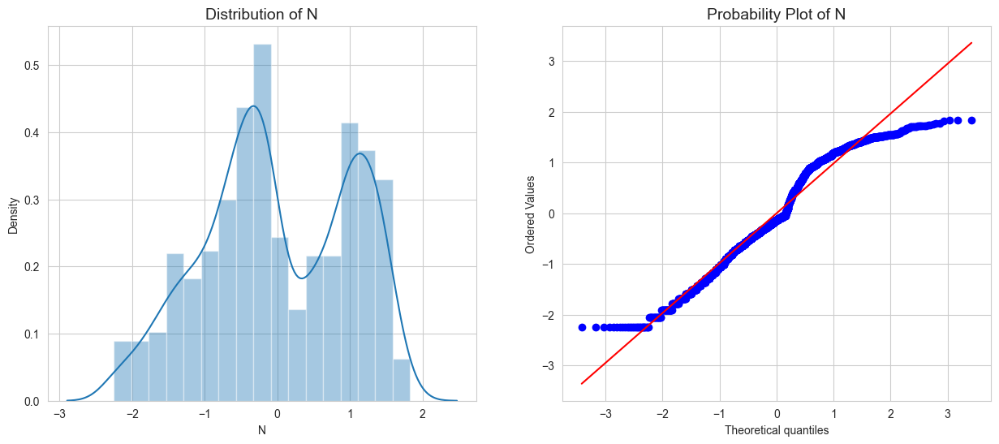

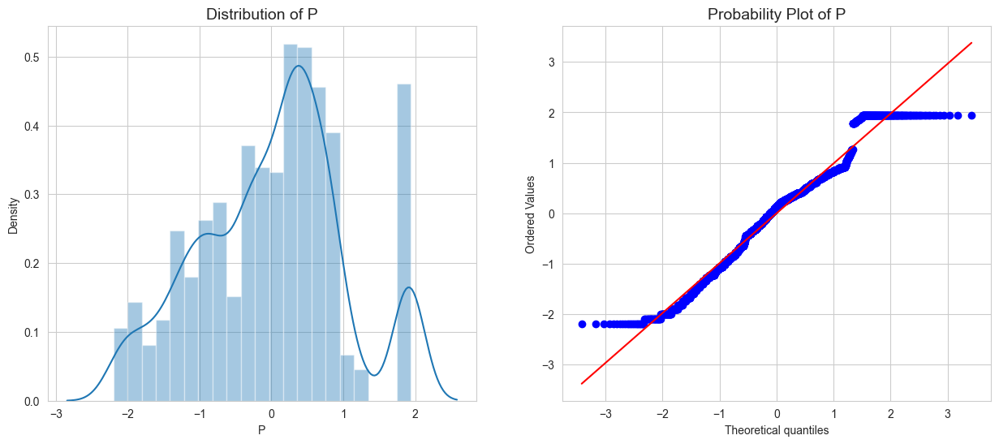

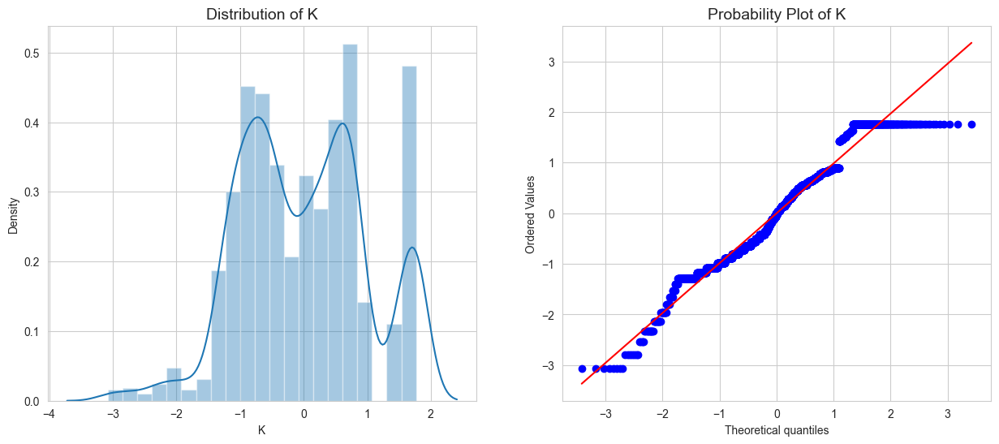

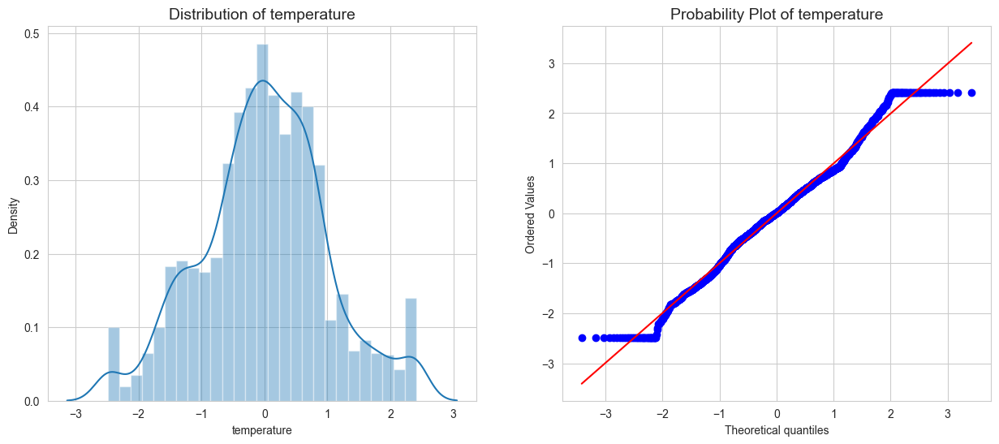

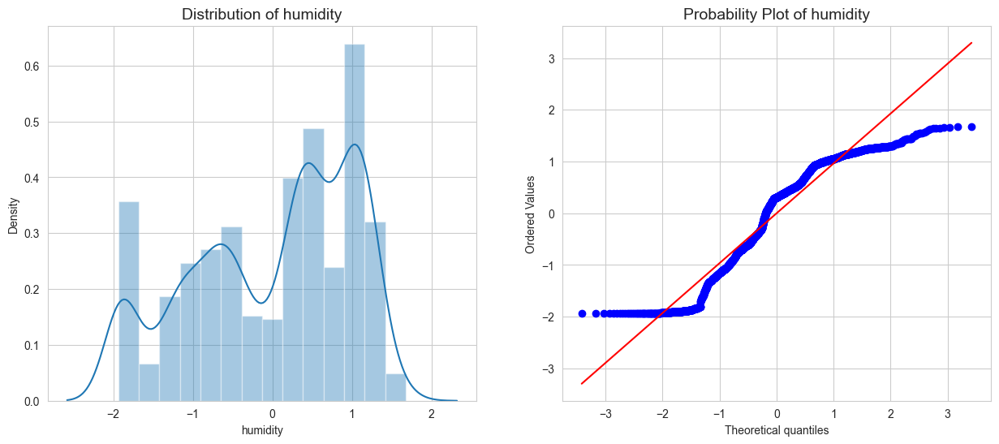

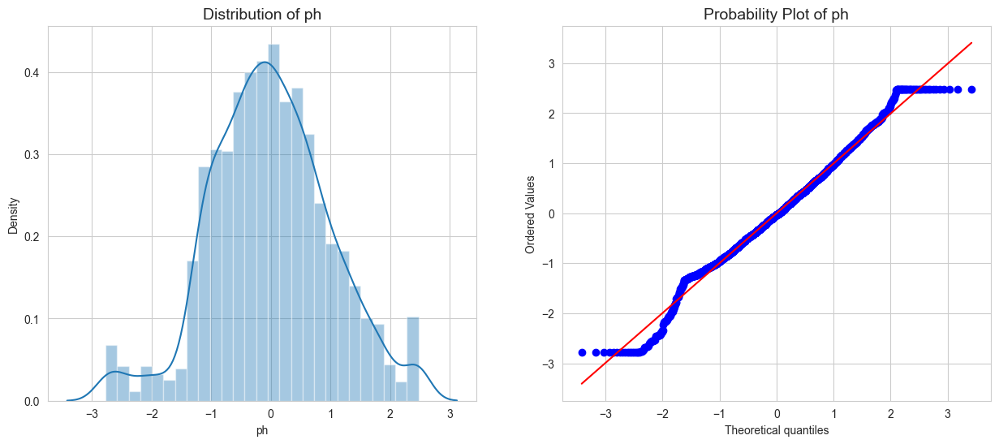

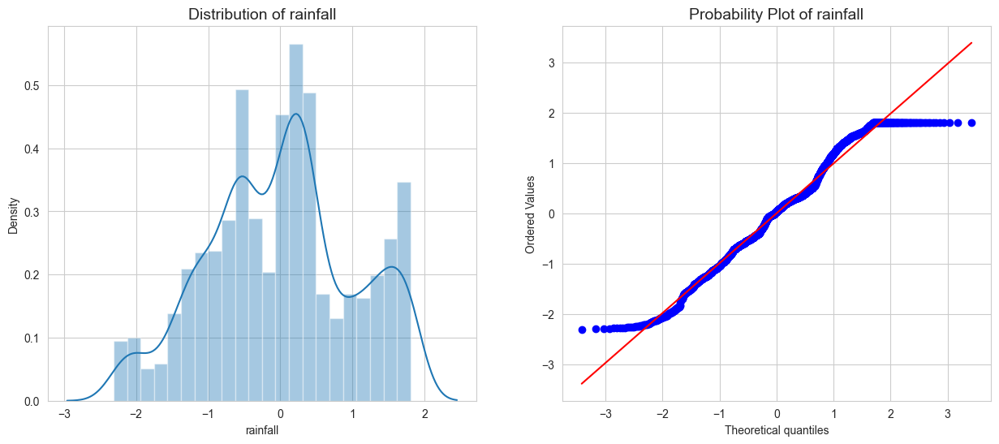

In [30]:
for x in selected_features:
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Plot the distribution (distplot) on the first subplot
    sns.set_style('whitegrid')
    sns.distplot(df[x], ax=axes[0])
    axes[0].set_title("Distribution of " + x, fontsize=14)
    
    # Plot the Probability plot on the second subplot
    stats.probplot(df[x], dist="norm", plot=axes[1])
    axes[1].set_title("Probability Plot of " + x, fontsize=14)
    
    plt.show()

In [31]:
df

,N,P,K,temperature,humidity,ph,rainfall,label
0,1.051047,-0.179125,0.488137,-0.992829,0.405053,0.073855,1.676938,rice
1,0.960517,0.333205,0.408059,-0.801257,0.300619,0.793990,1.804588,rice
2,0.453737,0.243890,0.526769,-0.537285,0.425063,1.836330,1.804588,rice
3,0.749884,-0.438179,0.366521,0.200315,0.290741,0.717347,1.804588,rice
4,0.828446,-0.179125,0.448581,-1.154748,0.380142,1.565233,1.804588,rice
...,...,...,...,...,...,...,...,...
2195,1.338761,-0.477491,-0.009383,0.259801,-0.468573,0.449370,1.363075,coffee
2196,1.206941,-1.401691,-0.296018,0.394329,-0.911108,-0.501289,0.635655,coffee
2197,1.511006,-0.517456,-0.118239,-0.297510,-0.428214,-0.118643,1.304379,coffee
2198,1.495743,-0.558104,0.092826,0.154389,-1.088481,0.420745,0.623323,coffee


In [32]:
df.describe()

,N,P,K,temperature,humidity,ph,rainfall
count,2.200000e+03,2.200000e+03,2.200000e+03,2.200000e+03,2.200000e+03,2.200000e+03,2.200000e+03
mean,-1.162706e-16,2.067033e-16,-1.550275e-16,-1.498599e-15,2.067033e-16,1.207923e-15,-1.550275e-16
std,1.000227e+00,1.000227e+00,1.000227e+00,1.000227e+00,1.000227e+00,1.000227e+00,1.000227e+00
min,-2.251745e+00,-2.200962e+00,-3.073681e+00,-2.488747e+00,-1.935956e+00,-2.772607e+00,-2.312179e+00
25%,-6.874511e-01,-7.282345e-01,-8.022919e-01,-5.874489e-01,-7.563176e-01,-6.630960e-01,-6.600851e-01
50%,-1.360696e-01,1.203993e-01,-9.382791e-03,1.262261e-02,3.100411e-01,-3.283253e-02,3.551462e-02
75%,9.466628e-01,6.133254e-01,7.074462e-01,6.331129e-01,9.316570e-01,6.417189e-01,5.749852e-01
max,1.829456e+00,1.938070e+00,1.765818e+00,2.413599e+00,1.676625e+00,2.479903e+00,1.804588e+00


## CREATING A COPY OF ORIGINAL DATASET

In [33]:
copied_df = df.copy()
copied_df

,N,P,K,temperature,humidity,ph,rainfall,label
0,1.051047,-0.179125,0.488137,-0.992829,0.405053,0.073855,1.676938,rice
1,0.960517,0.333205,0.408059,-0.801257,0.300619,0.793990,1.804588,rice
2,0.453737,0.243890,0.526769,-0.537285,0.425063,1.836330,1.804588,rice
3,0.749884,-0.438179,0.366521,0.200315,0.290741,0.717347,1.804588,rice
4,0.828446,-0.179125,0.448581,-1.154748,0.380142,1.565233,1.804588,rice
...,...,...,...,...,...,...,...,...
2195,1.338761,-0.477491,-0.009383,0.259801,-0.468573,0.449370,1.363075,coffee
2196,1.206941,-1.401691,-0.296018,0.394329,-0.911108,-0.501289,0.635655,coffee
2197,1.511006,-0.517456,-0.118239,-0.297510,-0.428214,-0.118643,1.304379,coffee
2198,1.495743,-0.558104,0.092826,0.154389,-1.088481,0.420745,0.623323,coffee


## NUMERICALLY ENCODING CATEGORICAL LABELS

In [34]:
from sklearn.preprocessing import LabelEncoder 
labelencoder= LabelEncoder() # initializing an object of class LabelEncoder

#Fit and Transforming the label column.
copied_df['label_codes'] = labelencoder.fit_transform(copied_df['label']) 
copied_df

,N,P,K,temperature,humidity,ph,rainfall,label,label_codes
0,1.051047,-0.179125,0.488137,-0.992829,0.405053,0.073855,1.676938,rice,20
1,0.960517,0.333205,0.408059,-0.801257,0.300619,0.793990,1.804588,rice,20
2,0.453737,0.243890,0.526769,-0.537285,0.425063,1.836330,1.804588,rice,20
3,0.749884,-0.438179,0.366521,0.200315,0.290741,0.717347,1.804588,rice,20
4,0.828446,-0.179125,0.448581,-1.154748,0.380142,1.565233,1.804588,rice,20
...,...,...,...,...,...,...,...,...,...
2195,1.338761,-0.477491,-0.009383,0.259801,-0.468573,0.449370,1.363075,coffee,5
2196,1.206941,-1.401691,-0.296018,0.394329,-0.911108,-0.501289,0.635655,coffee,5
2197,1.511006,-0.517456,-0.118239,-0.297510,-0.428214,-0.118643,1.304379,coffee,5
2198,1.495743,-0.558104,0.092826,0.154389,-1.088481,0.420745,0.623323,coffee,5


## SELECTING TARGET LABELS AND INPUT FEATURES

In [35]:
y = copied_df['label_codes']  # Targeted Values 
X = copied_df[selected_features]  # Input Features
X

,N,P,K,temperature,humidity,ph,rainfall
0,1.051047,-0.179125,0.488137,-0.992829,0.405053,0.073855,1.676938
1,0.960517,0.333205,0.408059,-0.801257,0.300619,0.793990,1.804588
2,0.453737,0.243890,0.526769,-0.537285,0.425063,1.836330,1.804588
3,0.749884,-0.438179,0.366521,0.200315,0.290741,0.717347,1.804588
4,0.828446,-0.179125,0.448581,-1.154748,0.380142,1.565233,1.804588
...,...,...,...,...,...,...,...
2195,1.338761,-0.477491,-0.009383,0.259801,-0.468573,0.449370,1.363075
2196,1.206941,-1.401691,-0.296018,0.394329,-0.911108,-0.501289,0.635655
2197,1.511006,-0.517456,-0.118239,-0.297510,-0.428214,-0.118643,1.304379
2198,1.495743,-0.558104,0.092826,0.154389,-1.088481,0.420745,0.623323


In [36]:
y

0       20
1       20
2       20
3       20
4       20
        ..
2195     5
2196     5
2197     5
2198     5
2199     5
Name: label_codes, Length: 2200, dtype: int32

## DATA SPLITTING

In [240]:
from sklearn.metrics import accuracy_score, precision_score, recall_score,f1_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

## IMPLEMENTING VARIOUS MACHINE LEARNING ALGORITHMS

### 1. DECISION TREE CLASSIFIER

In [245]:
# Import Library for Decision Tree Model
from sklearn.tree import DecisionTreeClassifier

In [246]:
# Maximum number of levels in tree
max_depth = list(range(5, 101))

#Criterion
criterion = ["gini", "entropy", "log_loss"]


param_grid = {'criterion': criterion,
               'max_depth': max_depth
             }


In [247]:
dtree = DecisionTreeClassifier()


from sklearn.model_selection import GridSearchCV

dtree_grid = GridSearchCV(estimator = dtree, 
                       param_grid = param_grid, 
                       cv = 10)

dtree_grid.fit(X_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,
                                       16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
                                       26, 27, 28, 29, 30, 31, 32, 33, 34, ...]})

In [248]:
dtree_grid.best_params_

{'criterion': 'gini', 'max_depth': 48}

In [249]:
dtree_grid.best_score_

0.9902597402597403

In [251]:
best_params = {'criterion': 'gini', 'max_depth': 48, 'random_state' : 2}

# Create a Decision Tree model with the best parameters
dtree = DecisionTreeClassifier(**best_params)
dtree.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=48, random_state=2)

Accuracy on Training Data: 100.00%
Precision on Training Data (Macro average): 100.00%
Recall on Training Data (Macro average): 100.00%
F1 score on Training Data (Macro average): 100.00%


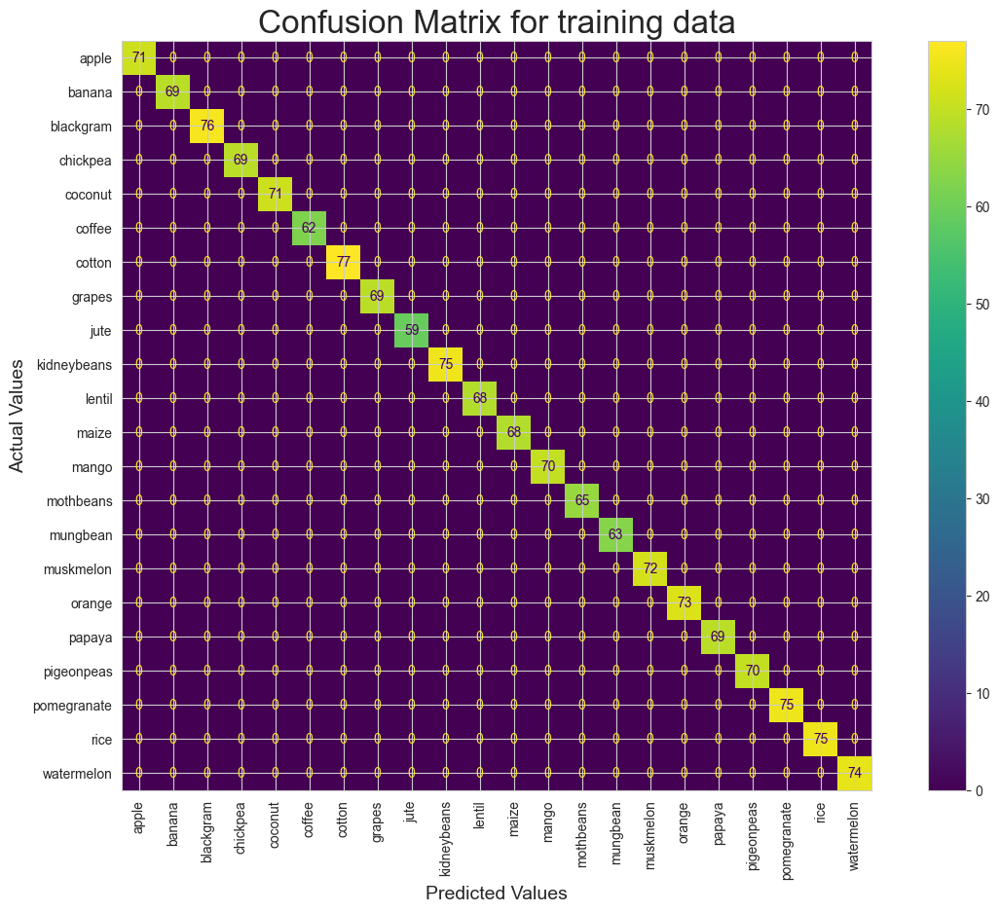

In [252]:
# Accuray On Training Data
decision_predict_train = dtree.predict(X_train)
decision_accuracy_train = accuracy_score(y_train, decision_predict_train)
print(f"Accuracy on Training Data: {decision_accuracy_train * 100:.2f}%")
# Precision on Training Data
print(f"Precision on Training Data (Macro average): {precision_score(y_train, decision_predict_train, average='macro') * 100:.2f}%")
#Recall on training data
print(f"Recall on Training Data (Macro average): {recall_score( y_train, decision_predict_train, average = 'macro') * 100:.2f}%")
# F1 score on training data
print(f"F1 score on Training Data (Macro average): {f1_score( y_train, decision_predict_train, average = 'macro') * 100:.2f}%")

# View Confusion Matrix
cm = confusion_matrix(y_train, decision_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in dtree.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Values", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 97.12%
Precision on Test Data (Macro Average): 97.28 %
Recall on Test Data (Macro Average): 97.49 %
F1 score on Test Data (Macro Average): 97.25 %


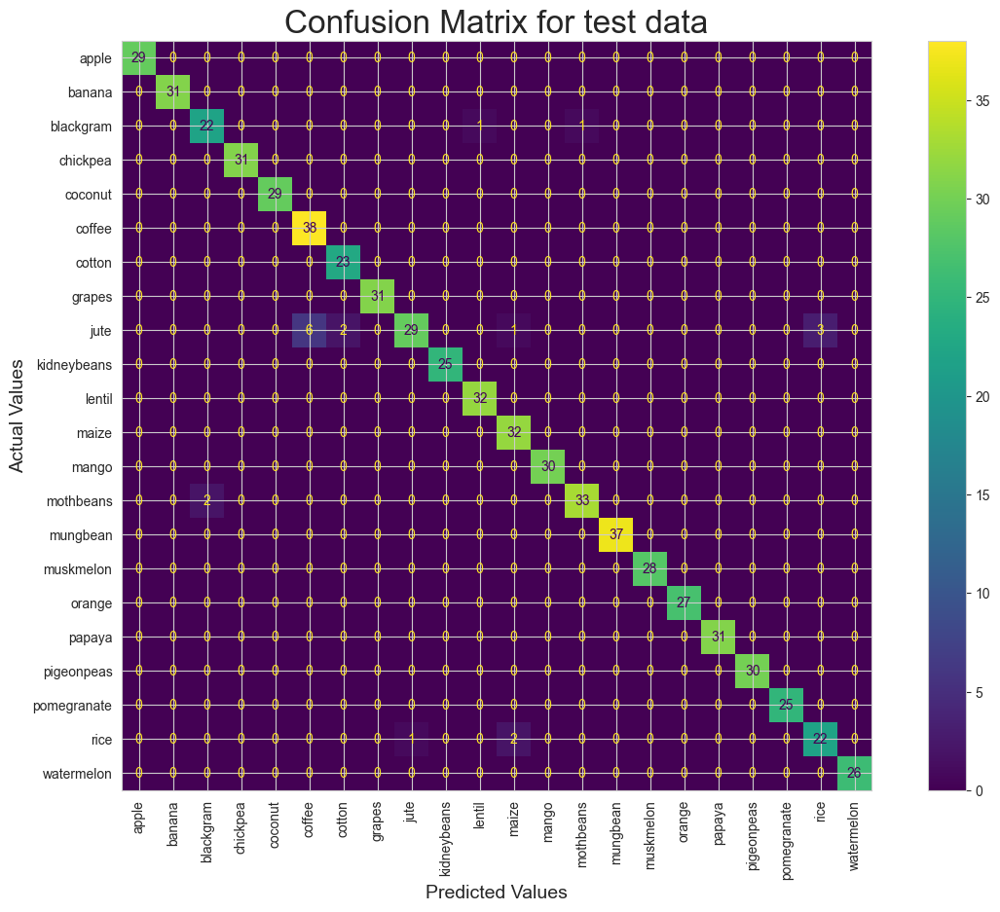

In [253]:
# Accuray On Test Data
decision_predict_test = dtree.predict(X_test)
decision_accuracy_test = accuracy_score(y_test, decision_predict_test)
print(f"Accuracy on Test Data: {decision_accuracy_test * 100:.2f}%")

# Precision on Test Data
decision_precision = precision_score(y_test, decision_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(decision_precision * 100))

# Recall on Test data
decision_recall = recall_score(y_test, decision_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(decision_recall * 100))

# F1 score on Test data
decision_f1 = f1_score(y_test, decision_predict_test, average='macro')
print("F1 score on Test Data (Macro Average): {:.2f} %".format(decision_f1 * 100))

# View Confusion Matrix
cm = confusion_matrix(y_test, decision_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in dtree.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for test data", fontsize=24)
plt.xlabel("Predicted Values", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

In [254]:
# Get the unique classes from the 'label' column and convert them into a list
unique_classes = copied_df['label'].unique().tolist()

# Print the list of unique classes
print(unique_classes)


['rice', 'maize', 'chickpea', 'kidneybeans', 'pigeonpeas', 'mothbeans', 'mungbean', 'blackgram', 'lentil', 'pomegranate', 'banana', 'mango', 'grapes', 'watermelon', 'muskmelon', 'apple', 'orange', 'papaya', 'coconut', 'cotton', 'jute', 'coffee']


In [256]:
# VISUALIZING THE CLASSIFIER
from sklearn.tree import plot_tree

# Display the decision tree
plt.figure(figsize=(100, 100))
plot_tree(dtree, filled=True, feature_names=selected_features, class_names=unique_classes,fontsize=40)
plt.show()


### 2. RANDOM FOREST CLASSIFIER

In [225]:
from sklearn.ensemble import RandomForestClassifier

In [241]:
rf = RandomForestClassifier(n_estimators=100, random_state=0 )
rf.fit(X_train,y_train)

RandomForestClassifier(random_state=0)

In [242]:
# Prediction of Train and Test Dataset
random_predict_train = rf.predict(X_train)
random_predict_test = rf.predict(X_test)

Accuracy on Training Data : 100.00 %
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00%


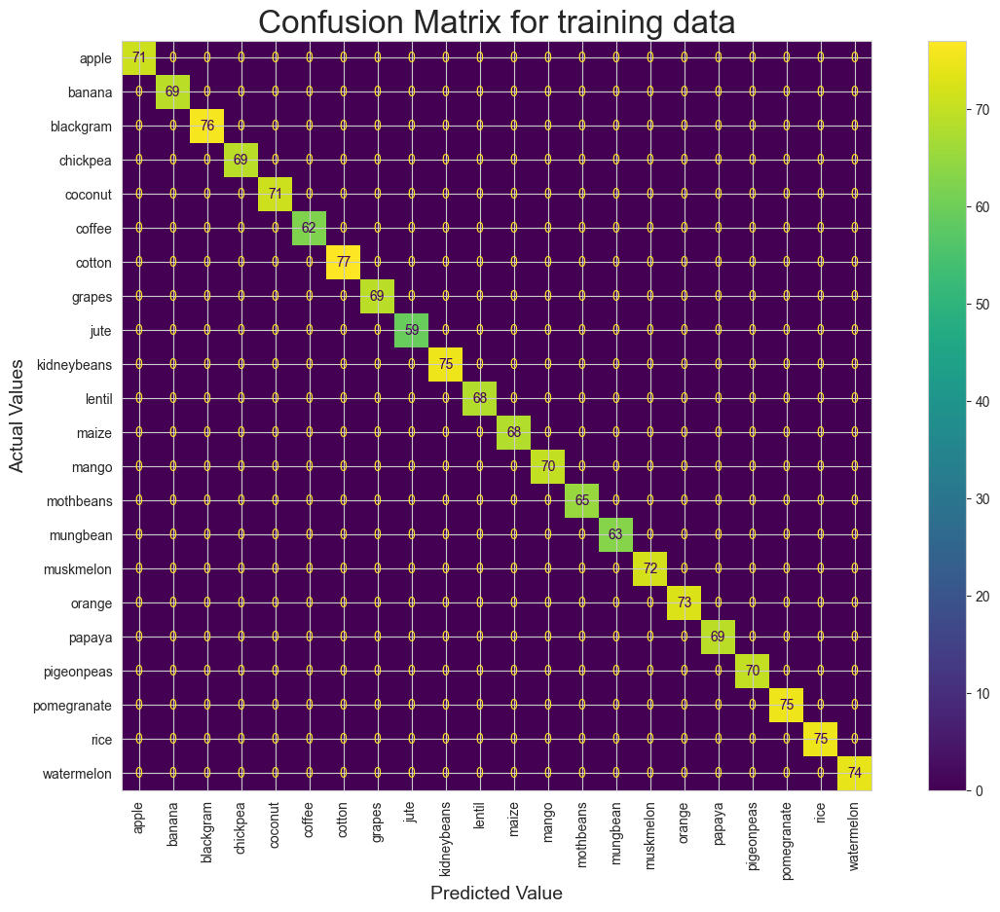

In [243]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, random_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, random_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, random_predict_train, average = "macro") * 100) )
print(f"F1 score on Training Data (Macro average): {f1_score( y_train, random_predict_train, average = 'macro') * 100:.2f}%")
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, random_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in rf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 99.55 %
Precision on Test Data (Macro Average): 99.67 %
Recall on Test Data (Macro Average): 99.53 %
F1 score on Test Data (Macro Average): 99.59 %


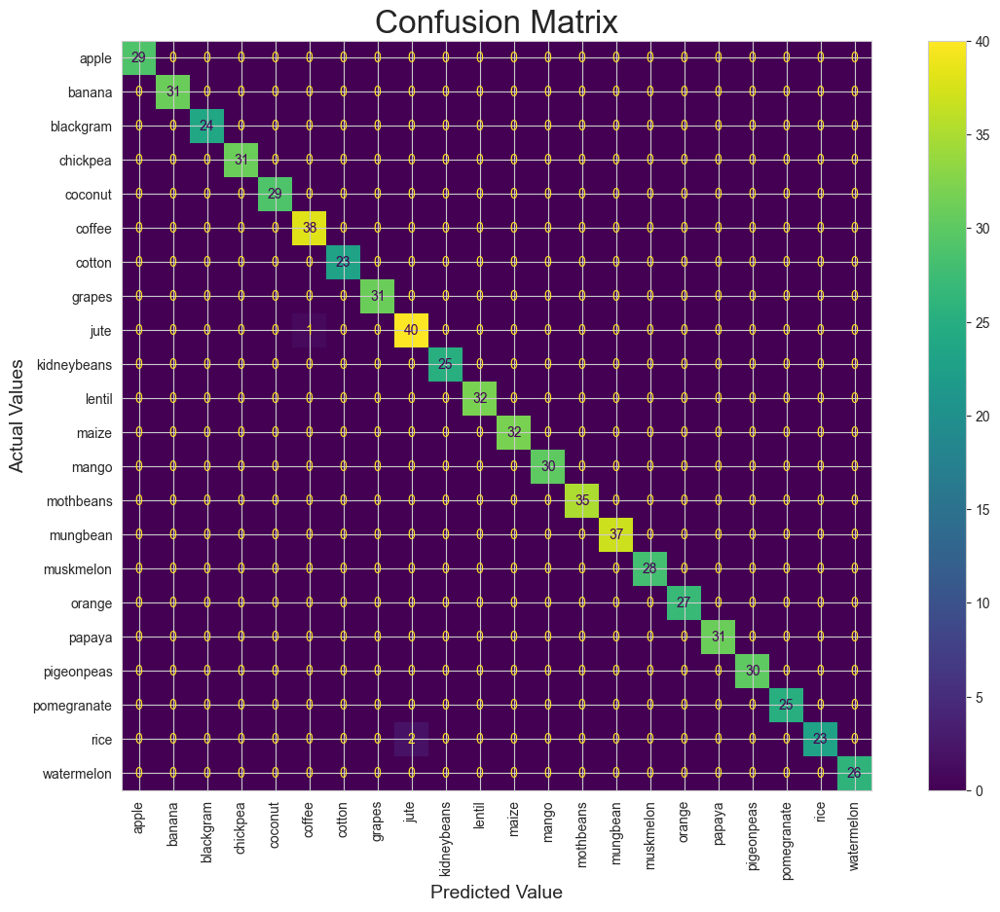

In [244]:
# Accuracy of Testing Dataset
random_accuracy = accuracy_score(y_test, random_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(random_accuracy * 100))

# Precision on Testing Dataset
random_precision = precision_score(y_test, random_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(random_precision * 100))

# Recall on Testing Dataset
random_recall = recall_score(y_test, random_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(random_recall * 100))

# F1 score
random_f1 = f1_score(y_test, random_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(random_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test,random_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in rf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

In [257]:
# TO STUDY ONE SINGLE TREE AT A TIME

# Taking user input as the tree number
tree_num = int(input("ENTER THE TREE NUMBER FROM 1 TO " + str(len(rf.estimators_)) + " THAT YOU WANT TO VISUALIZE:"))

# VISUALIZE THE INDIVIDUAL TREE THAT THE USER WANTS TO SEE
plt.figure(figsize=(90,90))  # Adjust the figure size as needed
plot_tree(rf.estimators_[tree_num-1], filled=True, feature_names=selected_features, class_names=unique_classes, fontsize = 35)
plt.title(f'Tree {tree_num}', fontsize=16)
plt.show()


ENTER THE TREE NUMBER FROM 1 TO 100 THAT YOU WANT TO VISUALIZE: 53


### 3. LOGISTIC REGRESSION

In [258]:
from sklearn.linear_model import LogisticRegression

In [259]:
# Regularization to consider
penalty = ["l1", "l2", "elasticnet", None]

multi_class = ["auto", "ovr", "multinomial"]

In [260]:
param_grid = {'penalty': penalty,
               'multi_class': multi_class
             }

In [261]:
clf = LogisticRegression()

In [262]:
from sklearn.model_selection import GridSearchCV

clf_grid = GridSearchCV(estimator = clf, 
                       param_grid = param_grid, 
                       cv = 10, 
                       verbose=2, 
                       n_jobs = -1)

In [263]:
clf_grid.fit(X_train,y_train) 

Fitting 10 folds for each of 12 candidates, totalling 120 fits


GridSearchCV(cv=10, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'multi_class': ['auto', 'ovr', 'multinomial'],
                         'penalty': ['l1', 'l2', 'elasticnet', None]},
             verbose=2)

In [264]:
clf_grid.best_params_

{'multi_class': 'auto', 'penalty': None}

In [265]:
clf_grid.best_score_

0.9785714285714286

In [266]:
best_params = {'multi_class': 'auto', 'penalty': None}

clf = LogisticRegression(**best_params)
clf.fit(X_train,y_train)

LogisticRegression(penalty=None)

In [267]:
logistic_predict_train = clf.predict(X_train)
logistic_predict_test = clf.predict(X_test)

Accuracy on Training Data : 99.22 %
Precision on Training Data (Macro average): 99.17 %
Recall on Training Data (Macro average): 99.17 %
F1 score on Training Data (Macro average): 99.17 %


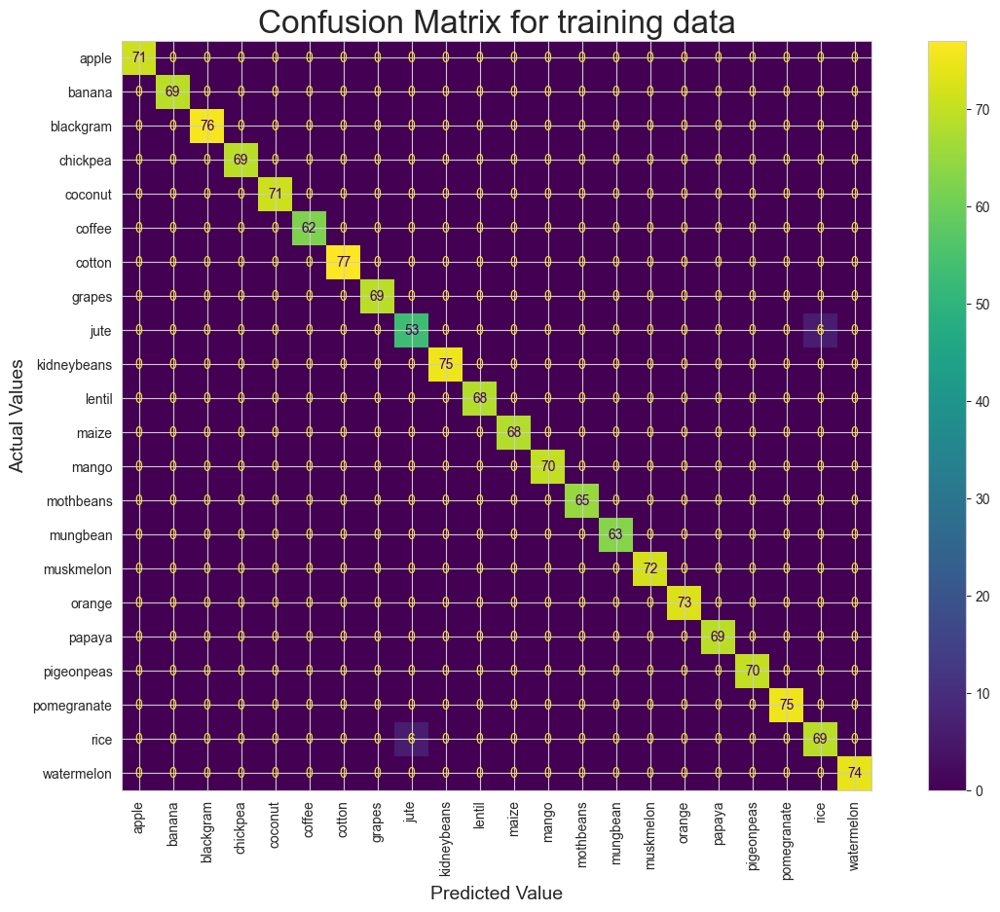

In [268]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, logistic_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, logistic_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, logistic_predict_train, average = "macro") * 100))
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,logistic_predict_train,average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, logistic_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in clf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 98.03 %
Precision on Test Data (Macro Average): 98.18 %
Recall on Test Data (Macro Average): 98.09 %
F1 score on Test Data (Macro Average): 98.12 %


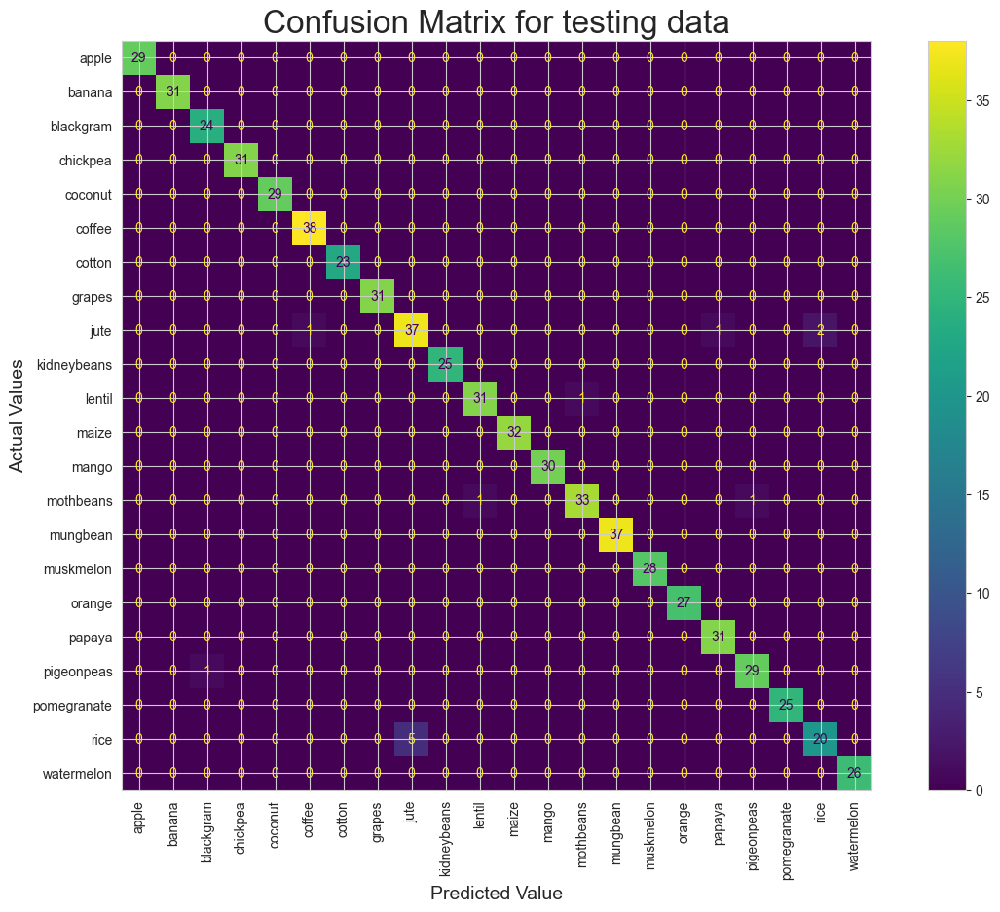

In [269]:
# Accuracy of Testing Dataset
softmax_accuracy = accuracy_score(y_test, logistic_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(softmax_accuracy * 100))

# Precision on Testing Dataset
softmax_precision = precision_score(y_test, logistic_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(softmax_precision * 100))

# Recall on Testing Dataset
softmax_recall = recall_score(y_test, logistic_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(softmax_recall * 100))

# F1 score
softmax_f1 = f1_score(y_test, logistic_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(softmax_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, logistic_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in clf.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

### 4. SUPPORT VECTOR MACHINES

In [270]:
from sklearn.svm import SVC

In [271]:
kernel = ["linear", "poly", "rbf", "sigmoid"]

param_grid = {'kernel': kernel}

support_vector_classifier = SVC()

svc_grid = GridSearchCV(estimator = support_vector_classifier, 
                       param_grid = param_grid, 
                       cv = 10, 
                       verbose=2, 
                       n_jobs = -1)

svc_grid.fit(X_train,y_train)

Fitting 10 folds for each of 4 candidates, totalling 40 fits


GridSearchCV(cv=10, estimator=SVC(), n_jobs=-1,
             param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             verbose=2)

In [272]:
svc_grid.best_params_

{'kernel': 'rbf'}

In [273]:
svc_grid.best_score_

0.9850649350649352

In [274]:
support_vector_classifier = SVC(kernel="rbf")
support_vector_classifier.fit(X_train, y_train.ravel())

SVC()

In [275]:
svm_predict_train = support_vector_classifier.predict(X_train)
svm_predict_test = support_vector_classifier.predict(X_test)

Accuracy on Training Data : 98.77 %
Precision on Training Data (Macro average): 98.78 %
Recall on Training Data (Macro average): 98.67 %
F1 score on Training Data (Macro average): 98.71 %


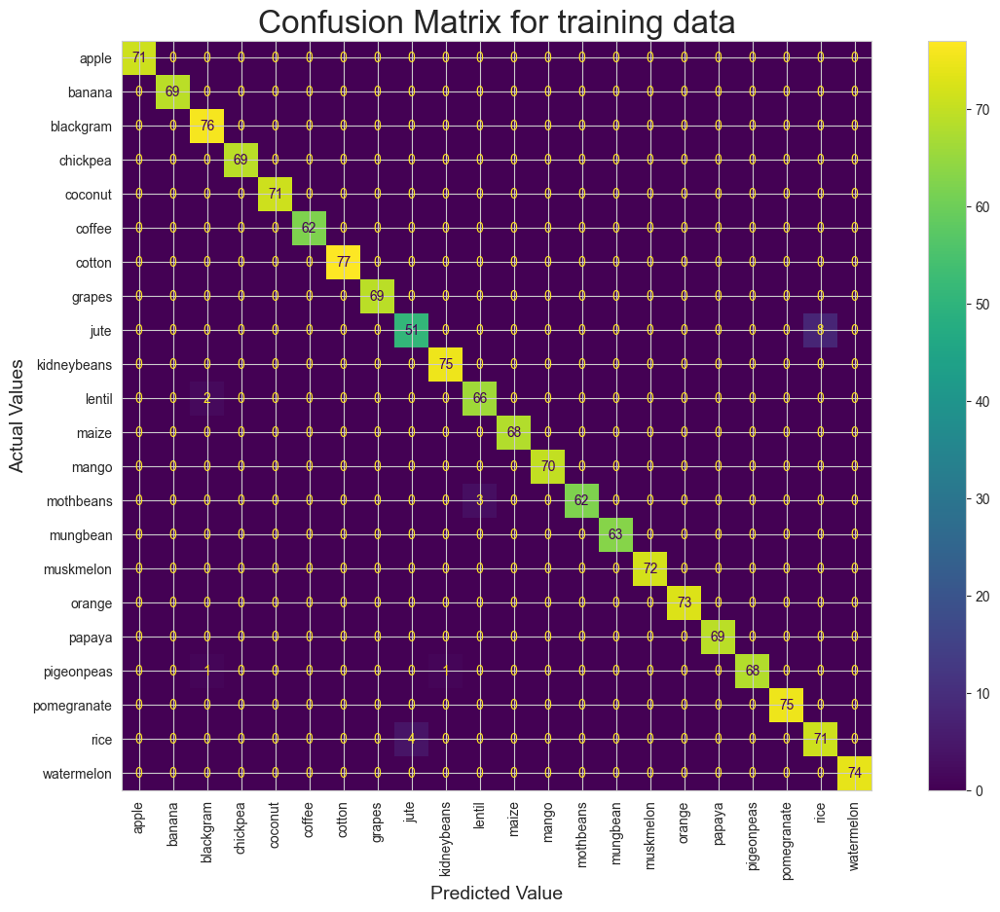

In [276]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, svm_predict_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, svm_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, svm_predict_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,svm_predict_train,average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, svm_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in support_vector_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 98.33 %
Precision on Test Data (Macro Average): 98.35 %
Recall on Test Data (Macro Average): 98.40 %
F1 score on Test Data (Macro Average): 98.34 %


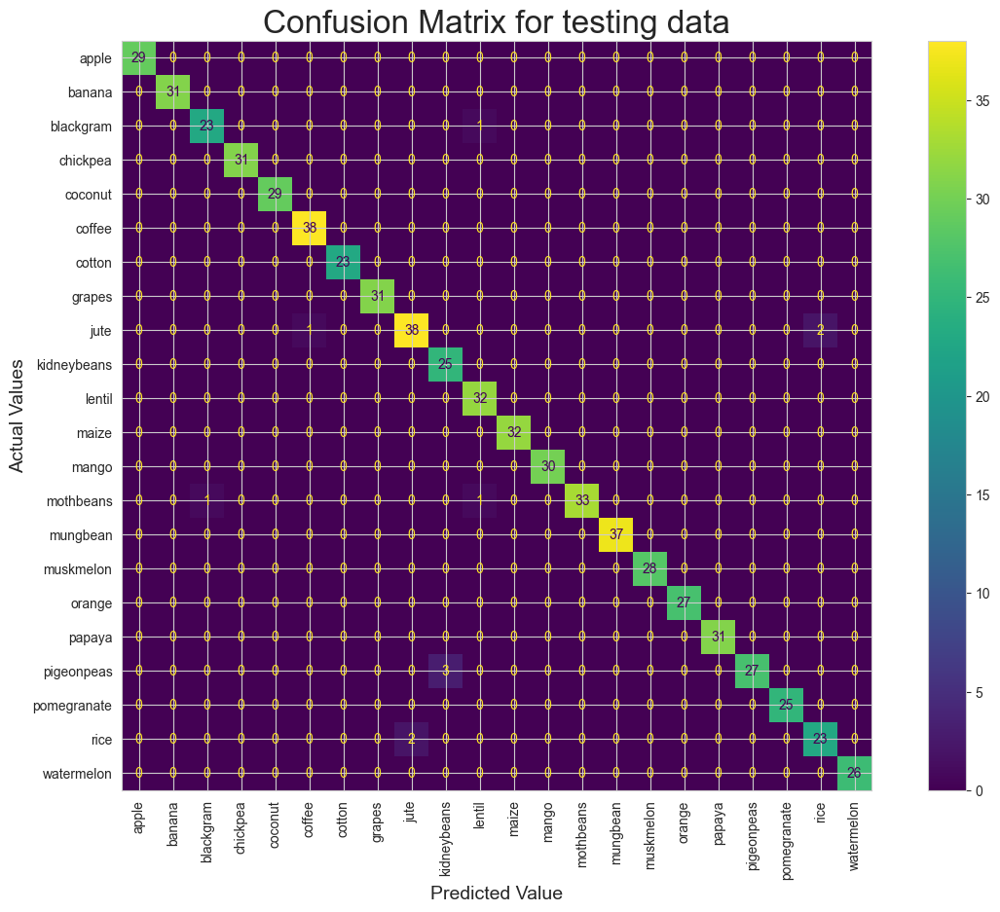

In [277]:
# Accuracy on Test Data
svm_accuracy = accuracy_score(y_test, svm_predict_test)
print("Accuracy on Test Data: {:.2f} %".format(svm_accuracy * 100))

# Precision on Testing Dataset
svm_precision = precision_score(y_test, svm_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(svm_precision * 100))

# Recall on Testing Dataset
svm_recall = recall_score(y_test, svm_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(svm_recall * 100))

# F1 score
svm_f1 = f1_score(y_test, svm_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(svm_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, svm_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in support_vector_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 5. K-NEAREST NEIGHBOUR

In [278]:
from sklearn.neighbors import KNeighborsClassifier

In [279]:
n_neighbors = list(range(3, 21))

param_grid = {'n_neighbors': n_neighbors}

knn_classifier = KNeighborsClassifier()

knn_grid = GridSearchCV(estimator = knn_classifier, 
                       param_grid = param_grid, 
                       cv = 10, 
                       verbose=2, 
                       n_jobs = -1)

knn_grid.fit(X_train,y_train)

Fitting 10 folds for each of 18 candidates, totalling 180 fits


GridSearchCV(cv=10, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,
                                         14, 15, 16, 17, 18, 19, 20]},
             verbose=2)

In [280]:
knn_grid.best_params_

{'n_neighbors': 7}

In [281]:
knn_grid.best_score_

0.9720779220779223

In [282]:
knn_classifier = KNeighborsClassifier(n_neighbors = 7) # K = 7
knn_classifier.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=7)

In [283]:
knn_train = knn_classifier.predict(X_train)
knn_test = knn_classifier.predict(X_test)

Accuracy on Training Data : 97.92 %
Precision on Training Data (Macro average): 98.02 %
Recall on Training Data (Macro average): 97.87 %
F1 score on Training Data (Macro average): 97.88 %


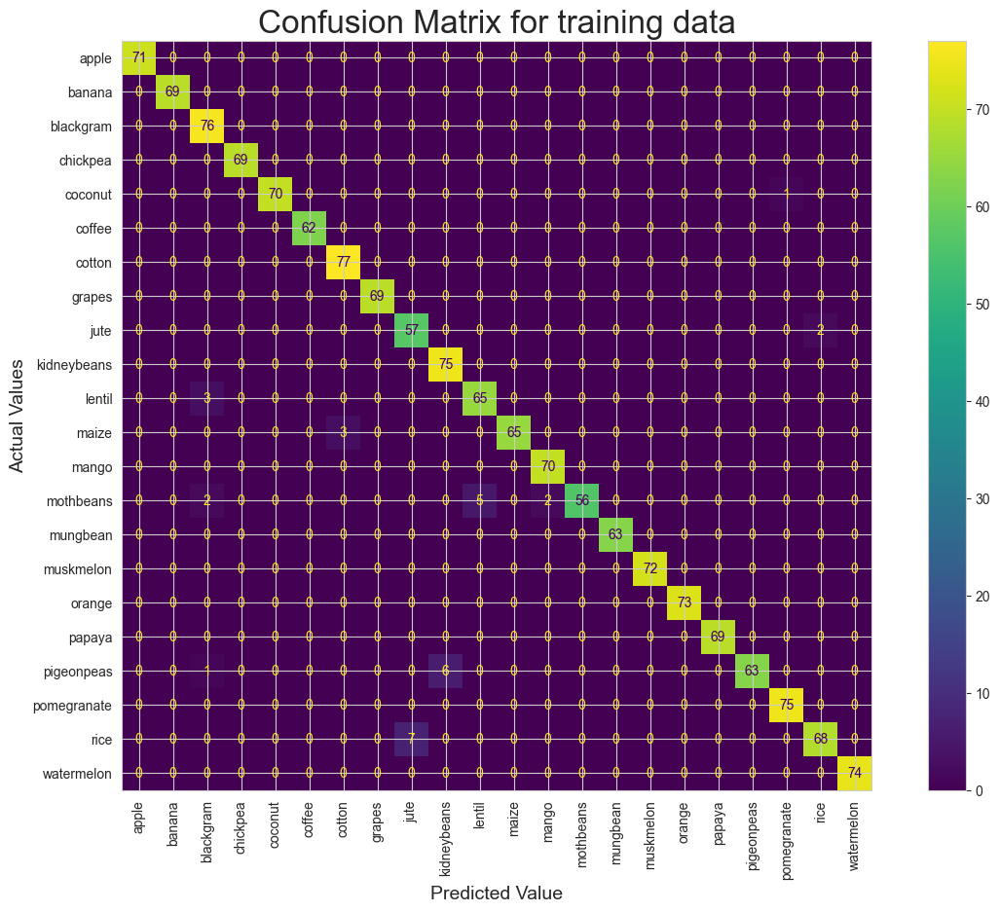

In [284]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, knn_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, knn_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, knn_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,knn_train,average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, knn_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in knn_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


Accuracy on Test Data: 97.73 %
Precision on Test Data (Macro Average): 97.73 %
Recall on Test Data (Macro Average): 97.85 %
F1 score on Test Data (Macro Average): 97.70 %


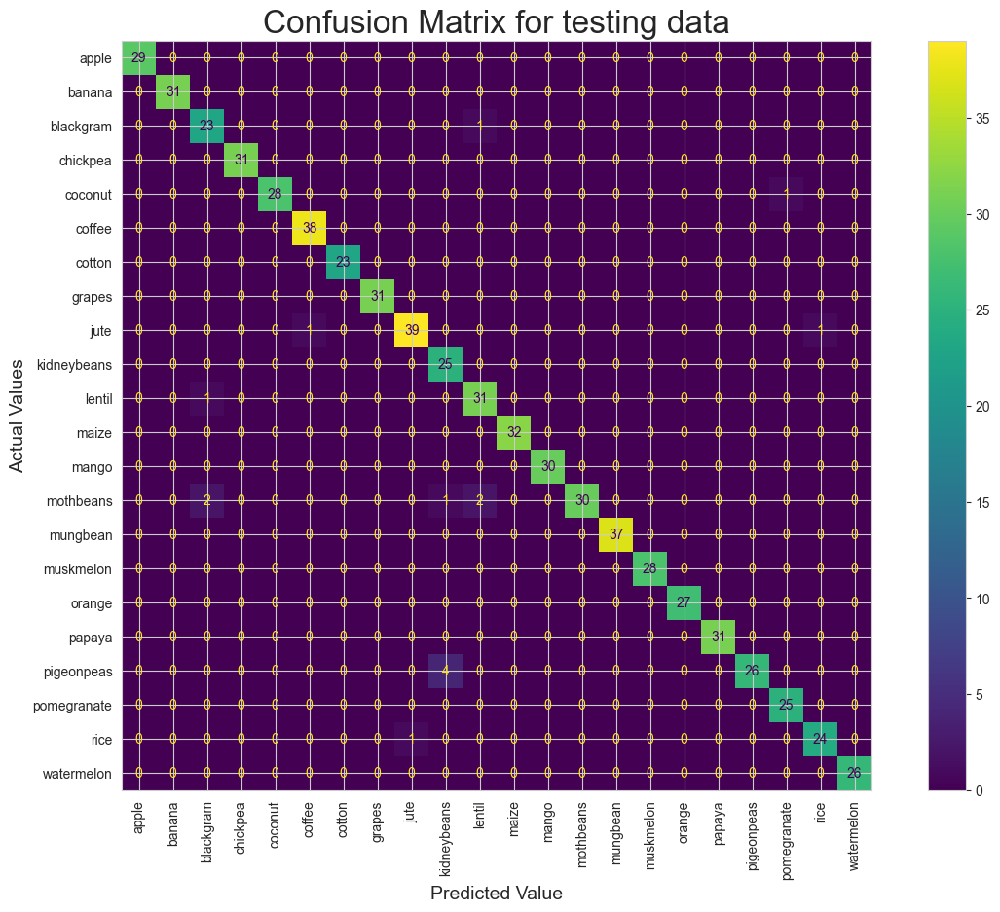

In [285]:
# Accuracy on Test Data
knn_accuracy = accuracy_score(y_test, knn_test)
print("Accuracy on Test Data: {:.2f} %".format(knn_accuracy * 100))

# Precision on Testing Dataset
knn_precision = precision_score(y_test, knn_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(knn_precision * 100))

# Recall on Testing Dataset
knn_recall = recall_score(y_test, knn_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(knn_recall * 100))

# F1 score
knn_f1 = f1_score(y_test, knn_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(knn_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, knn_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in knn_classifier.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 6. CATEGORICAL NAIVE BAYES CLASSIFIER

In [286]:
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.naive_bayes import CategoricalNB

In [287]:
# Specifying the columns to discretize
columns_to_discretize = ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']

# Creating a KBinsDiscretizer to discretize the features
kbins_discretizer = KBinsDiscretizer(n_bins=25, encode='ordinal', strategy='kmeans')
X_discretized = kbins_discretizer.fit_transform(X[columns_to_discretize])
X_discretized

array([[20., 13., 18., ..., 16., 13., 23.],
       [19., 16., 17., ..., 15., 17., 24.],
       [16., 15., 18., ..., 16., 21., 24.],
       ...,
       [23., 10., 15., ..., 10., 12., 21.],
       [23., 10., 16., ...,  5., 15., 18.],
       [21.,  5., 15., ...,  8., 15., 19.]])

In [289]:
# Splitting the discretized dataset
X1_train, X1_test, y1_train, y1_test = train_test_split(X_discretized, y, test_size=0.3)
print(X1_train.shape)
print(X1_test.shape)

(1540, 7)
(660, 7)


In [290]:
# Create and train the Categorical Naive Bayes classifier
catnb = CategoricalNB()
catnb.fit(X1_train, y1_train)

CategoricalNB()

In [291]:
catnb_train = catnb.predict(X1_train)
catnb_test = catnb.predict(X1_test)

Accuracy on Training Data : 99.29 %
Precision on Training Data (Macro average): 99.29 %
Recall on Training Data (Macro average): 99.20 %
F1 score on Training Data (Macro average): 99.23 %


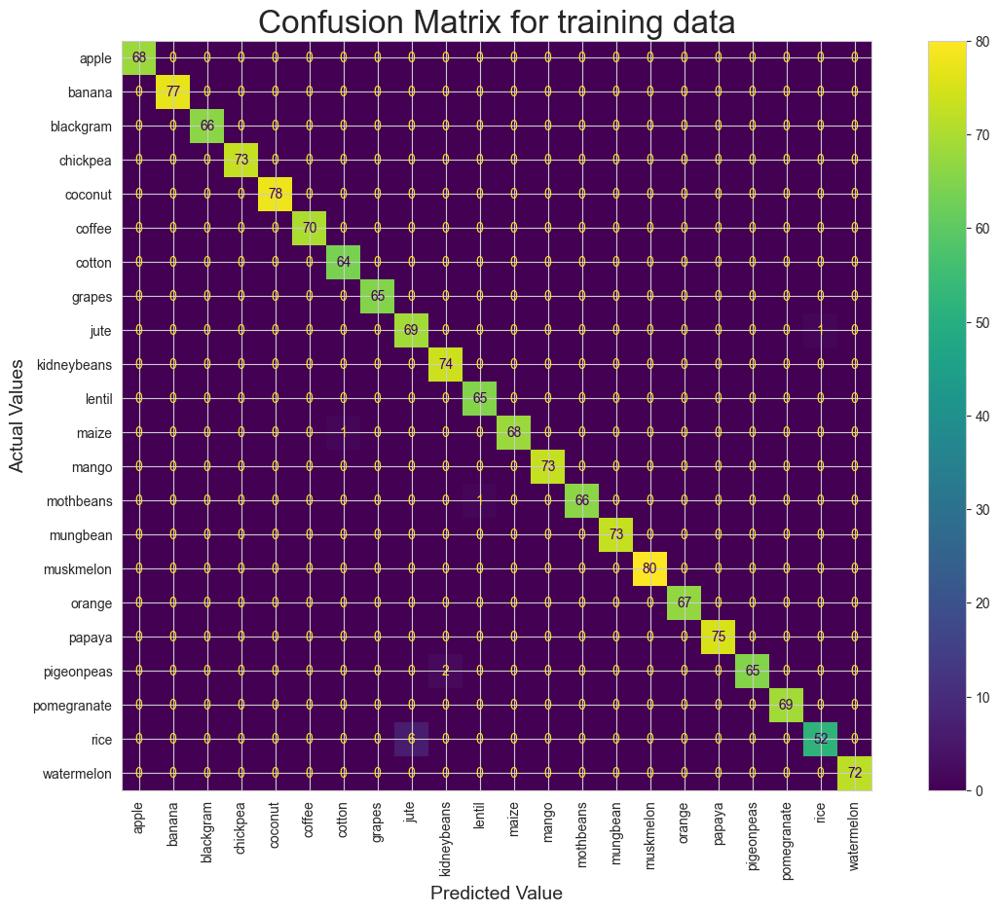

In [292]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y1_train, catnb_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y1_train, catnb_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y1_train, catnb_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y1_train,catnb_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y1_train, catnb_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in catnb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.09 %
Precision on Test Data (Macro Average): 99.18 %
Recall on Test Data (Macro Average): 99.27 %
F1 score on Test Data (Macro Average): 99.21 %


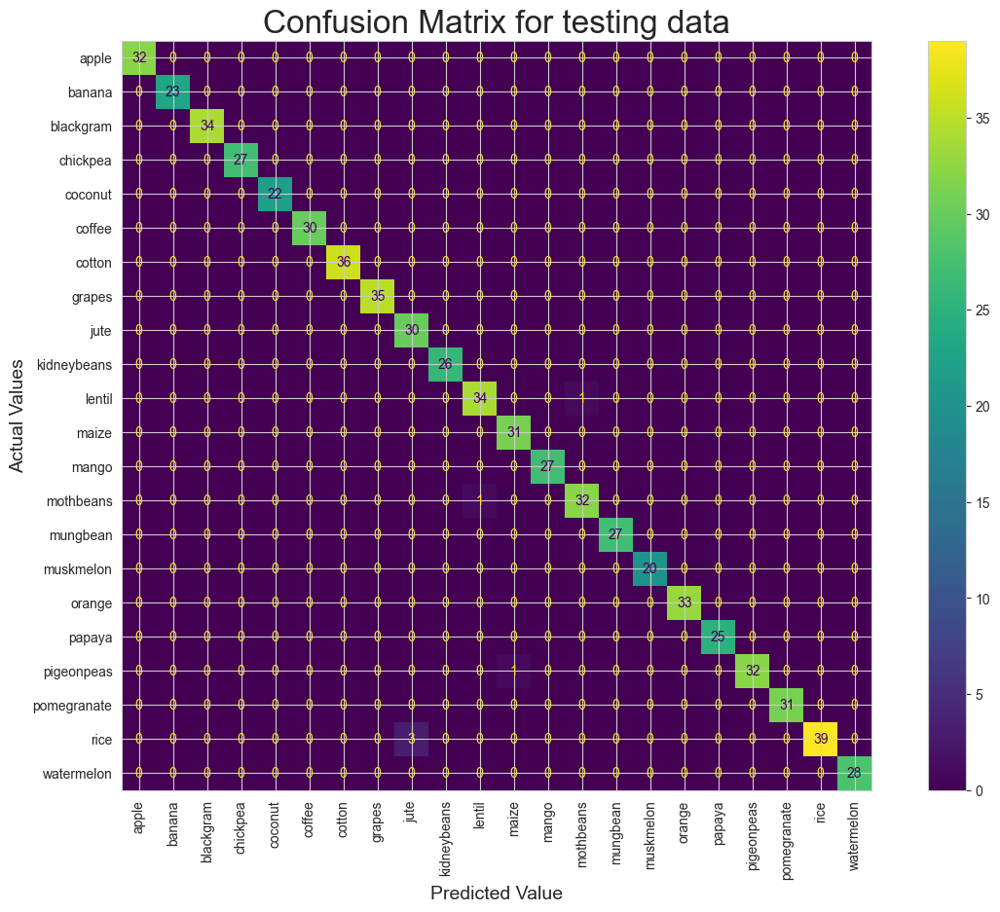

In [293]:
# Accuracy on Test Data
catnb_accuracy = accuracy_score(y1_test, catnb_test)
print("Accuracy on Test Data: {:.2f} %".format(catnb_accuracy * 100))

# Precision on Testing Dataset
catnb_precision = precision_score(y1_test, catnb_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(catnb_precision * 100))

# Recall on Testing Dataset
catnb_recall = recall_score(y1_test, catnb_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(catnb_recall * 100))

# F1 score
catnb_f1 = f1_score(y1_test, catnb_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(catnb_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y1_test, catnb_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in catnb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 7. GAUSSIAN NAIVE BAYES

In [294]:
from sklearn.naive_bayes import GaussianNB

# Create a Gaussian Naive Bayes classifier
gnb = GaussianNB()
gnb.fit(X_train, y_train)

GaussianNB()

In [295]:
gnb_train = gnb.predict(X_train)
gnb_test = gnb.predict(X_test)

Accuracy on Training Data : 99.42 %
Precision on Training Data (Macro average): 99.39 %
Recall on Training Data (Macro average): 99.38 %
F1 score on Training Data (Macro average): 99.39 %


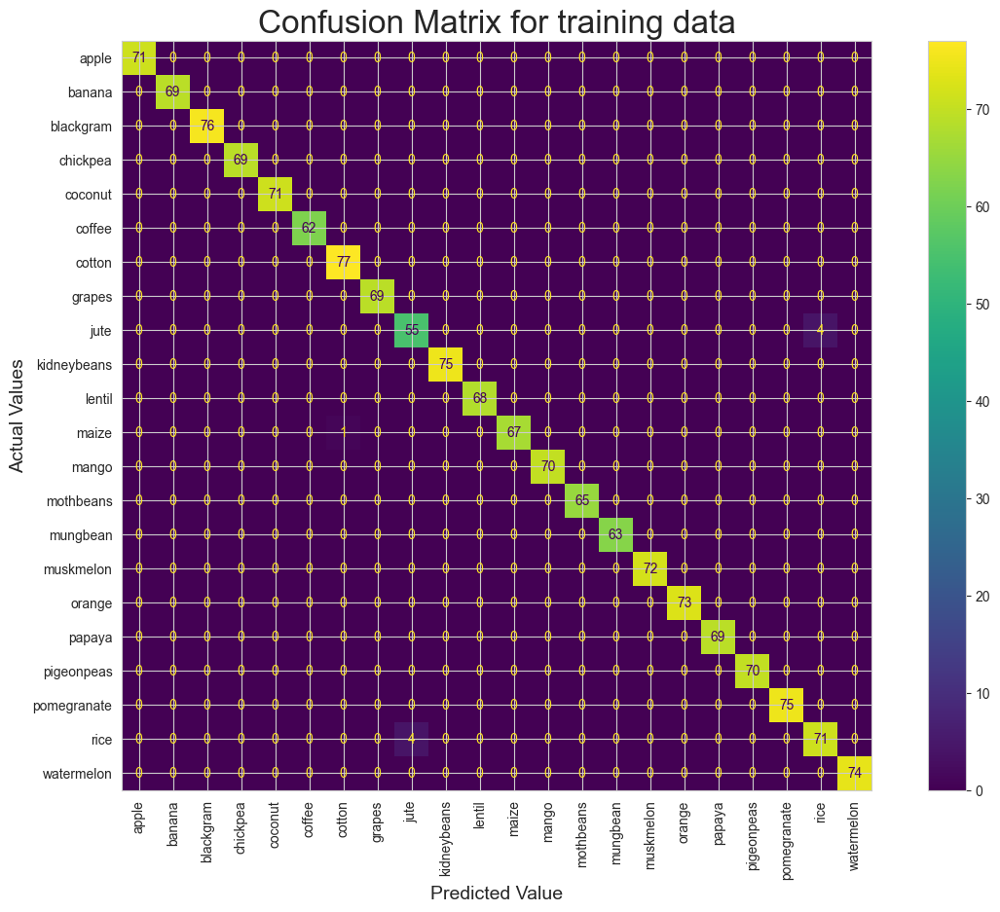

In [296]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, gnb_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, gnb_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, gnb_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,gnb_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, gnb_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in gnb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.39 %
Precision on Test Data (Macro Average): 99.49 %
Recall on Test Data (Macro Average): 99.34 %
F1 score on Test Data (Macro Average): 99.40 %


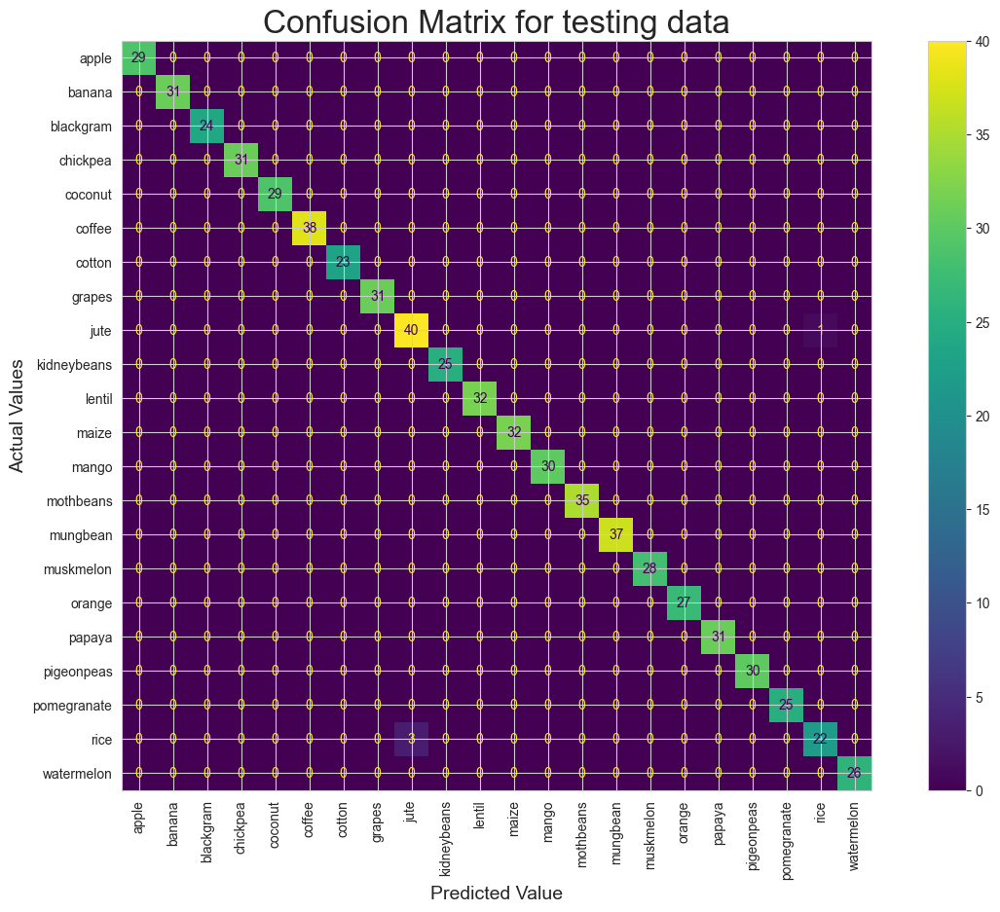

In [297]:
# Accuracy on Test Data
gnb_accuracy = accuracy_score(y_test, gnb_test)
print("Accuracy on Test Data: {:.2f} %".format(gnb_accuracy * 100))

# Precision on Testing Dataset
gnb_precision = precision_score(y_test, gnb_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(gnb_precision * 100))

# Recall on Testing Dataset
gnb_recall = recall_score(y_test, gnb_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(gnb_recall * 100))

# F1 score
gnb_f1 = f1_score(y_test, gnb_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(gnb_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, gnb_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in gnb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

#### 8. EXTREME GRADIENT BOOSTING (XGBoost)

In [298]:
# Import Library
import xgboost
from xgboost import XGBClassifier

xgb = XGBClassifier(random_state = 18)
xgb.fit(X_train, y_train) # Fit Data

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

Accuracy on Train Data: 100.0%
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00 %


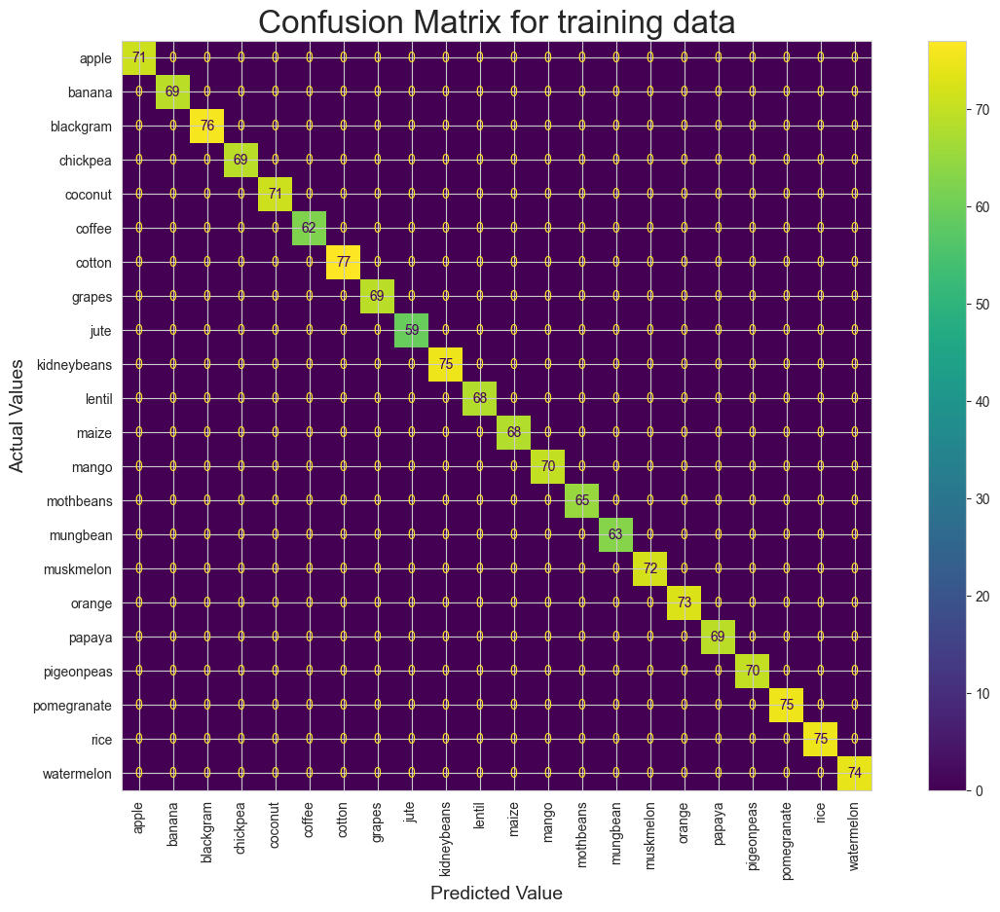

In [299]:
# Accuray On Test Data
xgb_predict_train = xgb.predict(X_train)
xgb_accuracy_train = accuracy_score( y_train, xgb_predict_train )
print(f"Accuracy on Train Data: {xgb_accuracy_train * 100}%")
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, xgb_predict_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, xgb_predict_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,xgb_predict_train, average = "macro")*100))

# Visualising Confusion Matrix
cm = confusion_matrix(y_train, xgb_predict_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in xgb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 98.48 %
Precision on Test Data (Macro Average): 98.75 %
Recall on Test Data (Macro Average): 98.40 %
F1 score on Test Data (Macro Average): 98.52 %


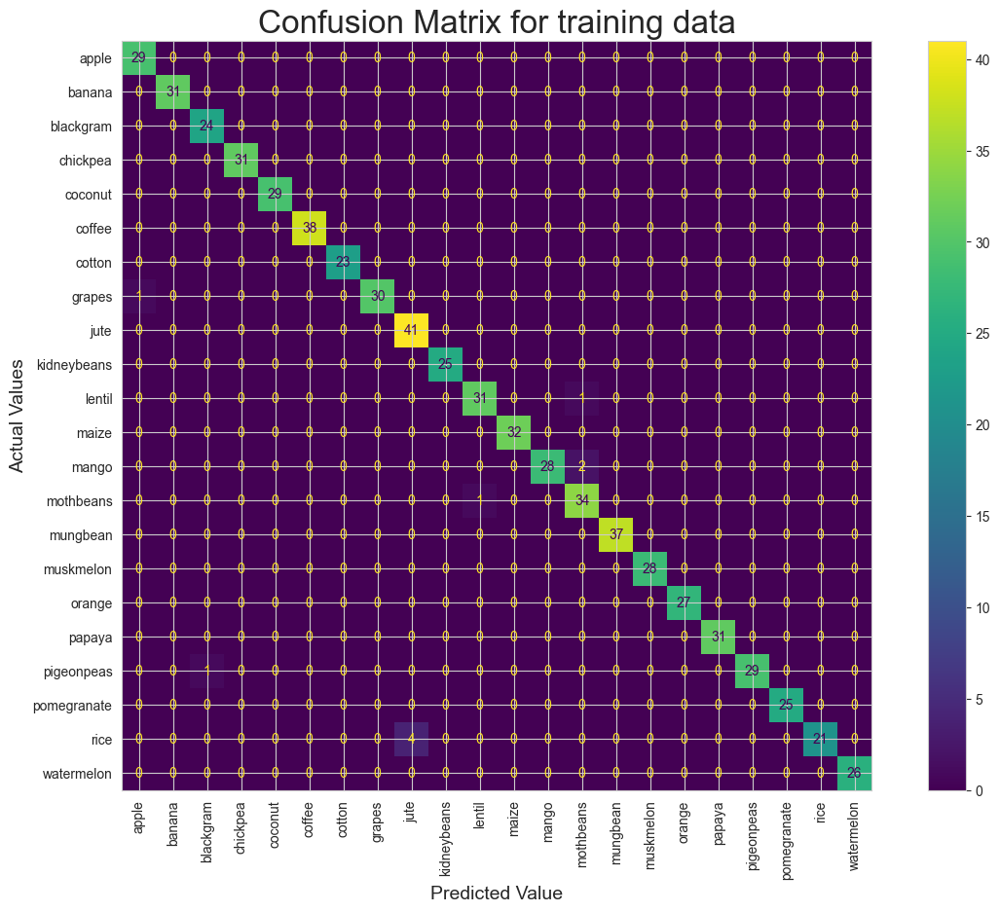

In [300]:
# Accuray On Test Data
xgb_predict_test = xgb.predict(X_test)
xgb_accuracy = accuracy_score(y_test, xgb_predict_test)

print("Accuracy on Test Data: {:.2f} %".format(xgb_accuracy * 100))

# Precision on Testing Dataset
xgb_precision = precision_score(y_test, xgb_predict_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(xgb_precision * 100))

# Recall on Testing Dataset
xgb_recall = recall_score(y_test, xgb_predict_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(xgb_recall * 100))

# F1 score
xgb_f1 = f1_score(y_test, xgb_predict_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(xgb_f1 * 100))


# Visualising Confusion Matrix
cm = confusion_matrix(y_test, xgb_predict_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in xgb.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()


#### 9. BAGGING CLASSIFIER

In [301]:
from sklearn.ensemble import BaggingClassifier

In [302]:
base_estimator = [DecisionTreeClassifier(), RandomForestClassifier(), LogisticRegression(), KNeighborsClassifier(), SVC(), GaussianNB(), XGBClassifier()]
max_samples = [0.2,0.25,0.3,0.5,0.7,0.75,0.8,1]

param_grid = {'base_estimator': base_estimator,
               'max_samples': max_samples
             }

bag = BaggingClassifier()

from sklearn.model_selection import GridSearchCV
bag_grid = GridSearchCV(estimator = bag, 
                       param_grid = param_grid, 
                       cv = 10,
                       verbose = 2,
                       n_jobs = -1)

bag_grid.fit(X_train,y_train)

Fitting 10 folds for each of 56 candidates, totalling 560 fits


GridSearchCV(cv=10, estimator=BaggingClassifier(), n_jobs=-1,
             param_grid={'base_estimator': [DecisionTreeClassifier(),
                                            RandomForestClassifier(),
                                            LogisticRegression(),
                                            KNeighborsClassifier(), SVC(),
                                            GaussianNB(),
                                            XGBClassifier(base_score=None,
                                                          booster=None,
                                                          callbacks=None,
                                                          colsample_bylevel=None,
                                                          colsample_bynode=None,
                                                          colsample_bytree=None,
                                                          device=None,
                                                          early_stopp...
                                                          interaction_constraints=None,
                                                          learning_rate=None,
                                                          max_bin=None,
                                                          max_cat_threshold=None,
                                                          max_cat_to_onehot=None,
                                                          max_delta_step=None,
                                                          max_depth=None,
                                                          max_leaves=None,
                                                          min_child_weight=None,
                                                          missing=nan,
                                                          monotone_constraints=None,
                                                          multi_strategy=None,
                                                          n_estimators=None,
                                                          n_jobs=None,
                                                          num_parallel_tree=None,
                                                          random_state=None, ...)],
                         'max_samples': [0.2, 0.25, 0.3, 0.5, 0.7, 0.75, 0.8,
                                         1]},
             verbose=2)

In [303]:
bag_grid.best_params_

{'base_estimator': GaussianNB(), 'max_samples': 0.25}

In [304]:
bag_grid.best_score_

0.9941558441558443

In [305]:
bag = BaggingClassifier(
    base_estimator=GaussianNB(),
    n_estimators=100,
    max_samples=0.25,
    bootstrap=True,
    random_state=42
)

In [306]:
bag.fit(X_train,y_train)

BaggingClassifier(base_estimator=GaussianNB(), max_samples=0.25,
                  n_estimators=100, random_state=42)

In [307]:
bag_train = bag.predict(X_train)
bag_test = bag.predict(X_test)

Accuracy on Training Data : 99.55 %
Precision on Training Data (Macro average): 99.52 %
Recall on Training Data (Macro average): 99.54 %
F1 score on Training Data (Macro average): 99.53 %


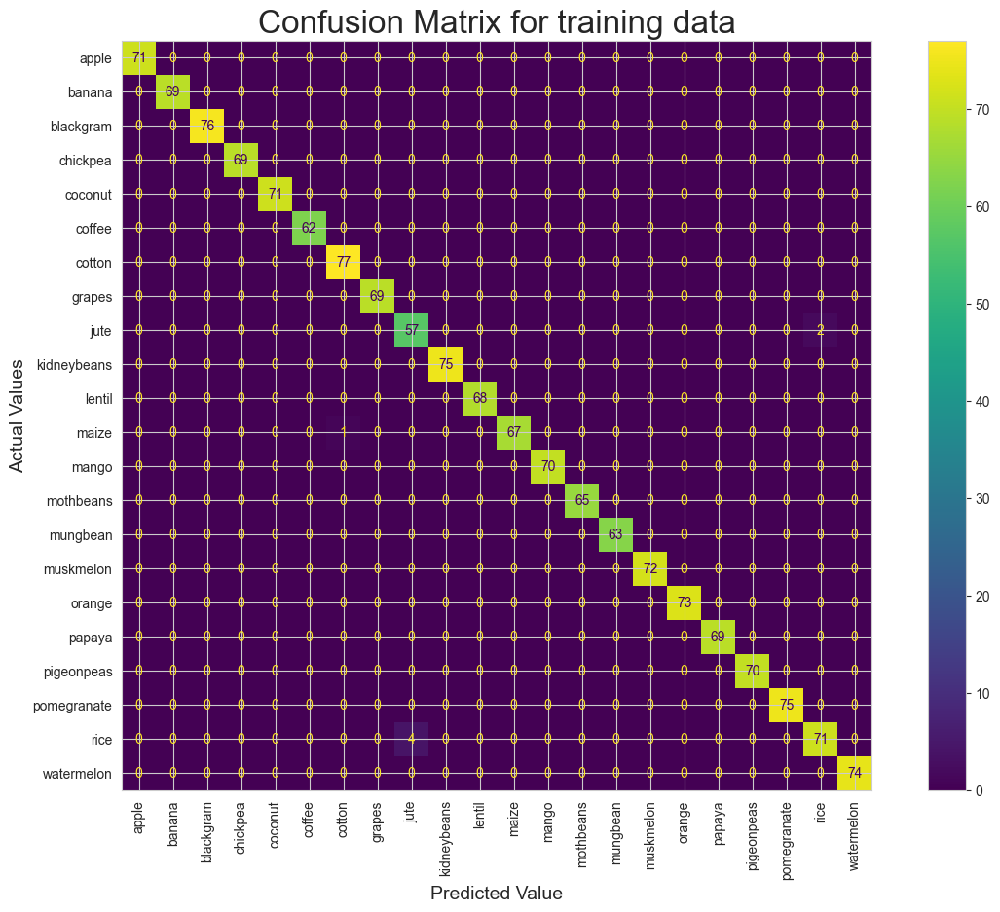

In [308]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, bag_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, bag_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, bag_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,bag_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, bag_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in bag.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.39 %
Precision on Test Data (Macro Average): 99.57 %
Recall on Test Data (Macro Average): 99.34 %
F1 score on Test Data (Macro Average): 99.43 %


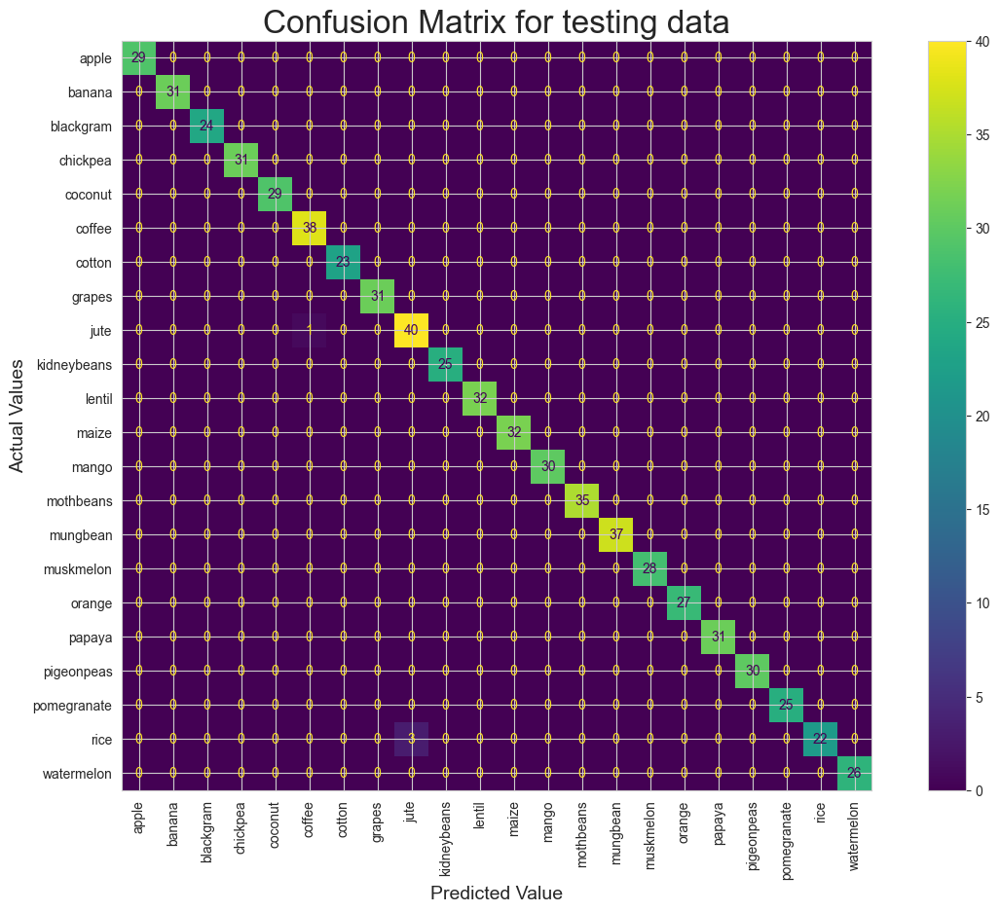

In [309]:
# Accuracy on Test Data
bag_accuracy = accuracy_score(y_test, bag_test)
print("Accuracy on Test Data: {:.2f} %".format(bag_accuracy * 100))

# Precision on Testing Dataset
bag_precision = precision_score(y_test, bag_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(bag_precision * 100))

# Recall on Testing Dataset
bag_recall = recall_score(y_test, bag_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(bag_recall * 100))

# F1 score
bag_f1 = f1_score(y_test, bag_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(bag_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, bag_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in bag.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

### 9. VOTING CLASSIFIER

In [203]:
from sklearn.ensemble import VotingClassifier

In [320]:
n = 5

# Creating a list to hold the Random Forest classifiers
random_forest_classifiers = []

# Creating 'n' different Random Forest classifiers
for i in range(n):
    random_forest = RandomForestClassifier(n_estimators=100, random_state=i, max_depth = None)  
    random_forest_classifiers.append(('rf{}'.format(i), random_forest))

# Create a Voting Classifier with 'hard' voting (majority rule)
vc = VotingClassifier(estimators=random_forest_classifiers, voting='soft')

In [321]:
vc.fit(X_train,y_train)

VotingClassifier(estimators=[('rf0', RandomForestClassifier(random_state=0)),
                             ('rf1', RandomForestClassifier(random_state=1)),
                             ('rf2', RandomForestClassifier(random_state=2)),
                             ('rf3', RandomForestClassifier(random_state=3)),
                             ('rf4', RandomForestClassifier(random_state=4))],
                 voting='soft')

In [322]:
vc_train = vc.predict(X_train)
vc_test = vc.predict(X_test)

In [ ]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, vc_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, vc_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, vc_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,vc_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, vc_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in vc.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Training Data : 100.00 %
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00 %


Accuracy on Test Data: 99.70 %
Precision on Test Data (Macro Average): 99.73 %
Recall on Test Data (Macro Average): 99.60 %
F1 score on Test Data (Macro Average): 99.66 %


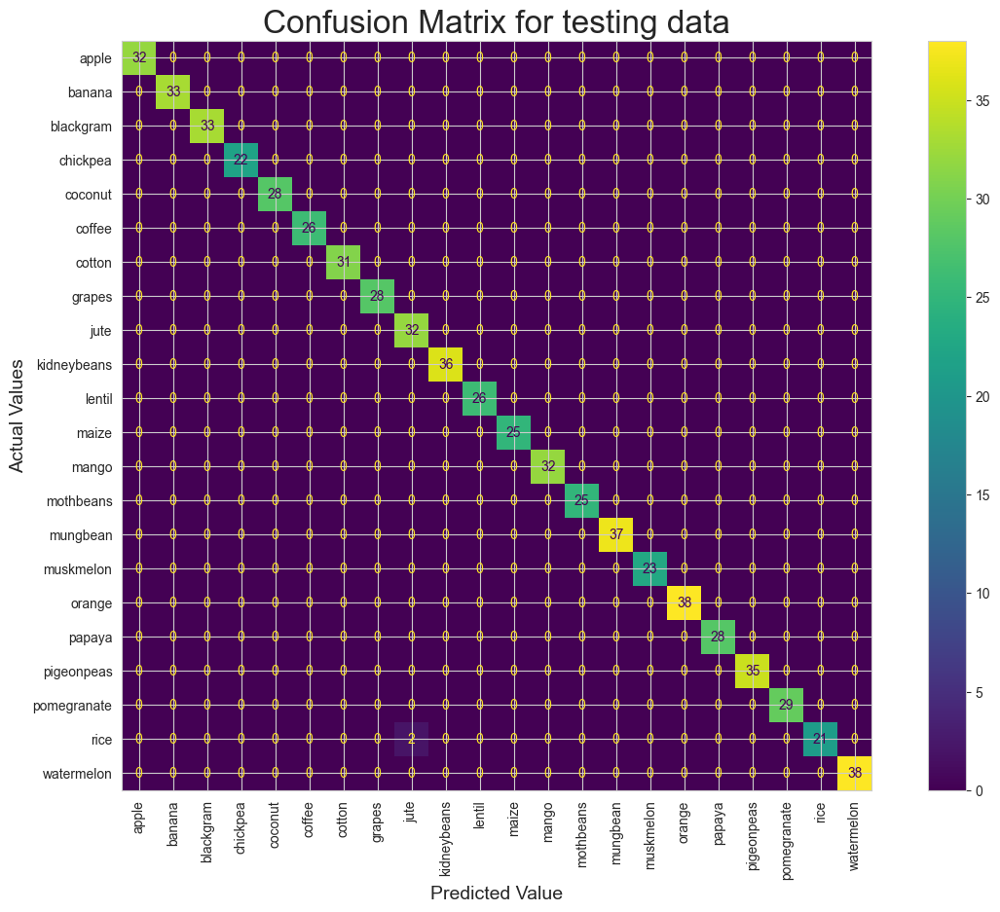

In [218]:
# Accuracy on Test Data
vc_accuracy = accuracy_score(y_test, vc_test)
print("Accuracy on Test Data: {:.2f} %".format(vc_accuracy * 100))

# Precision on Testing Dataset
vc_precision = precision_score(y_test, vc_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(vc_precision * 100))

# Recall on Testing Dataset
vc_recall = recall_score(y_test, vc_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(vc_recall * 100))

# F1 score
vc_f1 = f1_score(y_test, vc_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(vc_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, vc_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in vc.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

### 10. STACKING CLASSIFIER

In [192]:
from sklearn.ensemble import StackingClassifier

# Creating a list to hold the Random Forest classifiers
random_forest_classifiers = []
n = 5
# Creating 'n' different Random Forest classifiers
for i in range(n):
    random_forest = RandomForestClassifier(n_estimators=25*(i+1), random_state=20*(i+1), max_depth = None)  
    random_forest_classifiers.append(('rf{}'.format(i), random_forest))

# Creating a StackingClassifier
stack = StackingClassifier(
    estimators=random_forest_classifiers, 
    final_estimator=vc,
    passthrough=True,
    cv=15
)


In [193]:
stack.fit(X_train, y_train)


StackingClassifier(cv=15,
                   estimators=[('rf0',
                                RandomForestClassifier(n_estimators=25,
                                                       random_state=20)),
                               ('rf1',
                                RandomForestClassifier(n_estimators=50,
                                                       random_state=40)),
                               ('rf2',
                                RandomForestClassifier(n_estimators=75,
                                                       random_state=60)),
                               ('rf3', RandomForestClassifier(random_state=80)),
                               ('rf4',
                                RandomForestClassifier(n_estimators=125,
                                                       random_state=100))],
                   final_estimator=VotingClassifier(estimators=[('rf0',
                                                                 RandomForestClassifier(random_state=0)),
                                                                ('rf1',
                                                                 RandomForestClassifier(random_state=1)),
                                                                ('rf2',
                                                                 RandomForestClassifier(random_state=2)),
                                                                ('rf3',
                                                                 RandomForestClassifier(random_state=3)),
                                                                ('rf4',
                                                                 RandomForestClassifier(random_state=4))]),
                   passthrough=True)

In [194]:
stack_train = stack.predict(X_train)
stack_test = stack.predict(X_test)

Accuracy on Training Data : 100.00 %
Precision on Training Data (Macro average): 100.00 %
Recall on Training Data (Macro average): 100.00 %
F1 score on Training Data (Macro average): 100.00 %


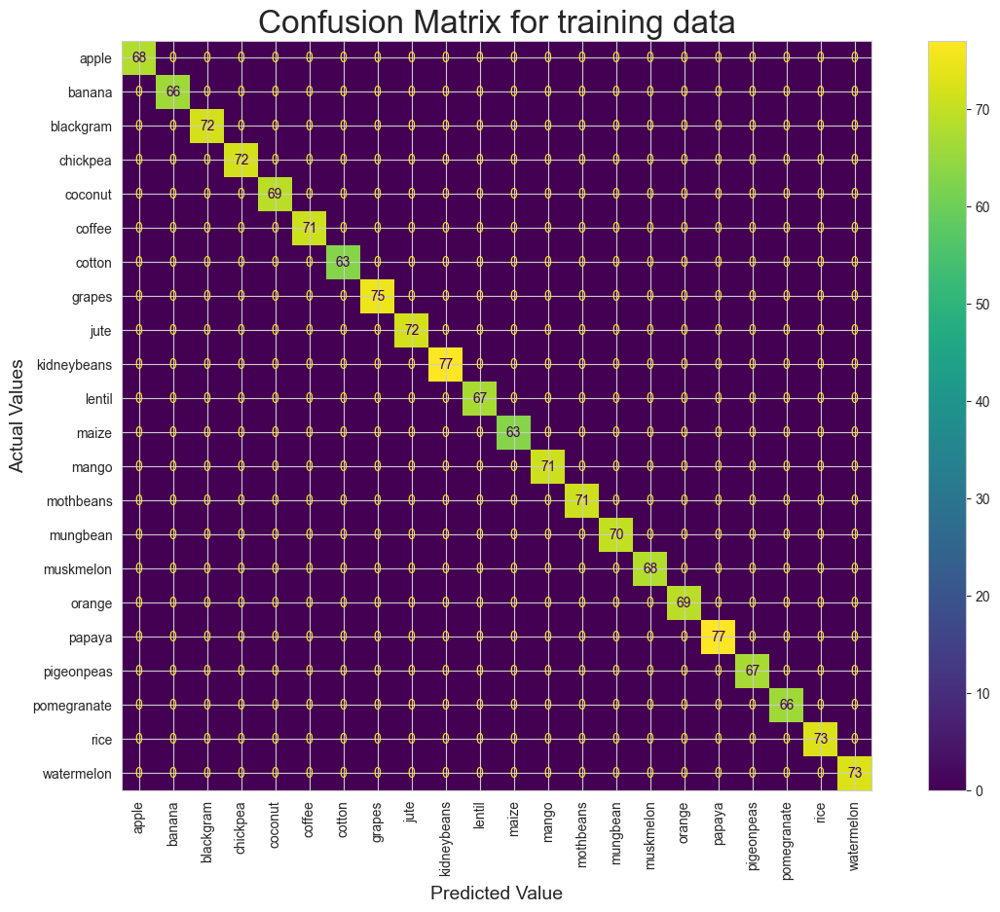

In [195]:
# Accuracy of Training Data
print("Accuracy on Training Data : {:.2f} %".format(accuracy_score( y_train, stack_train) * 100) )
print("Precision on Training Data (Macro average): {:.2f} %".format(precision_score( y_train, stack_train, average = "macro") * 100) )
print("Recall on Training Data (Macro average): {:.2f} %".format(recall_score( y_train, stack_train, average = "macro") * 100) )
print("F1 score on Training Data (Macro average): {:.2f} %".format(f1_score(y_train,stack_train, average = "macro")*100))
# Visualising Confusion Matrix
cm = confusion_matrix(y_train, stack_train)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in stack.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for training data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

Accuracy on Test Data: 99.85 %
Precision on Test Data (Macro Average): 99.84 %
Recall on Test Data (Macro Average): 99.83 %
F1 score on Test Data (Macro Average): 99.83 %


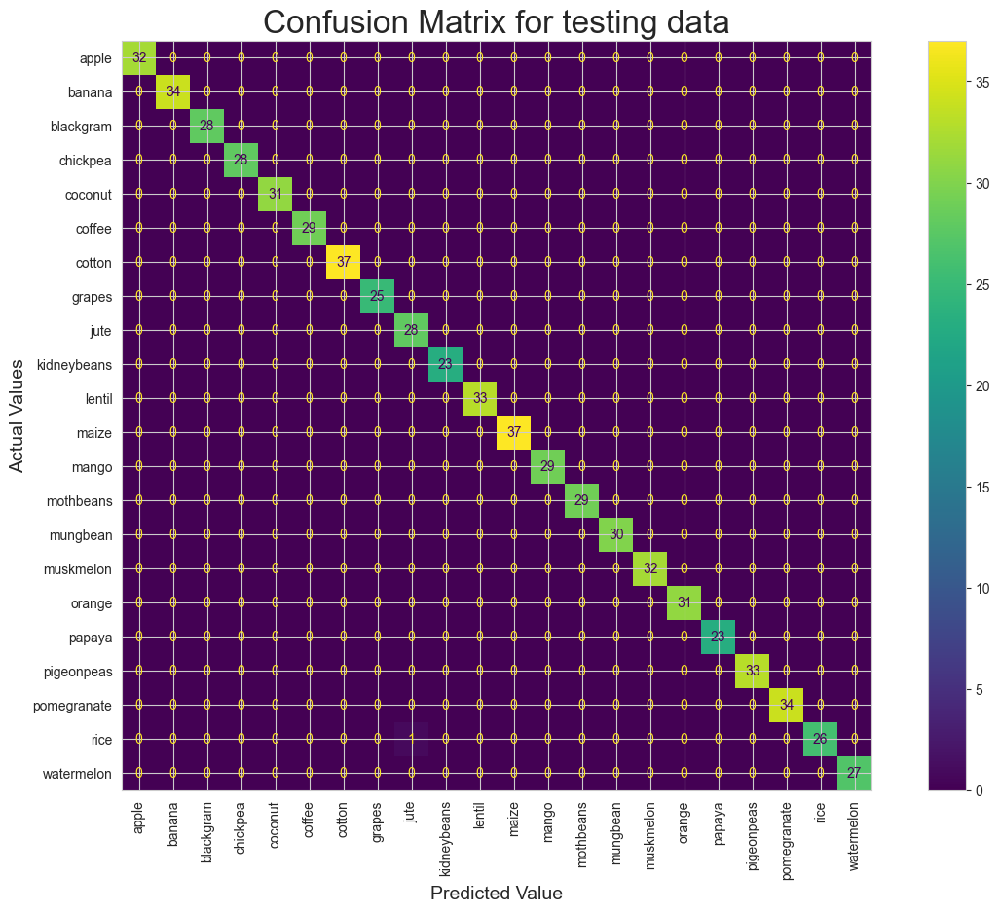

In [196]:
# Accuracy on Test Data
stack_accuracy = accuracy_score(y_test, stack_test)
print("Accuracy on Test Data: {:.2f} %".format(stack_accuracy * 100))

# Precision on Testing Dataset
stack_precision = precision_score(y_test, stack_test, average="macro")
print("Precision on Test Data (Macro Average): {:.2f} %".format(stack_precision * 100))

# Recall on Testing Dataset
stack_recall = recall_score(y_test, stack_test, average="macro")
print("Recall on Test Data (Macro Average): {:.2f} %".format(stack_recall * 100))

# F1 score
stack_f1 = f1_score(y_test, stack_test, average="macro")
print("F1 score on Test Data (Macro Average): {:.2f} %".format(stack_f1 * 100))


# Confusion Matrix
cm = confusion_matrix(y_test, stack_test)
disp = ConfusionMatrixDisplay( confusion_matrix = cm, display_labels = [labelencoder.classes_[i] for i in stack.classes_] )
fig, ax = plt.subplots( figsize = (15,10) )
disp.plot(ax = ax)
plt.title("Confusion Matrix for testing data", fontsize=24)
plt.xlabel("Predicted Value", fontsize=14)
plt.ylabel("Actual Values", fontsize=14)
plt.xticks(rotation=90)
plt.show()

### STORING ALL METRICS IN RESPECTIVE LISTS

In [310]:
accuracy = []
precision = []
recall = []
F1 = []
model_name = ["DECISION TREE","RANDOM FOREST","LOGISTIC REGRESSION","SUPPORT VECTOR MACHINE","K-NEAREST NEIGHBOUR","CATEGORICAL NAIVE BAYES","GAUSSIAN NAIVE BAYES","XGBOOST","BAGGING CLASSIFIER","VOTING CLASSIFIER","STACKING CLASSIFIER"]
list1 = [decision_accuracy_test,random_accuracy,softmax_accuracy,svm_accuracy,knn_accuracy,catnb_accuracy,gnb_accuracy,xgb_accuracy,bag_accuracy,vc_accuracy,stack_accuracy]
list2 = [decision_precision,random_precision,softmax_precision,svm_precision,knn_precision,catnb_precision,gnb_precision,xgb_precision,bag_precision,vc_precision,stack_precision]
list3 = [decision_recall,random_recall,softmax_recall,svm_recall,knn_recall,catnb_recall,gnb_recall,xgb_recall,bag_recall,vc_recall,stack_recall]
list4 = [decision_f1,random_f1,softmax_f1,svm_f1,knn_f1,catnb_f1,gnb_f1,xgb_f1,bag_f1,vc_f1,stack_f1]

for i in list1:
    accuracy.append("{:.2f}".format(i * 100))
for i in list2:
    precision.append("{:.2f}".format(i * 100))
for i in list3:
    recall.append("{:.2f}".format(i * 100))
for i in list4:
    F1.append("{:.2f}".format(i * 100))



### COMPARISON BETWEEN ALL THE ALGORITHMS 

In [311]:
dftable = pd.DataFrame(columns=['ACCURACY', 'PRECISION','RECALL','F1-SCORE','MODEL'])
dftable['ACCURACY'] = accuracy
dftable['MODEL'] = model_name
dftable['PRECISION'] = precision
dftable['RECALL'] = recall
dftable['F1-SCORE'] = F1
dftable = dftable[['MODEL', 'ACCURACY','PRECISION','RECALL','F1-SCORE']]
dftable

,MODEL,ACCURACY,PRECISION,RECALL,F1-SCORE
0,DECISION TREE,97.12,97.28,97.49,97.25
1,RANDOM FOREST,99.55,99.67,99.53,99.59
2,LOGISTIC REGRESSION,98.03,98.18,98.09,98.12
3,SUPPORT VECTOR MACHINE,98.33,98.35,98.40,98.34
4,K-NEAREST NEIGHBOUR,97.73,97.73,97.85,97.70
5,CATEGORICAL NAIVE BAYES,99.09,99.18,99.27,99.21
6,GAUSSIAN NAIVE BAYES,99.39,99.49,99.34,99.40
7,XGBOOST,98.48,98.75,98.40,98.52
8,BAGGING CLASSIFIER,99.39,99.57,99.34,99.43
9,VOTING CLASSIFIER,99.70,99.73,99.60,99.66


In [312]:
model = ["DECISION TREE","RANDOM FOREST","LOGISTIC REGRESSION","SUPPORT VECTOR MACHINE","K-NEAREST NEIGHBOUR","CATEGORICAL NAIVE BAYES","GAUSSIAN NAIVE BAYES","XGBOOST","BAGGING CLASSIFIER","VOTING CLASSIFIER","STACKING CLASSIFIER"]
accuracy = [97.12,99.55,98.03,98.33,97.73,99.09,99.39,98.48,99.39,99.70,99.85]
precision = [97.28,99.67,98.18,98.35,97.73,99.18,99.49,98.75,99.57,99.73,99.84]
recall = [97.49,99.53,98.09,98.40,97.85,99.27,99.34,98.40,99.34,99.60,99.83]
F1 = [97.25,99.59,98.12,98.34,97.70,99.21,99.40,98.52,99.43,99.66,99.83]

### VISUALISING THE RELATIONSHIP OF THE ALGORITHMS WITH ACCURACY, PRECISION AND RECALL VALUES

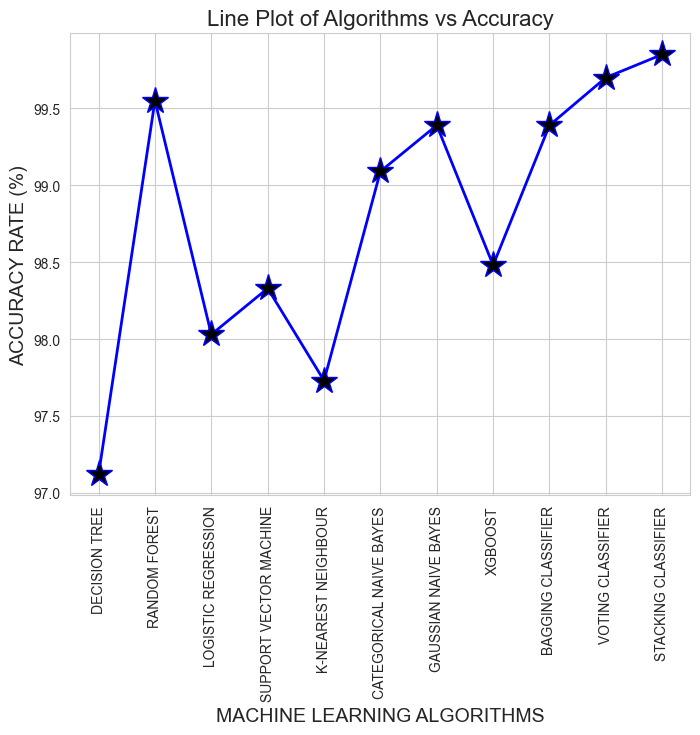

In [313]:
plt.figure(figsize=(8, 6))
sns.set_style('whitegrid')
plt.plot(model, accuracy, color='blue', linewidth=2,marker = '*', ms = 20,mfc = 'black')
plt.grid(True)
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14, fontname='Arial')
plt.ylabel('ACCURACY RATE (%)', fontsize=14, fontname='Arial')
plt.title('Line Plot of Algorithms vs Accuracy', fontsize=16)
plt.xticks(rotation=90)
plt.show()


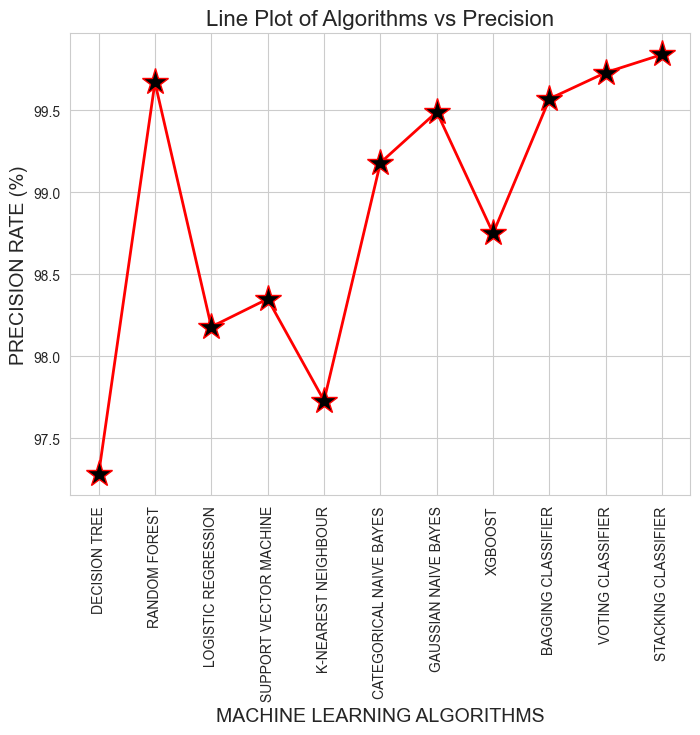

In [314]:
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.plot(model,precision, color='r', linewidth=2,marker = '*', ms = 20,mfc = 'black')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('PRECISION RATE (%)', fontsize=14)
plt.title('Line Plot of Algorithms vs Precision', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()

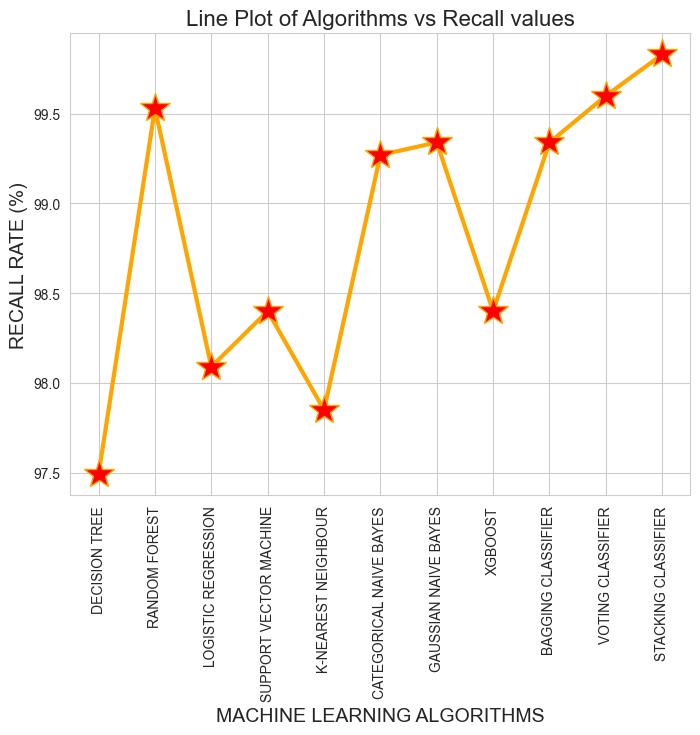

In [319]:
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.plot(model,recall, color='orange',linewidth=3,marker = '*', ms = 22,mfc = 'red')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('RECALL RATE (%)', fontsize=14)
plt.title('Line Plot of Algorithms vs Recall values', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()

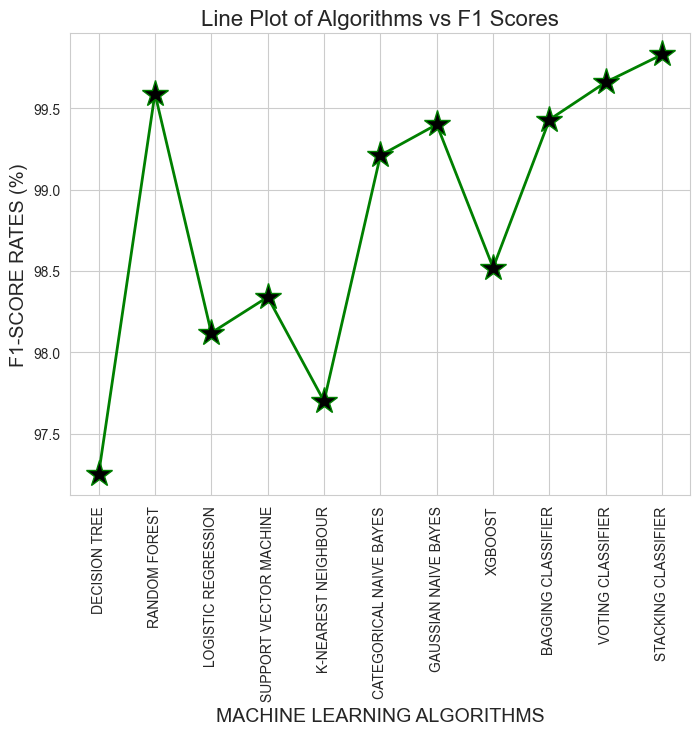

In [316]:
plt.figure(figsize=(8, 6))
ax = sns.set_style('whitegrid')
plt.plot(model,F1, color='green',linewidth=2,marker = '*', ms = 20,mfc = 'black')
plt.xlabel('MACHINE LEARNING ALGORITHMS', fontsize=14)
plt.ylabel('F1-SCORE RATES (%)', fontsize=14)
plt.title('Line Plot of Algorithms vs F1 Scores', fontsize=16)

# Rotate x-axis labels for better readability
plt.xticks(rotation=90)

plt.show()